In [1]:
%matplotlib notebook
import numpy as np
import pandas as pd 
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm

# Importing training and testing subsets

In [3]:
train_scores=pd.read_pickle("train_scores.pkl")
train_labels=pd.read_pickle("train_labels.pkl")
test_scores=pd.read_pickle("test_scores.pkl")
test_labels=pd.read_pickle("test_labels.pkl")

# Plotting Data

In [4]:
MIMIC_A_labels_train = [index for index in train_labels.index if(train_labels.loc[index]["Label"]=="A") and index[:5]=="MIMIC"]
MIMIC_B_labels_train = [index for index in train_labels.index if(train_labels.loc[index]["Label"]=="B") and index[:5]=="MIMIC"]
MIMIC_C_labels_train = [index for index in train_labels.index if(train_labels.loc[index]["Label"]=="C") and index[:5]=="MIMIC"]

Vietnam_A_labels_train = [index for index in train_labels.index if(train_labels.loc[index]["Label"]=="A") and index[:7]=="Vietnam"]
Vietnam_B_labels_train = [index for index in train_labels.index if(train_labels.loc[index]["Label"]=="B") and index[:7]=="Vietnam"]
Vietnam_C_labels_train = [index for index in train_labels.index if(train_labels.loc[index]["Label"]=="C") and index[:7]=="Vietnam"]

AFE_A_labels_train = [index for index in train_labels.index if(train_labels.loc[index]["Label"]=="A") and index[:3]=="AFE"]
AFE_B_labels_train = [index for index in train_labels.index if(train_labels.loc[index]["Label"]=="B") and index[:3]=="AFE"]
AFE_C_labels_train = [index for index in train_labels.index if(train_labels.loc[index]["Label"]=="C") and index[:3]=="AFE"]


In [5]:
MIMIC_A_Scores_train= train_scores.loc[MIMIC_A_labels_train]
MIMIC_B_Scores_train= train_scores.loc[MIMIC_B_labels_train]
MIMIC_C_Scores_train= train_scores.loc[MIMIC_C_labels_train]

Vietnam_A_Scores_train= train_scores.loc[Vietnam_A_labels_train]
Vietnam_B_Scores_train= train_scores.loc[Vietnam_B_labels_train]
Vietnam_C_Scores_train= train_scores.loc[Vietnam_C_labels_train]

AFE_A_Scores_train= train_scores.loc[AFE_A_labels_train]
AFE_B_Scores_train= train_scores.loc[AFE_B_labels_train]
AFE_C_Scores_train= train_scores.loc[AFE_C_labels_train]

<IPython.core.display.Javascript object>


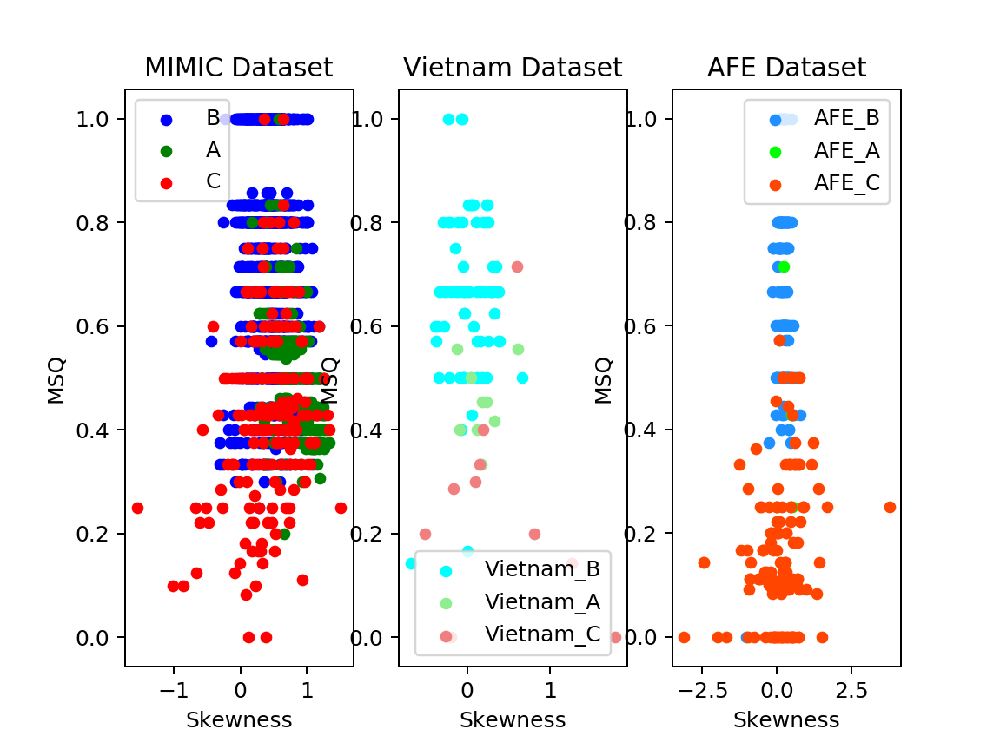

In [7]:
x="Skewness"
y="MSQ"

fig, (ax1, ax2, ax3) = plt.subplots(1, 3)
ax1.title.set_text('MIMIC Dataset')


MIMIC_B_Scores_train.plot.scatter(x=x,y=y,color="blue",label="B",ax=ax1)
MIMIC_A_Scores_train.plot.scatter(x=x,y=y,color="green",label="A",ax=ax1)
MIMIC_C_Scores_train.plot.scatter(x=x,y=y,color="red",label="C",ax=ax1)

# ax.set_xlim(All_Scores[x].min()-0.25,All_Scores[x].max()+0.25)
# ax.set_ylim(All_Scores[y].min()-0.25,All_Scores[y].max()+0.25)
# plt.title("3 Seperate Classes MIMIC")
ax1.set_xlabel(x)
ax1.set_ylabel(y)


ax2.title.set_text('Vietnam Dataset')

Vietnam_B_Scores_train.plot.scatter(x=x,y=y,color="aqua",label="Vietnam_B",ax=ax2)
Vietnam_A_Scores_train.plot.scatter(x=x,y=y,color="lightgreen",label="Vietnam_A",ax=ax2)
Vietnam_C_Scores_train.plot.scatter(x=x,y=y,color="lightcoral",label="Vietnam_C",ax=ax2)

# ax2.set_xlim(All_Scores[x].min()-0.25,All_Scores[x].max()+0.25)
# ax2.set_ylim(All_Scores[y].min()-0.25,All_Scores[y].max()+0.25)
plt.title("3 Seperate Classes")
plt.xlabel(x)
plt.ylabel(y)

ax3.title.set_text('AFE Dataset')

AFE_B_Scores_train.plot.scatter(x=x,y=y,color="dodgerblue",label="AFE_B",ax=ax3)
AFE_A_Scores_train.plot.scatter(x=x,y=y,color="lime",label="AFE_A",ax=ax3)
AFE_C_Scores_train.plot.scatter(x=x,y=y,color="orangered",label="AFE_C",ax=ax3)

plt.xlabel(x)
plt.ylabel(y)
plt.legend()

plt.show()

<IPython.core.display.Javascript object>


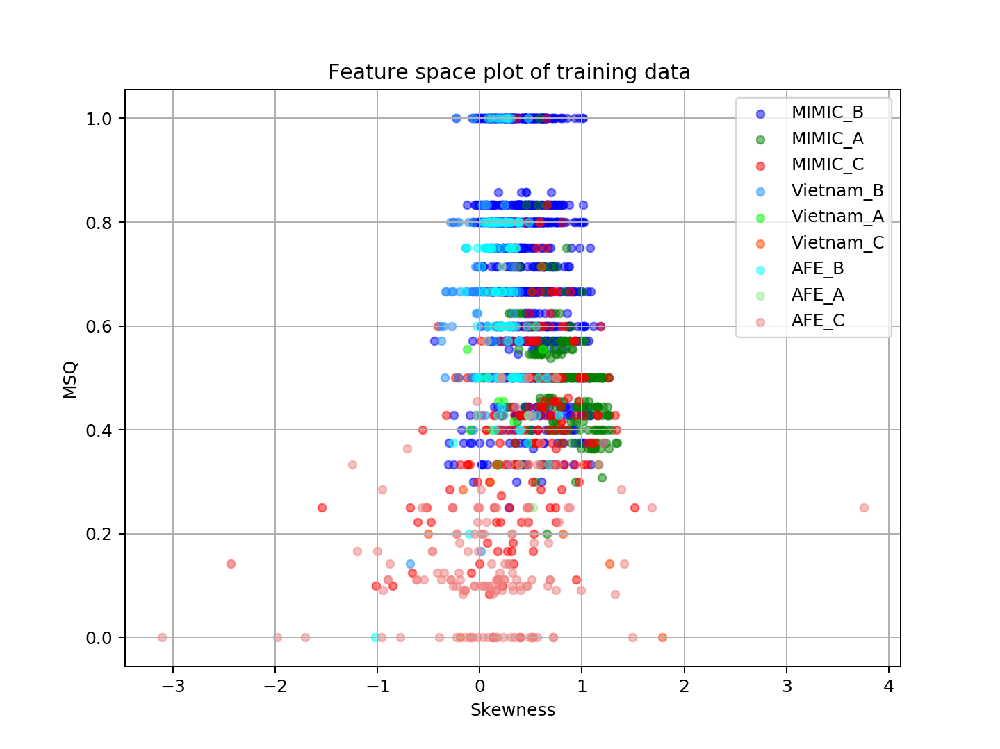

In [8]:
x="Skewness"
y="MSQ"
alpha=0.5

ax=MIMIC_B_Scores_train.plot.scatter(x=x,y=y,color="blue",alpha=alpha,label="MIMIC_B",figsize=(8,6))
MIMIC_A_Scores_train.plot.scatter(x=x,y=y,color="green",alpha=alpha,label="MIMIC_A",ax=ax)
ax=MIMIC_C_Scores_train.plot.scatter(x=x,y=y,color="red",alpha=alpha,label="MIMIC_C",ax=ax)

Vietnam_B_Scores_train.plot.scatter(x=x,y=y,color="dodgerblue",alpha=alpha,label="Vietnam_B",ax=ax)
Vietnam_A_Scores_train.plot.scatter(x=x,y=y,color="lime",alpha=alpha,label="Vietnam_A",ax=ax)
Vietnam_C_Scores_train.plot.scatter(x=x,y=y,color="orangered",alpha=alpha,label="Vietnam_C",ax=ax)

AFE_B_Scores_train.plot.scatter(x=x,y=y,color="aqua",alpha=alpha,label="AFE_B",ax=ax)
AFE_A_Scores_train.plot.scatter(x=x,y=y,color="lightgreen",alpha=alpha,label="AFE_A",ax=ax)
AFE_C_Scores_train.plot.scatter(x=x,y=y,color="lightcoral",alpha=alpha,label="AFE_C",ax=ax)

plt.title("Feature space plot of training data ")
plt.xlabel(x)
plt.ylabel(y)
plt.legend()
plt.grid()
plt.show()

# Testing Different Three-Class Classifiers:

## SVM Classifier

In [192]:
from sklearn.model_selection import cross_val_score

### Functions required:

In [97]:
def make_meshgrid(x, y, h=.02):
    """Create a mesh of points to plot in

    Parameters
    ----------
    x: data to base x-axis meshgrid on
    y: data to base y-axis meshgrid on
    h: stepsize for meshgrid, optional

    Returns
    -------
    xx, yy : ndarray
    """
    x_min, x_max = x.min()-0.1, x.max()+0.1 
    y_min, y_max = y.min()-0.1, y.max()+0.1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))
    return xx, yy

def plot_contours(ax, clf, xx, yy, **params):
    """Plot the decision boundaries for a classifier.

    Parameters
    ----------
    ax: matplotlib axes object
    clf: a classifier
    xx: meshgrid ndarray
    yy: meshgrid ndarray
    params: dictionary of params to pass to contourf, optional
    """
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    out = ax.contourf(xx, yy, Z, **params)
    return out

## 3 Classes 

In [3607]:
train_scores

,Skewness,Kurtosis,Entropy,Zeros,MSQ,SNR,Relative_Power,mean_Skewness,mean_Kurtosis,mean_Entropy,...,median_Relative_Power,std_Skewness,std_Kurtosis,std_Entropy,std_SNR,std_Relative_Power,AC_loc1,AC_peak1,AC_loc2,AC_peak2
MIMIC_775,0.545448,-0.898156,5.780437,0.024000,1.000000,3.551156,0.761015,0.410386,-1.168065,4.291057,...,0.732170,0.123350,0.024478,0.020954,0.472194,0.010570,84,0.953156,167,0.950075
MIMIC_2390,1.204559,0.389113,5.645754,0.032000,1.000000,2.488205,0.385338,-0.062777,-1.204585,3.606587,...,0.000000,0.310758,0.409953,0.127941,1.059750,0.000000,45,0.080761,90,0.952044
Vietnam_75,0.116644,-0.880757,5.728975,0.026667,0.800000,3.203567,0.735511,-0.011650,-0.986398,4.178711,...,0.599274,0.147646,0.146306,0.036168,0.390984,0.070164,76,0.908330,153,0.881144
MIMIC_427,-0.009536,-1.002045,5.786584,0.021333,1.000000,3.632957,0.770833,0.007671,-1.255974,4.323768,...,0.786804,0.006310,0.056395,0.023373,0.138471,0.019505,88,0.893703,176,0.860756
MIMIC_2501,0.671354,-0.881972,5.572505,0.018667,0.600000,3.910750,0.839731,0.335166,-1.313604,4.327847,...,0.721032,0.139687,0.037554,0.026005,0.870442,0.019299,101,0.804259,201,0.933360
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MIMIC_2384,0.965816,0.350812,5.821468,0.040000,1.000000,2.396235,0.354742,0.046053,-0.903834,3.865477,...,0.000000,0.613373,0.545598,0.266520,1.370102,0.177225,44,0.104821,91,0.706712
Vietnam_3,0.330471,-0.556068,5.729151,0.034667,0.833333,2.749334,0.661860,0.026059,-0.840212,3.921391,...,0.463966,0.309233,0.058224,0.296948,0.688339,0.212942,34,-0.256934,71,0.797641
MIMIC_1996,0.233650,-1.250471,5.719109,0.026667,0.800000,4.283399,0.832988,0.385161,-1.249358,4.200767,...,0.622902,0.059401,0.156065,0.106300,1.008330,0.044194,85,0.920905,171,0.876589
MIMIC_1975,0.377820,-1.047009,5.675620,0.024000,1.000000,3.746100,0.797228,0.342783,-1.245525,4.244122,...,0.704512,0.049739,0.177481,0.056944,1.328572,0.078931,85,0.795931,169,0.769537


In [2040]:
scaler.fit(train_scores)
train_scaled_scores = scaler.transform(train_scores)
train_scaled_scores = pd.DataFrame(train_scaled_scores,columns=train_scores.columns,index=train_scores.index)
test_scaled_scores= scaler.transform(test_scores)
test_scaled_scores = pd.DataFrame(test_scaled_scores,columns=test_scores.columns,index=test_scores.index)

In [72]:
X = train_scores[["Skewness","MSQ"]]
y=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y.append(0)
    if(label=="B"):
        y.append(1)
    if(label=="C"):
        y.append(2)

X_test = test_scores[["Skewness","MSQ"]]
y_test=[]
for label in test_labels["Label"]:
    if(label=="A"):
        y_test.append(0)
    if(label=="B"):
        y_test.append(1)
    if(label=="C"):
        y_test.append(2)
print("X shape: {}".format(X.shape[0]))
print("y shape: {}".format(len(y)))

X shape: 1959
y shape: 1959


In [73]:
def get_f1_score(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A","B","C"],output_dict=True)["macro avg"]["f1-score"]

def get_precision_score(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A","B","C"],output_dict=True)["macro avg"]["precision"]
                                                                                                     
def get_recall_score(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A","B","C"],output_dict=True)["macro avg"]["recall"] 

In [3769]:
train_f1s_1=[]
val_f1s_1=[]
Cs=np.arange(1.0,100.0,1.0)

for C in tqdm(Cs):
    print("Regularisation: ",C)
    
    clf=svm.SVC(kernel='linear', C=C ,class_weight="balanced",random_state=2).fit(X,y)
    
    train_r=get_f1_score(clf,X,y)
    print("Train f1: ",train_r)
    val_rs= cross_val_score(svm.SVC(kernel='linear', C=C,class_weight="balanced",random_state=2), X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
    print("Val f1: ",val_r)
    train_f1s_1.append(train_r)
    val_f1s_1.append(val_r)
    print("")


Regularisation:  1.0
Train f1:  0.6517606777461045
Val f1:  0.6514301088975262

Regularisation:  2.0
Train f1:  0.6523973701498321
Val f1:  0.6522252306238225

Regularisation:  3.0
Train f1:  0.6531044117015735
Val f1:  0.6526651550977904

Regularisation:  4.0
Train f1:  0.6523891123967682
Val f1:  0.6540850124551959

Regularisation:  5.0
Train f1:  0.6534459394520001
Val f1:  0.6549522681081983

Regularisation:  6.0
Train f1:  0.6537644501689764
Val f1:  0.6549522681081983

Regularisation:  7.0
Train f1:  0.6538007870758348
Val f1:  0.6553144002868746

Regularisation:  8.0
Train f1:  0.6541536419703039
Val f1:  0.6553144002868746

Regularisation:  9.0
Train f1:  0.6541536419703039
Val f1:  0.6547155272813379

Regularisation:  10.0
Train f1:  0.6541536419703039
Val f1:  0.6543762417705492

Regularisation:  11.0
Train f1:  0.6543746567257163
Val f1:  0.6543762417705492

Regularisation:  12.0
Train f1:  0.6543746567257163
Val f1:  0.6548106306725997

Regularisation:  13.0
Train f1:  0.65

<IPython.core.display.Javascript object>


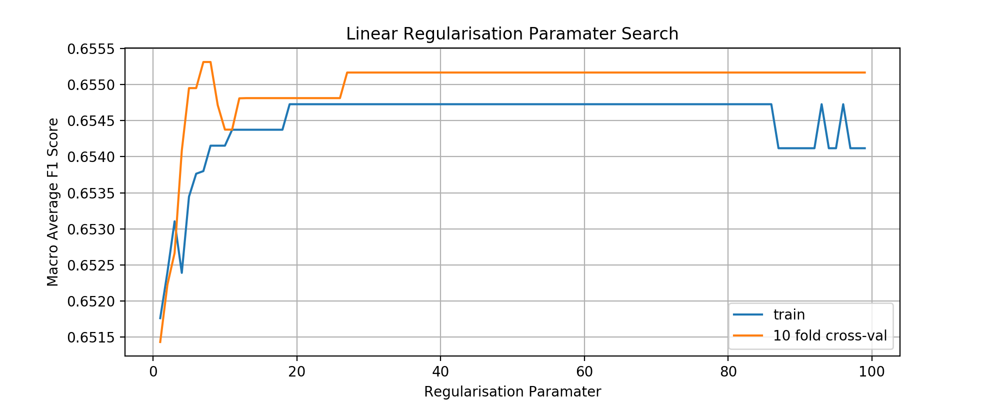

In [3770]:
plt.figure(figsize=(10,4))
plt.title("Linear Regularisation Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Macro Average F1 Score")
plt.plot(Cs,train_f1s_1,label="train")
plt.plot(Cs,val_f1s_1,label="10 fold cross-val")
plt.grid()
plt.legend()
plt.show()

In [3681]:
np.max(val_f1s_1)
index=val_f1s_1.index(np.max(val_f1s_1))
print(Cs[index])
C_linear=Cs[index]

43.0


In [3672]:
C_linear=Cs[index]

In [3682]:
clf = svm.SVC(kernel='linear',class_weight="balanced",C=C_linear).fit(X,y)

<IPython.core.display.Javascript object>


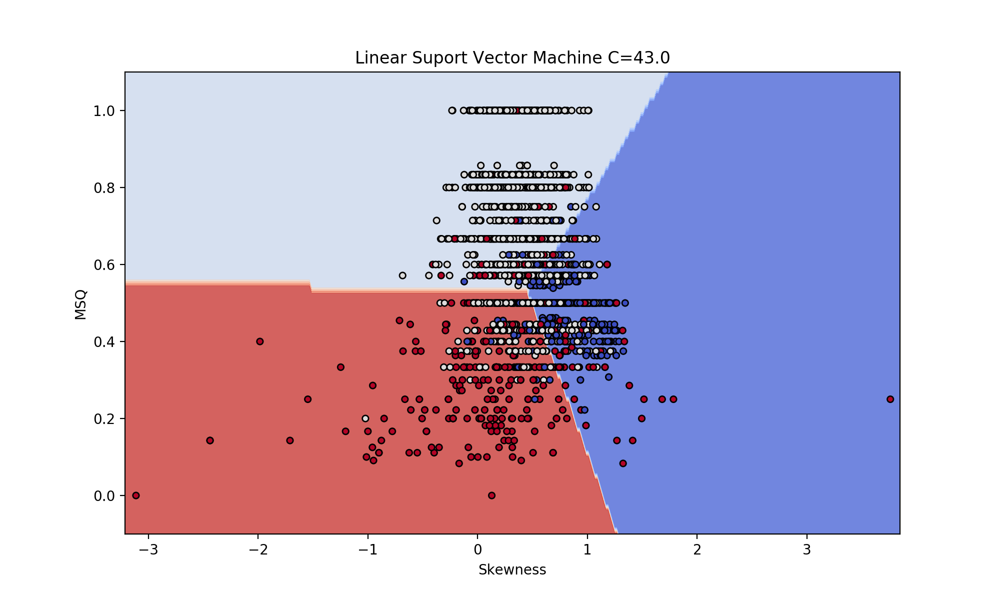

In [3683]:
X0, X1 = X["Skewness"].values, X["MSQ"].values
fig, sub = plt.subplots(1, 1,figsize=(10,6))
ax = plt.gca()
xx, yy = make_meshgrid(X0, X1)
plot_contours(ax, clf, xx, yy,
              cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
ax.set_xlim(xx.min(), xx.max())
ax.set_ylim(yy.min(), yy.max())
ax.set_xlabel("Skewness")
ax.set_ylabel('MSQ')
ax.set_title("Linear Suport Vector Machine C={}".format(C_linear))
plt.show()

In [2082]:
dict_models=[{"classifier":svm.SVC,"kernel":"linear"},
             {"classifier":svm.SVC,"kernel":"rbf"},
#              {"classifier":svm.SVC,"kernel":"poly"},
            ]

In [3675]:
train_f1s_2=[]
val_f1s_2=[]
Cs2=np.arange(0.01,3.0,0.01)

for C in tqdm(Cs2):
    print("Regularisation: ",C)
    
    clf=svm.SVC(kernel='rbf', C=C ,class_weight="balanced",random_state=2).fit(X,y)
    
    train_r=get_f1_score(clf,X,y)
    print("Train f1: ",train_r)
    val_rs= cross_val_score(svm.SVC(kernel='rbf', C=C,class_weight="balanced",random_state=2), X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
    print("Val f1: ",val_r)
    train_f1s_2.append(train_r)
    val_f1s_2.append(val_r)
    print("")


Regularisation:  0.01
Train f1:  0.632471581884753
Val f1:  0.6310585644298445

Regularisation:  0.02
Train f1:  0.6406529226402641
Val f1:  0.638896281396092

Regularisation:  0.03
Train f1:  0.6438040562899766
Val f1:  0.6388006959249245

Regularisation:  0.04
Train f1:  0.6504289554356165
Val f1:  0.6414265186215631

Regularisation:  0.05
Train f1:  0.6549996848611243
Val f1:  0.6496295405994545

Regularisation:  0.060000000000000005
Train f1:  0.6544790776335704
Val f1:  0.6509744439341896

Regularisation:  0.06999999999999999
Train f1:  0.6548281511541524
Val f1:  0.652699302539723

Regularisation:  0.08
Train f1:  0.655331866781475
Val f1:  0.6529458598561708

Regularisation:  0.09
Train f1:  0.6569893885054453
Val f1:  0.6534736313501817

Regularisation:  0.09999999999999999
Train f1:  0.6591724341624889
Val f1:  0.6546264563834608

Regularisation:  0.11
Train f1:  0.6595676573853594
Val f1:  0.6538412075792316

Regularisation:  0.12
Train f1:  0.6582177845860187
Val f1:  0.6548

Val f1:  0.6680427014311416

Regularisation:  0.99
Train f1:  0.6677560182684158
Val f1:  0.6680427014311416

Regularisation:  1.0
Train f1:  0.6677560182684158
Val f1:  0.6687834446951918

Regularisation:  1.01
Train f1:  0.6677560182684158
Val f1:  0.6687834446951918

Regularisation:  1.02
Train f1:  0.6677560182684158
Val f1:  0.6687834446951918

Regularisation:  1.03
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.04
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.05
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.06
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.07
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.08
Train f1:  0.6681985422808561
Val f1:  0.6692239428852298

Regularisation:  1.09
Train f1:  0.6681985422808561
Val f1:  0.6692239428852298

Regularisation:  1.1
Train f1:  0.6681985422808561
Val f1:  0.6692239428852298

R

Val f1:  0.6684758437323575

Regularisation:  1.98
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  1.99
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.0
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.01
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.02
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.03
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.04
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.05
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.0599999999999996
Train f1:  0.6717296842094429
Val f1:  0.6676793965733616

Regularisation:  2.07
Train f1:  0.6717296842094429
Val f1:  0.6676793965733616

Regularisation:  2.0799999999999996
Train f1:  0.6717296842094429
Val f1:  0.6670077197504914

Regularisation:  2.09
Train f1:  0.6717296842094429
V

Val f1:  0.6662203695073972

Regularisation:  2.94
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.9499999999999997
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.96
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.9699999999999998
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.98
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.9899999999999998
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972




<IPython.core.display.Javascript object>


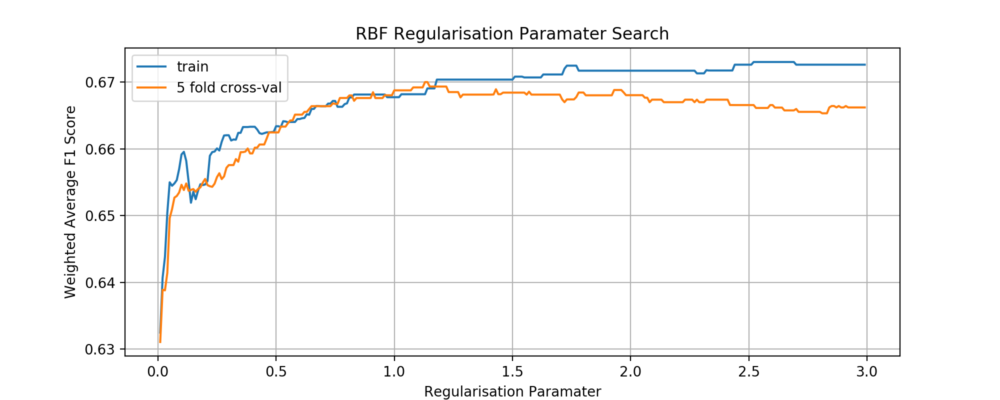

In [3676]:
plt.figure(figsize=(10,4))
plt.title("RBF Regularisation Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs2,train_f1s_2,label="train")
plt.plot(Cs2,val_f1s_2,label="5 fold cross-val")
plt.grid()
plt.legend()
plt.show()

In [3677]:
np.max(val_f1s_2)
index2=val_f1s_2.index(np.max(val_f1s_2))
print(Cs2[index2])
C_rbf=Cs2[index2]

1.1300000000000001


In [3678]:
train_f1s_3=[]
val_f1s_3=[]
Cs3=np.arange(1.0,500.0,10.0)

for C in tqdm(Cs3):
    print("Regularisation: ",C)
    
    clf=svm.SVC(kernel='poly',gamma="auto",degree=4, C=C,class_weight="balanced",random_state=2).fit(X,y)
    
    train_r=get_f1_score(clf,X,y)
    print("Train f1: ",train_r)
    val_rs= cross_val_score(svm.SVC(kernel='poly',gamma="auto",degree=4, C=C,class_weight="balanced",random_state=2), X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
    print("Val f1: ",val_r)
    train_f1s_3.append(train_r)
    val_f1s_3.append(val_r)
    print("")


Regularisation:  1.0
Train f1:  0.5790175286221876
Val f1:  0.5663900354654665

Regularisation:  11.0
Train f1:  0.6194427049016072
Val f1:  0.6141609345136114

Regularisation:  21.0
Train f1:  0.6218066354956401
Val f1:  0.6181186681005064

Regularisation:  31.0
Train f1:  0.6227065545779301
Val f1:  0.6193456407066918

Regularisation:  41.0
Train f1:  0.6236864142858245
Val f1:  0.6193733393379465

Regularisation:  51.0
Train f1:  0.6240570323878522
Val f1:  0.6190341472849725

Regularisation:  61.0
Train f1:  0.6268183508402801
Val f1:  0.6179765362859417

Regularisation:  71.0
Train f1:  0.6242591925550744
Val f1:  0.6175890330002175

Regularisation:  81.0
Train f1:  0.623428779125682
Val f1:  0.6175741585127732

Regularisation:  91.0
Train f1:  0.622529493635543
Val f1:  0.6164547480083309

Regularisation:  101.0
Train f1:  0.6214168592248045
Val f1:  0.6151840373169917

Regularisation:  111.0
Train f1:  0.6218639040646642
Val f1:  0.6155586274939864

Regularisation:  121.0
Train 

<IPython.core.display.Javascript object>


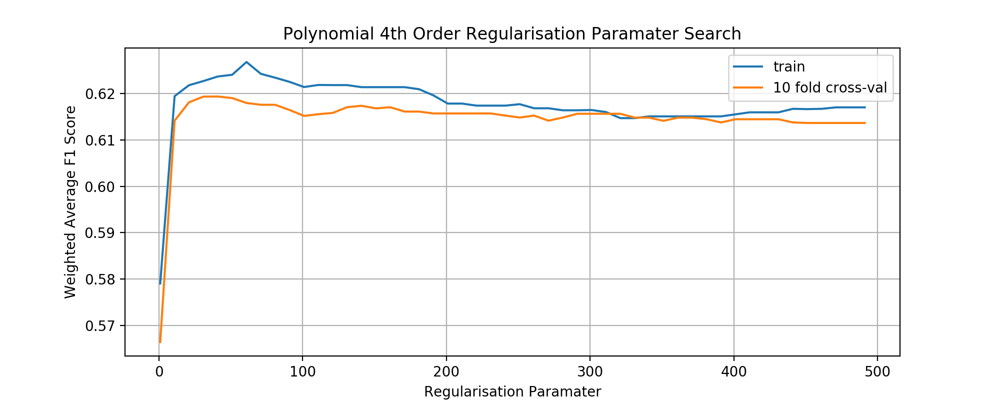

In [3679]:
plt.figure(figsize=(10,4))
plt.title("Polynomial 4th Order Regularisation Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs3,train_f1s_3,label="train")
plt.plot(Cs3,val_f1s_3,label="10 fold cross-val")
plt.grid()
plt.legend()
plt.show()

In [3680]:
np.max(val_f1s_3)
index3=val_f1s_3.index(np.max(val_f1s_3))
print(Cs3[index3])
C_poly=Cs3[index3]

41.0


In [3699]:
# # we create an instance of SVM and fit out data. We do not scale our
# # data since we want to plot the support vectors
C1 = 43.0 # SVM regularization parameter
C2 = 2.69 
# C3 = 400.0
models1 = [svm.SVC(kernel='linear',class_weight="balanced",C=C_linear,random_state=2).fit(X,y),
          svm.SVC(kernel='rbf',class_weight="balanced",C=C_rbf,random_state=2).fit(X,y),
          svm.SVC(kernel='poly', degree=4, gamma='auto',max_iter=10000,class_weight="balanced",C=C_poly,random_state=2).fit(X,y)]

<IPython.core.display.Javascript object>


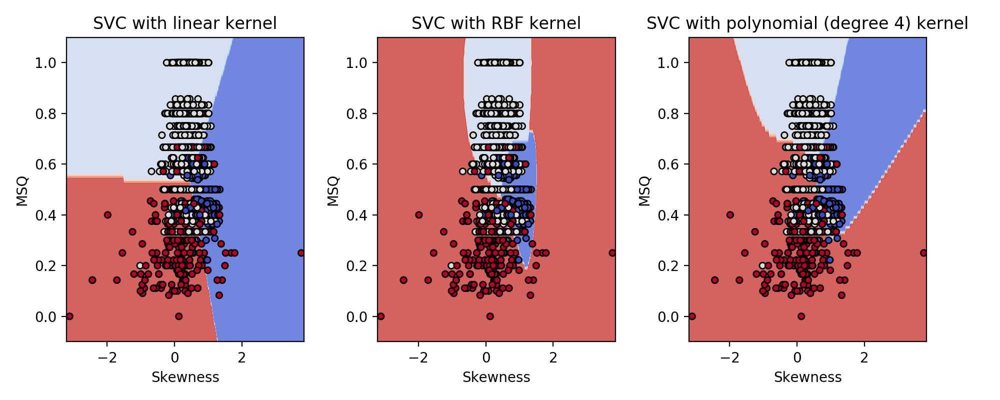

In [3700]:
# title for the plots
titles = ('SVC with linear kernel',
          'SVC with RBF kernel',
          'SVC with polynomial (degree 4) kernel')

# Set-up 2x2 grid for plotting.
fig, sub = plt.subplots(1, 3,figsize=(10,4))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)


for clf, title, ax in zip(models1, titles, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(yy.min(), yy.max())
    ax.set_xlabel("Skewness")
    ax.set_ylabel('MSQ')
    ax.set_title(title)
# plt.legend(["A","B","C"])
plt.tight_layout()
plt.show()

In [3701]:
Training_F1s=[]
Training_Precisions=[]
Training_Recals=[]

Validation_F1s=[]
Validation_Precisions=[]
Validation_Recals=[]
stds_err_prec_svm=[]
stds_err_rec_svm=[]
stds_err_f1_svm=[]
for clf,title in zip(models1,titles):
    print(title)
    train_pred=clf.predict(X)
    train_f1=get_f1_score(clf,X,y)
    Training_F1s.append(train_f1)
    print("Train f1: ",train_f1)
    train_pre=get_precision_score(clf,X,y)
    Training_Precisions.append(train_pre)
    print("Train prec: ",train_pre)
    train_rec=get_recall_score(clf,X,y)
    Training_Recals.append(train_rec)
    print("Train recall: ",train_rec)  
    
    val_f1s= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_f1=val_f1s.mean()
    val_f1_std=val_f1s.std()
    Validation_F1s.append(val_f1)
    stds_err_f1_svm.append(val_f1_std)
    
    val_pres= cross_val_score(clf, X, y,scoring=get_precision_score, cv=10)
    val_pre=val_pres.mean()
    val_pre_std=val_pres.std()
    Validation_Precisions.append(val_pre)
    stds_err_prec_svm.append(val_pre_std)
    
    val_recs= cross_val_score(clf, X, y,scoring=get_recall_score, cv=10)
    val_rec=val_recs.mean()
    val_rec_std=val_recs.std()
    Validation_Recals.append(val_rec)
    stds_err_rec_svm.append(val_rec_std)
    
    print("Val f1: {} +- {}".format(val_f1,val_f1_std))
    print("Val prec: {} +- {}".format(val_pre,val_pre_std))
    print("Val rec: {} +- {}".format(val_rec,val_rec_std))
    print("")

SVC with linear kernel
Train f1:  0.6559260570478873
Train prec:  0.7136734153620337
Train recall:  0.6391927055556034
Val f1: 0.6558363349866936 +- 0.02655434962139589
Val prec: 0.7134187868870125 +- 0.03219677761223458
Val rec: 0.6394442441529942 +- 0.023955005878428935

SVC with RBF kernel
Train f1:  0.6681985422808561
Train prec:  0.7206782002945425
Train recall:  0.6578130371204044
Val f1: 0.6700247726350936 +- 0.02901609273965288
Val prec: 0.7223729249529669 +- 0.033320564808141155
Val rec: 0.6607015932488793 +- 0.02875771201567418

SVC with polynomial (degree 4) kernel
Train f1:  0.6236864142858245
Train prec:  0.7032251630130569
Train recall:  0.6111413040824126
Val f1: 0.6193733393379465 +- 0.028067615035188058
Val prec: 0.6996808948973647 +- 0.03329213794671786
Val rec: 0.6092315285768416 +- 0.02252108311251527



In [88]:
def percentage(col):
    cols=[]
    for c in col:
        cols.append(c*100.00)
    return cols

In [2668]:
Training_F1s

[0.7053803849984258, 0.7250607981904017, 0.6440701794750476]

In [2807]:
columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
SVM_Table=pd.DataFrame([Training_Precisions,Training_Recals,Training_F1s,Validation_Precisions,Validation_Recals,Validation_F1s]).T
SVM_Table.columns=columns
SVM_Table.index=titles
SVM_Table = SVM_Table.apply(percentage)
SVM_Table

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.367342,63.919271,65.592606,71.341879,63.944424,65.583633
SVC with RBF kernel,72.779411,66.186712,67.619978,72.477749,66.015237,67.272176
SVC with polynomial (degree 4) kernel,70.322516,61.114130,62.368641,69.968089,60.923153,61.937334


# Linear Classifiers

In [75]:
from sklearn.linear_model import Perceptron
from sklearn import linear_model
from sklearn.linear_model import SGDClassifier, Perceptron
from sklearn.linear_model import PassiveAggressiveClassifier
from sklearn.linear_model import LogisticRegression

In [1616]:
def make_meshgrid(x, y, h=.02):
    """Create a mesh of points to plot in

    Parameters
    ----------
    x: data to base x-axis meshgrid on
    y: data to base y-axis meshgrid on
    h: stepsize for meshgrid, optional

    Returns
    -------
    xx, yy : ndarray
    """
    x_min, x_max = x.min()-0.1, x.max()+0.1 
    y_min, y_max = y.min()-0.1, y.max()+0.1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))
    return xx, yy

def plot_contours(ax, clf, xx, yy, **params):
    """Plot the decision boundaries for a classifier.

    Parameters
    ----------
    ax: matplotlib axes object
    clf: a classifier
    xx: meshgrid ndarray
    yy: meshgrid ndarray
    params: dictionary of params to pass to contourf, optional
    """
#     print(clf)
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    out = ax.contourf(xx, yy, Z, **params)
    return out

def plot_hyperplane(coef,intercept,c, color,ax):
    print("coef: ",coef)
    print("intercept: ",intercept)
    def line(x0):
        return (-(x0 * coef[c, 0]) - intercept[c]) / coef[c, 1]
    ax.plot([xmin, xmax], [line(xmin), line(xmax)],
             ls="--", color=color)

In [ ]:
X = train_scores[["Skewness","MSQ"]]
y=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y.append(0)
    if(label=="B"):
        y.append(1)
    if(label=="C"):
        y.append(2)
print("X shape: {}".format(X.shape[0]))
print("y shape: {}".format(len(y)))

In [1535]:
for model in models3:
    print(model.classes_)

[0 1 2]
[0 1 2]
[0 1 2]
[0 1 2]
[0 1 2]
[0 1 2]


In [1771]:
import warnings
warnings.filterwarnings('ignore')

In [3244]:
print(y)

MSQ


In [452]:
loss="modified_huber"
train_huber=[]
val_huber=[]
Cs_huber=np.arange(0.0006,.08,0.0006)

for C in tqdm(Cs_huber):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_huber.append(train_r)
    val_huber.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


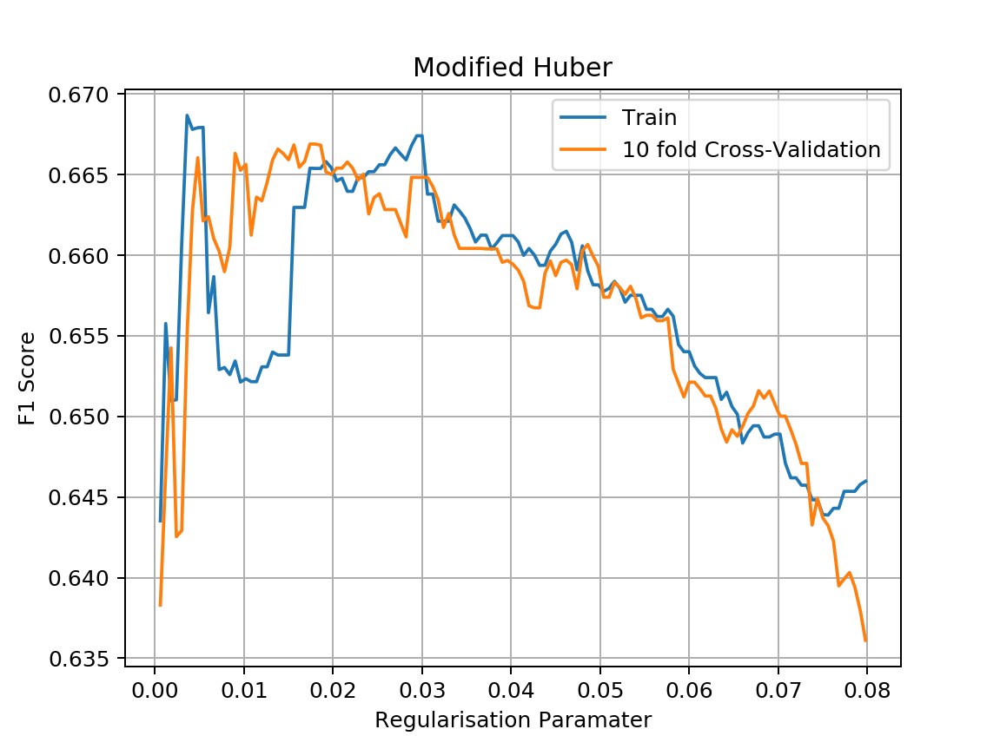

In [453]:
plt.figure()
plt.title("Modified Huber")
plt.plot(Cs_huber,train_huber,label="Train")
plt.plot(Cs_huber,val_huber,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [454]:
index_huber=val_huber.index(np.max(val_huber))
C_huber=Cs_huber[index_huber]
print("Huber alpha: ",C_huber)

Huber alpha:  0.0174


In [455]:
loss="log"
train_log=[]
val_log=[]
Cs_log=np.arange(0.0001,0.01,0.0001)

for C in tqdm(Cs_log):
#     print("Regularisation: ",C)
    
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_log.append(train_r)
    val_log.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


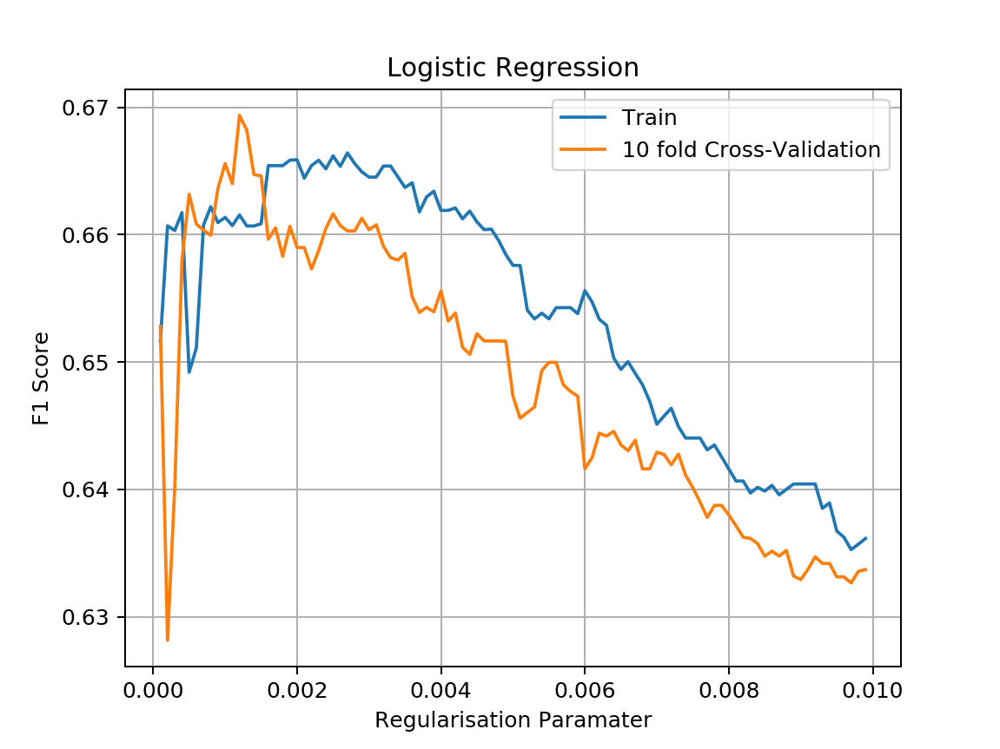

In [456]:
plt.figure()
plt.title("Logistic Regression")
plt.plot(Cs_log,train_log,label="Train")
plt.plot(Cs_log,val_log,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [457]:
index_log=val_log.index(np.max(val_log))
C_log=Cs_log[index_log]
print("Logistic alpha: ",C_log)

Logistic alpha:  0.0012000000000000001


In [458]:
penalty="elasticnet"
train_elas=[]
val_elas=[]
Cs_elas=np.arange(0.0002,0.02,0.0002)

for C in tqdm(Cs_elas):
#     print("Regularisation: ",C)
    clf=SGDClassifier(penalty=penalty,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_elas.append(train_r)
    val_elas.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


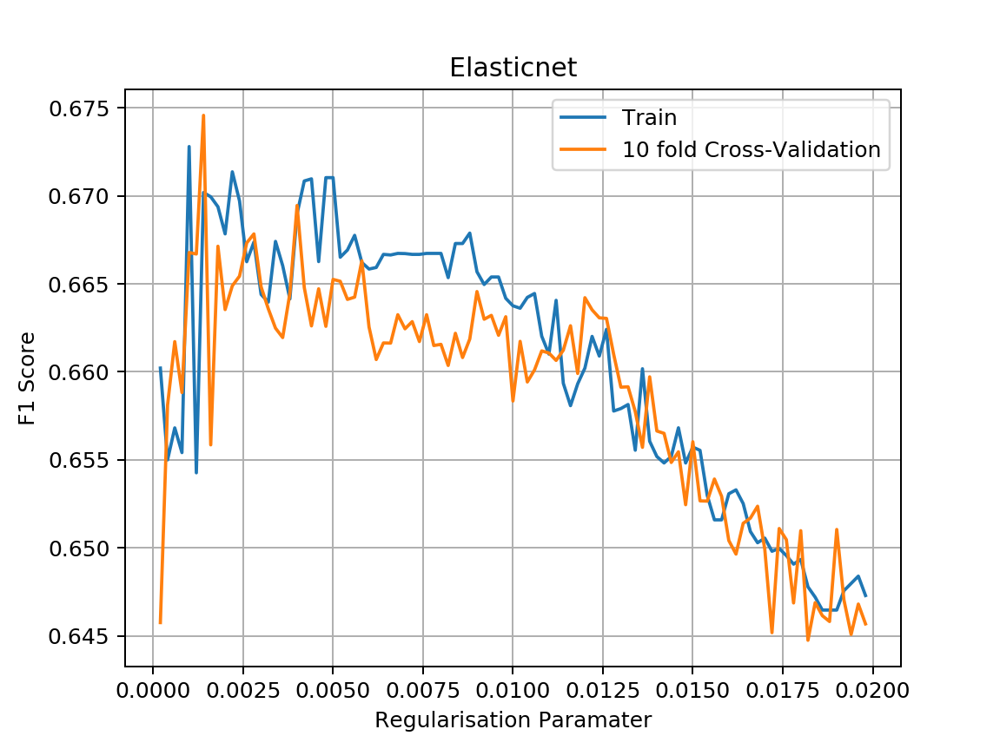

In [459]:
plt.figure()
plt.title("Elasticnet")
plt.plot(Cs_elas,train_elas,label="Train")
plt.plot(Cs_elas,val_elas,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [460]:
index_elas=val_elas.index(np.max(val_elas))
C_elas=Cs_elas[index_elas]
print("Elastic alpha: ",C_elas)

Elastic alpha:  0.0014000000000000002


In [461]:
loss="squared_loss"
train_sq=[]
val_sq=[]
Cs_sq=np.arange(0.0002,.02,0.0002)

for C in tqdm(Cs_sq):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_sq.append(train_r)
    val_sq.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


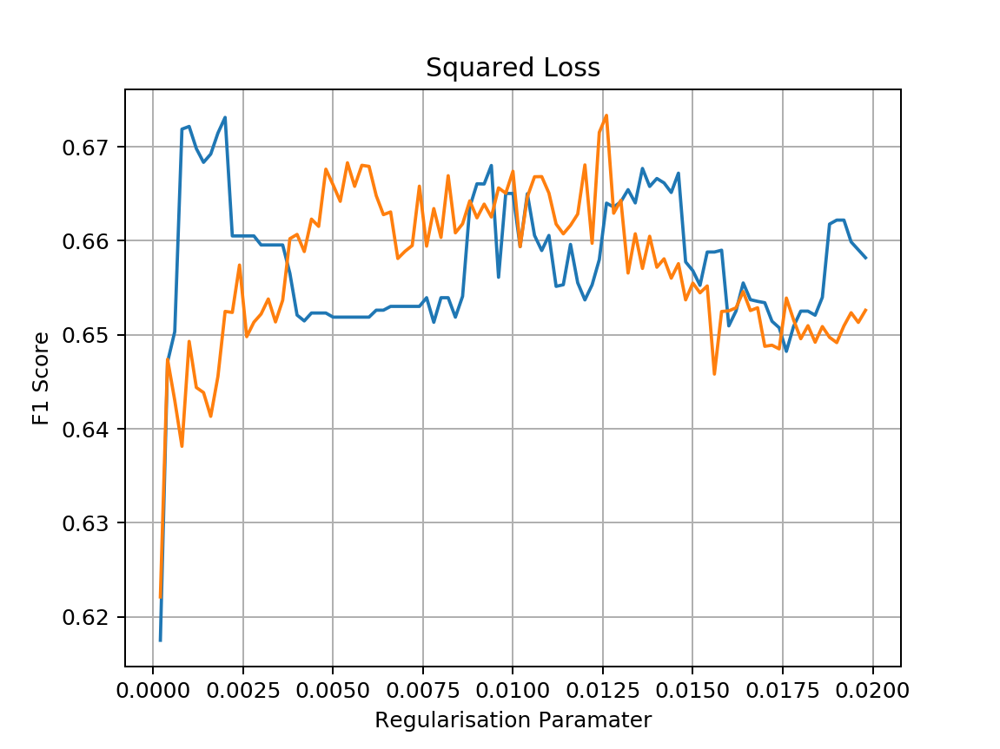

In [462]:
plt.figure()
plt.title("Squared Loss")
plt.plot(Cs_sq,train_sq,label="Train")
plt.plot(Cs_sq,val_sq,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [463]:
index_sq=val_sq.index(np.max(val_sq))
C_sq=Cs_sq[index_sq]
print("Squared Alpha: ",C_sq)

Squared Alpha:  0.012600000000000002


In [464]:
train_norm=[]
val_norm=[]
Cs_norm=np.arange(0.0002,0.02,0.0002)
for C in tqdm(Cs_norm):
#     print("Regularisation: ",C)
    clf=SGDClassifier(alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_norm.append(train_r)
    val_norm.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


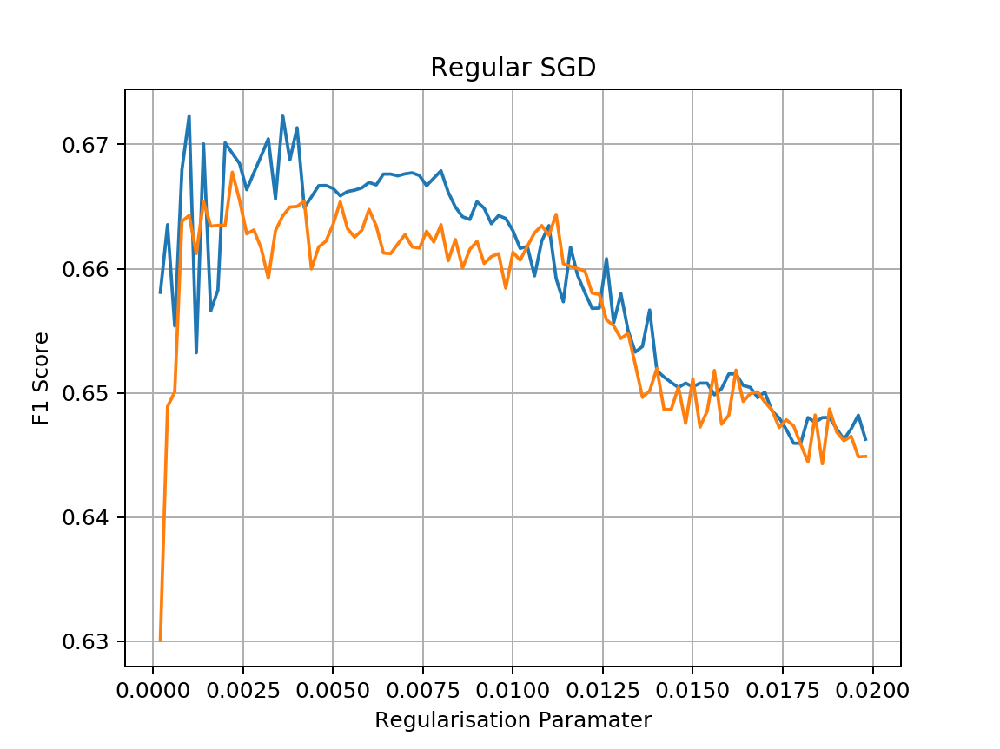

In [465]:
plt.figure()
plt.title("Regular SGD")
plt.plot(Cs_norm,train_norm,label="Train")
plt.plot(Cs_norm,val_norm,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [466]:
index_norm=val_norm.index(np.max(val_norm))
C_norm=Cs_norm[index_norm]
print("Logistic alpha: ",C_norm)

Logistic alpha:  0.0022


In [467]:
from sklearn.linear_model import RidgeClassifier

In [238]:
models4 = [
    RidgeClassifier(random_state=2,class_weight="balanced").fit(X,y),
    SGDClassifier(penalty="elasticnet",class_weight="balanced",random_state=2,alpha=C_elas).fit(X,y),
    SGDClassifier(loss="modified_huber",random_state=2,class_weight="balanced",alpha=C_huber).fit(X,y),
    SGDClassifier(loss="log",random_state=2,class_weight="balanced",alpha=C_log).fit(X,y),
    SGDClassifier(loss="squared_loss",random_state=2,class_weight="balanced",alpha=C_sq).fit(X,y),
    Perceptron(random_state=2,class_weight="balanced").fit(X,y),
]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


<IPython.core.display.Javascript object>


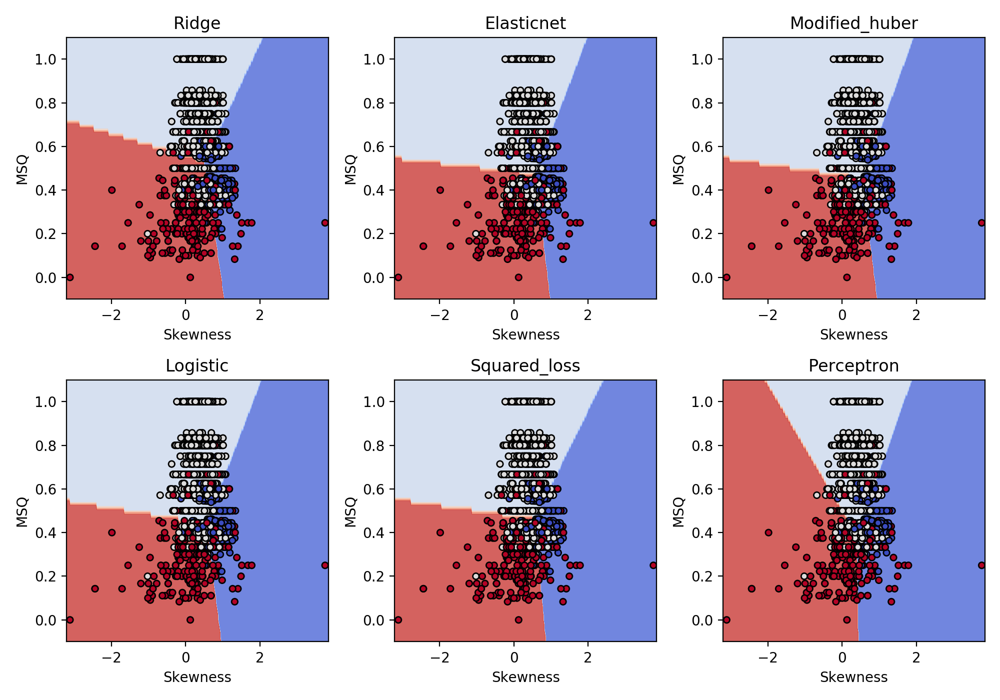

In [239]:
# title for the plots
titles4 = ('Ridge',
          'Elasticnet',
          'Modified_huber',
          'Logistic',
          'Squared_loss',
          'Perceptron',)

# Set-up 2x3 grid for plotting.
fig, sub = plt.subplots(2, 3,figsize=(10,7))
# plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)

# print("titles length: ",len(titles))
# print("models length: ",len(models))
# print("figures length: ",len(sub.flatten()))
colors = "bry"

for clf, title, ax in zip(models4, titles3, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
#     for i, color in zip(clf.classes_, colors):
#         plot_hyperplane(clf.coef_,clf.intercept_,i, color,ax)
    ax.set_xlabel('Skewness')
    ax.set_ylabel('MSQ')
    ax.set_title(title)
plt.tight_layout()
plt.show()

In [3772]:
Training_F1s=[]
Training_Precisions=[]
Training_Recals=[]

Validation_F1s=[]
Validation_Precisions=[]
Validation_Recals=[]
stds_err_prec_sgd=[]
stds_err_rec_sgd=[]
stds_err_f1_sgd=[]
for clf,title in zip(models3,titles3):
    print(title)
    train_pred=clf.predict(X)
    train_f1=get_f1_score(clf,X,y)
    Training_F1s.append(train_f1)
    print("Train f1: ",train_f1)
    train_pre=get_precision_score(clf,X,y)
    Training_Precisions.append(train_pre)
    print("Train prec: ",train_pre)
    train_rec=get_recall_score(clf,X,y)
    Training_Recals.append(train_rec)
    print("Train recall: ",train_rec)  
    
    val_f1s= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_f1=val_f1s.mean()
    val_f1_std=val_f1s.std()
    Validation_F1s.append(val_f1)
    stds_err_f1_sgd.append(val_f1_std)
    
    val_pres= cross_val_score(clf, X, y,scoring=get_precision_score, cv=10)
    val_pre=val_pres.mean()
    val_pre_std=val_pres.std()
    Validation_Precisions.append(val_pre)
    stds_err_prec_sgd.append(val_pre_std)
    
    val_recs= cross_val_score(clf, X, y,scoring=get_recall_score, cv=10)
    val_rec=val_recs.mean()
    val_rec_std=val_recs.std()
    Validation_Recals.append(val_rec)
    stds_err_rec_sgd.append(val_rec_std)
    
    print("Val f1: {} +- {}".format(val_f1,val_f1_std))
    print("Val prec: {} +- {}".format(val_pre,val_pre_std))
    print("Val rec: {} +- {}".format(val_rec,val_rec_std))
    print("")

Ridge
Train f1:  0.6599071914234846
Train prec:  0.7080559356200381
Train recall:  0.6400538958083904
Val f1: 0.6634744210431853 +- 0.045233393676194486
Val prec: 0.7139607064961662 +- 0.04690006841920165
Val rec: 0.6459044644688173 +- 0.041500899012120444

Elasticnet
Train f1:  0.6728681057379434
Train prec:  0.6855274900146696
Train recall:  0.6710844135297189
Val f1: 0.6670645499792875 +- 0.04629222552840013
Val prec: 0.6927842486351018 +- 0.049428683803991444
Val rec: 0.6595367943153965 +- 0.04229677120504061

Modified_huber
Train f1:  0.668049902593328
Train prec:  0.6801160134493468
Train recall:  0.6709377085501044
Val f1: 0.6692941602165962 +- 0.05240253457750968
Val prec: 0.6840005734499579 +- 0.05427233538360059
Val rec: 0.6749680091956249 +- 0.05280204862052864

Logistic
Train f1:  0.6652274793774112
Train prec:  0.6665553620681826
Train recall:  0.6734892787524366
Val f1: 0.6601088629232462 +- 0.05808478635196214
Val prec: 0.6678213180355164 +- 0.05818558794841338
Val rec: 

In [3773]:
columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
SGD_Table=pd.DataFrame([Training_Precisions,Training_Recals,Training_F1s,Validation_Precisions,Validation_Recals,Validation_F1s]).T
SGD_Table.columns=columns
SGD_Table.index=titles3
SGD_Table = SGD_Table.apply(percentage)
SGD_Table

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
Ridge,70.805594,64.005390,65.990719,71.396071,64.590446,66.347442
Elasticnet,68.552749,67.108441,67.286811,69.278425,65.953679,66.706455
Modified_huber,68.011601,67.093771,66.804990,68.400057,67.496801,66.929416
Logistic,66.655536,67.348928,66.522748,66.782132,66.749254,66.010886
Squared_loss,67.349833,67.191677,66.726498,68.437570,68.241379,67.726455
Perceptron,66.470514,67.861037,64.781388,57.041552,63.114612,52.901158


In [3726]:
Results_Table=pd.concat([SVM_Table,SGD_Table])

In [3727]:
Results_Table

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.367342,63.919271,65.592606,71.341879,63.944424,65.583633
SVC with RBF kernel,72.779411,66.186712,67.619978,72.477749,66.015237,67.272176
SVC with polynomial (degree 4) kernel,70.322516,61.114130,62.368641,69.968089,60.923153,61.937334
Ridge,70.796480,63.894462,65.778596,70.783577,63.987421,65.706538
Elasticnet,68.577048,66.935939,67.018753,69.726977,67.078426,67.456846
Modified_huber,68.035569,66.986988,66.539591,68.143564,66.982138,66.689407
Logistic,66.472578,67.112350,66.155489,68.720917,67.024963,66.937873
Squared_loss,67.294336,67.011843,66.401383,68.188158,67.612145,67.335161
Perceptron,66.858146,68.270685,64.866071,56.681520,65.228258,53.811095


In [2356]:
Results_Table.to_csv("Results_Table.csv",float_format="%.2f")

# Decision Tree Classification

In [1554]:
from sklearn import tree

In [1560]:
feature_names=["Skewness","MSQ"]
target_names=["A","B","C"]

In [3880]:
t = tree.DecisionTreeClassifier(class_weight="balanced",max_depth=4,random_state=2)
t = t.fit(X, y)

<IPython.core.display.Javascript object>


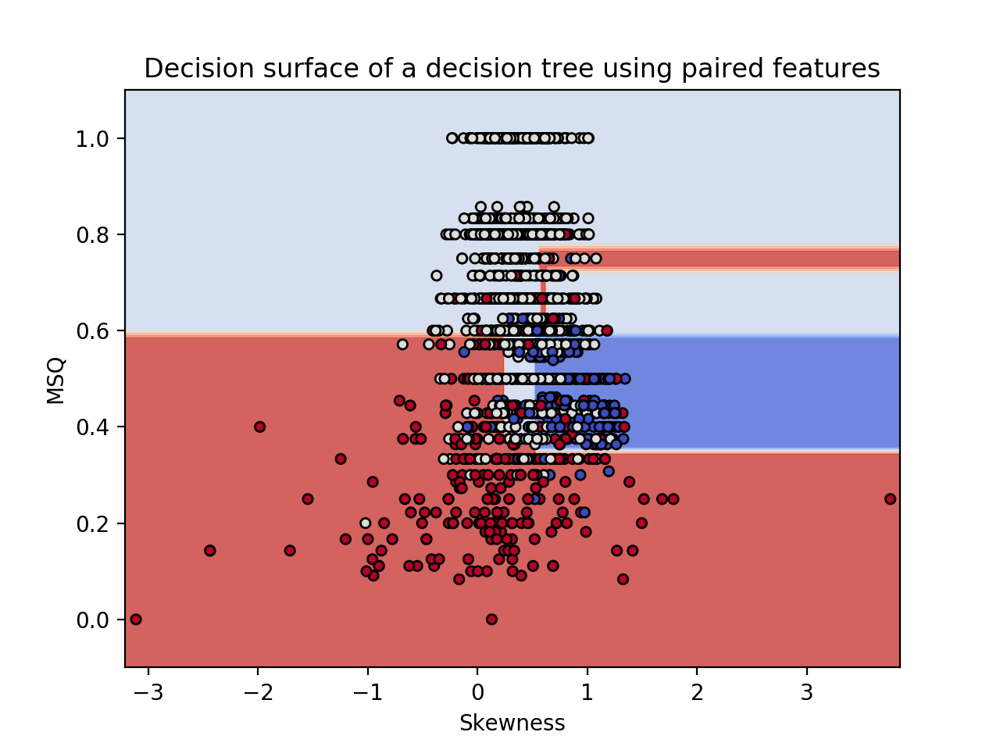

(-3.2124930601009427, 3.847506939899063, -0.1, 1.1)

In [3881]:
plt.figure()
plot_step = 0.02
x_min, x_max = X["Skewness"].min() - 0.1, X["Skewness"].max() + 0.1
y_min, y_max = X["MSQ"].min() - 0.1, X["MSQ"].max() + 0.1

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)
plot_contours(plt,t, xx, yy, cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')

plt.xlabel("Skewness")
plt.ylabel("MSQ")

plt.title("Decision surface of a decision tree using paired features")
# plt.legend(loc='lower right', borderpad=0, handletextpad=0)
plt.axis("tight")

<IPython.core.display.Javascript object>


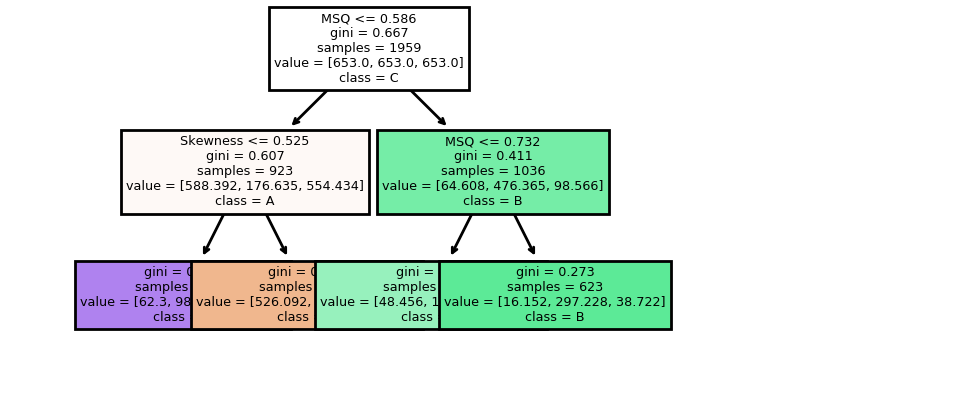

In [3730]:
plt.figure()
tree.plot_tree(t,filled=True,feature_names=feature_names,class_names=target_names) 
plt.axis("tight")
plt.show()

In [3731]:
train_pred=t.predict(X)
train_f1=get_f1_score(t,X,y)

print("Train f1: ",train_f1)
train_pre=get_precision_score(t,X,y)

print("Train prec: ",train_pre)
train_rec=get_recall_score(t,X,y)

print("Train recall: ",train_rec)  

val_f1s= cross_val_score(t, X, y,scoring=get_f1_score, cv=10)
val_f1=val_f1s.mean()
stds_err_f1_dt=val_f1s.std()


val_pres= cross_val_score(t, X, y,scoring=get_precision_score, cv=10)
val_pre=val_pres.mean()
stds_err_prec_dt=val_pres.std()


val_recs= cross_val_score(t, X, y,scoring=get_recall_score, cv=10)
val_rec=val_recs.mean()
stds_err_rec_dt=val_recs.std()


print("Val f1: {} +- {}".format(val_f1,val_f1_std))
print("Val prec: {} +- {}".format(val_pre,val_pre_std))
print("Val rec: {} +- {}".format(val_rec,val_rec_std))
print("")

Train f1:  0.6444721569538753
Train prec:  0.7030932050581636
Train recall:  0.6252078378700837
Val f1: 0.639559877637119 +- 0.1183729141219032
Val prec: 0.6962216726741325 +- 0.08685642281041318
Val rec: 0.6213521594537926 +- 0.10582667137760082



In [3732]:
Results_Table.loc["Decision Tree"]=[train_pre*100,train_rec*100,train_f1*100,val_pre*100,val_rec*100,val_f1*100]

In [2847]:
stds_err_prec_svm

[0.03219677761223458, 0.03518939453767777, 0.03329213794671786]

In [3733]:
errors_prec=[]
errors_prec.extend(stds_err_prec_svm)
errors_prec.extend(stds_err_prec_sgd)
errors_prec.append(stds_err_prec_dt)

In [3734]:
errors_rec=[]
errors_rec.extend(stds_err_rec_svm)
errors_rec.extend(stds_err_rec_sgd)
errors_rec.append(stds_err_rec_dt)

In [3735]:
errors_f1=[]
errors_f1.extend(stds_err_f1_svm)
errors_f1.extend(stds_err_f1_sgd)
errors_f1.append(stds_err_f1_dt)

In [2858]:
print(len(errors_prec))
print(len(errors_rec))
print(len(errors_f1))

10
10
10


In [3736]:
Errors_prec=[]
Errors_rec=[]
Errors_f1=[]
for e_prec,e_rec,e_f1 in zip(errors_prec,errors_rec,errors_f1):
    Errors_prec.append(e_prec*100)
    Errors_rec.append(e_rec*100)
    Errors_f1.append(e_f1*100)

In [2864]:
for index,error in zip(Results_Table["Validation F1-Score"].index,Errors_f1):
    print("F1: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation F1-Score"][index],error))
for index,error in zip(Results_Table["Validation Recall"].index,Errors_rec):
    print("Recall: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Recall"][index],error))
for index,error in zip(Results_Table["Validation Precision"].index,Errors_prec):
    print("Precision: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Precision"][index],error))

F1: 65.58 $\pm$ 2.66
F1: 67.27 $\pm$ 3.17
F1: 61.94 $\pm$ 2.81
F1: 65.71 $\pm$ 2.47
F1: 67.46 $\pm$ 4.02
F1: 66.69 $\pm$ 3.13
F1: 66.94 $\pm$ 3.16
F1: 67.34 $\pm$ 3.30
F1: 53.81 $\pm$ 11.84
F1: 53.81 $\pm$ 2.47
Recall: 63.94 $\pm$ 2.40
Recall: 66.02 $\pm$ 3.18
Recall: 60.92 $\pm$ 2.25
Recall: 63.99 $\pm$ 2.28
Recall: 67.08 $\pm$ 4.14
Recall: 66.98 $\pm$ 3.58
Recall: 67.02 $\pm$ 3.77
Recall: 67.61 $\pm$ 3.73
Recall: 65.23 $\pm$ 10.58
Recall: 65.23 $\pm$ 2.14
Precision: 71.34 $\pm$ 3.22
Precision: 72.48 $\pm$ 3.52
Precision: 69.97 $\pm$ 3.33
Precision: 70.78 $\pm$ 2.97
Precision: 69.73 $\pm$ 4.54
Precision: 68.14 $\pm$ 3.30
Precision: 68.72 $\pm$ 3.51
Precision: 68.19 $\pm$ 3.27
Precision: 56.68 $\pm$ 8.69
Precision: 56.68 $\pm$ 3.18


In [3737]:
for index,error in zip(Results_Table["Validation F1-Score"].index,Errors_f1):
    print("F1: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation F1-Score"][index],error))
for index,error in zip(Results_Table["Validation Recall"].index,Errors_rec):
    print("Recall: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Recall"][index],error))
for index,error in zip(Results_Table["Validation Precision"].index,Errors_prec):
    print("Precision: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Precision"][index],error))

F1: 65.58 $\pm$ 2.66
F1: 67.27 $\pm$ 2.90
F1: 61.94 $\pm$ 2.81
F1: 65.71 $\pm$ 2.47
F1: 67.46 $\pm$ 4.02
F1: 66.69 $\pm$ 3.13
F1: 66.94 $\pm$ 3.16
F1: 67.34 $\pm$ 3.30
F1: 53.81 $\pm$ 11.84
F1: 63.96 $\pm$ 2.47
Recall: 63.94 $\pm$ 2.40
Recall: 66.02 $\pm$ 2.88
Recall: 60.92 $\pm$ 2.25
Recall: 63.99 $\pm$ 2.28
Recall: 67.08 $\pm$ 4.14
Recall: 66.98 $\pm$ 3.58
Recall: 67.02 $\pm$ 3.77
Recall: 67.61 $\pm$ 3.73
Recall: 65.23 $\pm$ 10.58
Recall: 62.14 $\pm$ 2.14
Precision: 71.34 $\pm$ 3.22
Precision: 72.48 $\pm$ 3.33
Precision: 69.97 $\pm$ 3.33
Precision: 70.78 $\pm$ 2.97
Precision: 69.73 $\pm$ 4.54
Precision: 68.14 $\pm$ 3.30
Precision: 68.72 $\pm$ 3.51
Precision: 68.19 $\pm$ 3.27
Precision: 56.68 $\pm$ 8.69
Precision: 69.62 $\pm$ 3.18


In [2906]:
Results_Table

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.367342,63.919271,65.592606,71.341879,63.944424,65.583633
SVC with RBF kernel,72.779411,66.186712,67.619978,72.477749,66.015237,67.272176
SVC with polynomial (degree 4) kernel,70.322516,61.114130,62.368641,69.968089,60.923153,61.937334
Ridge,70.796480,63.894462,65.778596,70.783577,63.987421,65.706538
Elasticnet,68.577048,66.935939,67.018753,69.726977,67.078426,67.456846
Modified_huber,68.035569,66.986988,66.539591,68.143564,66.982138,66.689407
Logistic,66.472578,67.112350,66.155489,68.720917,67.024963,66.937873
Squared_loss,67.294336,67.011843,66.401383,68.188158,67.612145,67.335161
Perceptron,66.858146,68.270685,64.866071,56.681520,65.228258,53.811095
Decision Tree,66.858146,68.270685,64.866071,56.681520,65.228258,53.811095


In [3738]:
indices=["SVC Linear","SVC RBF","SVC Polynomial","SGD Ridge","SGD Elastic","SGD Mod Huber","SGD Logistic","SGD Squared","SGD Percep","Decision Tree"]
columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
All_Errors=[Errors_prec,Errors_rec,Errors_f1]
Results_Table_std=pd.DataFrame(columns=Results_Table.columns,index=Results_Table.index)
for c in Results_Table.columns[:3]:
    for i in Results_Table.index:
        Results_Table_std[c][i]="{0:2.2f}".format(Results_Table[c][i])
for c,Errors in zip(Results_Table.columns[3:],All_Errors):
    for i,Error in zip(Results_Table.index,Errors):
        Results_Table_std[c][i]="{0:2.2f} $\pm$ {1:2.2f}".format(Results_Table[c][i],Error)
        
        

In [3739]:
Results_Table_std

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.37,63.92,65.59,71.34 $\pm$ 3.22,63.94 $\pm$ 2.40,65.58 $\pm$ 2.66
SVC with RBF kernel,72.78,66.19,67.62,72.48 $\pm$ 3.33,66.02 $\pm$ 2.88,67.27 $\pm$ 2.90
SVC with polynomial (degree 4) kernel,70.32,61.11,62.37,69.97 $\pm$ 3.33,60.92 $\pm$ 2.25,61.94 $\pm$ 2.81
Ridge,70.80,63.89,65.78,70.78 $\pm$ 2.97,63.99 $\pm$ 2.28,65.71 $\pm$ 2.47
Elasticnet,68.58,66.94,67.02,69.73 $\pm$ 4.54,67.08 $\pm$ 4.14,67.46 $\pm$ 4.02
Modified_huber,68.04,66.99,66.54,68.14 $\pm$ 3.30,66.98 $\pm$ 3.58,66.69 $\pm$ 3.13
Logistic,66.47,67.11,66.16,68.72 $\pm$ 3.51,67.02 $\pm$ 3.77,66.94 $\pm$ 3.16
Squared_loss,67.29,67.01,66.40,68.19 $\pm$ 3.27,67.61 $\pm$ 3.73,67.34 $\pm$ 3.30
Perceptron,66.86,68.27,64.87,56.68 $\pm$ 8.69,65.23 $\pm$ 10.58,53.81 $\pm$ 11.84
Decision Tree,70.31,62.52,64.45,69.62 $\pm$ 3.18,62.14 $\pm$ 2.14,63.96 $\pm$ 2.47


In [3740]:
Results_Table_std.to_csv("Results_Table_std")

<IPython.core.display.Javascript object>


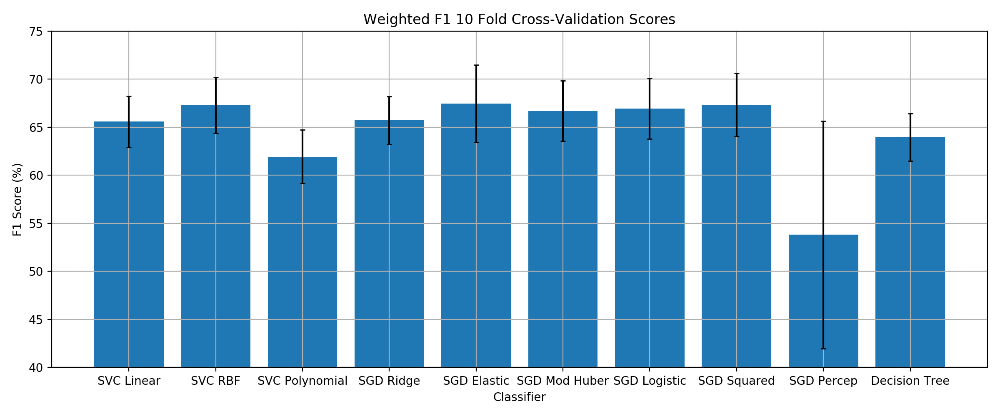

In [3741]:
indices=["SVC Linear","SVC RBF","SVC Polynomial","SGD Ridge","SGD Elastic","SGD Mod Huber","SGD Logistic","SGD Squared","SGD Percep","Decision Tree"]
plt.figure(figsize=(12,5))
plt.title("Weighted F1 10 Fold Cross-Validation Scores")
plt.bar(indices,Results_Table["Validation F1-Score"].values,yerr=Errors_f1,capsize=2)
plt.grid()
plt.xlabel("Classifier")
plt.ylabel("F1 Score (%)")
plt.ylim([40,75])
plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


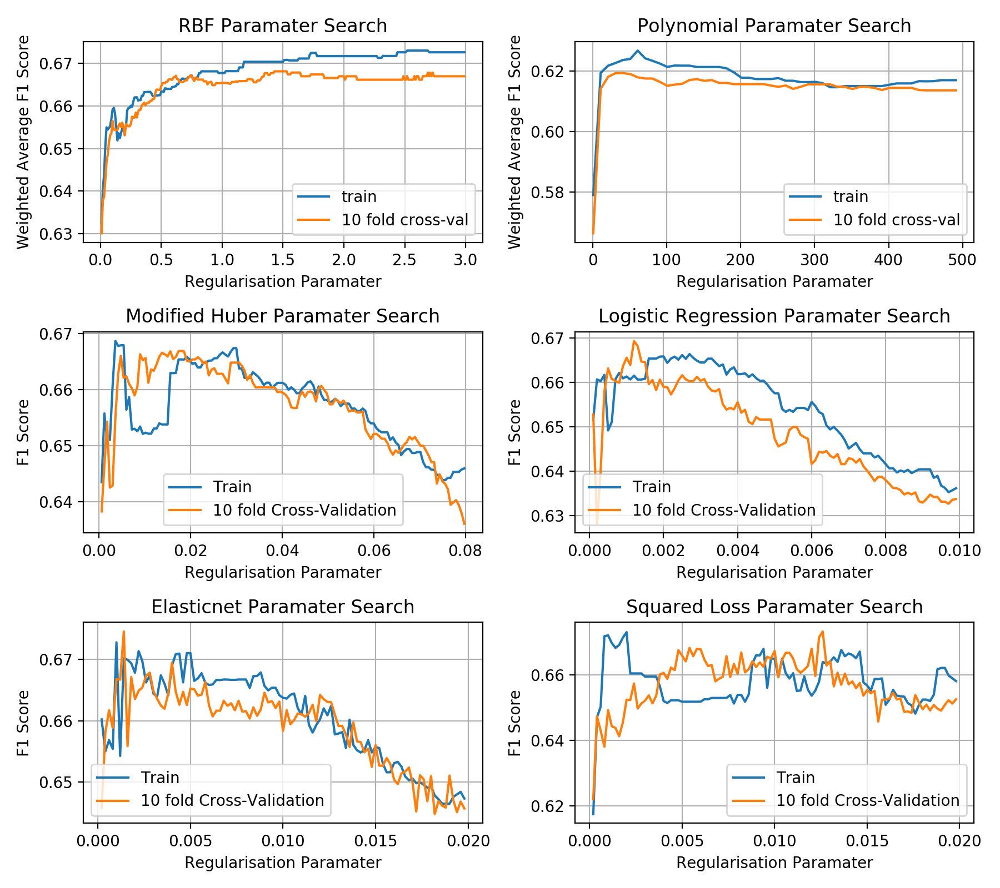

In [2972]:
plt.figure(figsize=(9,8))

plt.subplot(3,2,1)
plt.title("RBF Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs2,train_f1s_2,label="train")
plt.plot(Cs2,val_f1s_2,label="10 fold cross-val")
plt.grid()
plt.legend()

plt.subplot(3,2,2)
plt.title("Polynomial Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs3,train_f1s_3,label="train")
plt.plot(Cs3,val_f1s_3,label="10 fold cross-val")
plt.grid()
plt.legend()

plt.subplot(3,2,3)
plt.title("Modified Huber Paramater Search")
plt.plot(Cs_huber,train_huber,label="Train")
plt.plot(Cs_huber,val_huber,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(3,2,4)
plt.title("Logistic Regression Paramater Search")
plt.plot(Cs_log,train_log,label="Train")
plt.plot(Cs_log,val_log,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(3,2,5)
plt.title("Elasticnet Paramater Search")
plt.plot(Cs_elas,train_elas,label="Train")
plt.plot(Cs_elas,val_elas,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(3,2,6)
plt.title("Squared Loss Paramater Search")
plt.plot(Cs_sq,train_sq,label="Train")
plt.plot(Cs_sq,val_sq,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.tight_layout()
plt.show()

# Extracting Linear Threshold for chosen Classifier

In [2515]:
print(train_scores.columns[4])

MSQ


In [76]:
C_sq=0.012600000000000002
chosen_clf=SGDClassifier(loss="squared_loss",random_state=2,class_weight="balanced",alpha=C_sq).fit(X,y)

In [77]:
coefficients=chosen_clf.coef_
intercepts=chosen_clf.intercept_
print("Coefficients: ",coefficients)
print("Intercepts: ",intercepts)

Coefficients:  [[ 0.86748371 -1.27669843]
 [-0.26330752  2.02026498]
 [-0.36095814 -1.97291746]]
Intercepts:  [-0.12581411 -1.02240841  0.86276226]


In [78]:
line_1_x1=coefficients[0][0]
line_1_x2=coefficients[0][1]
intercept_1=intercepts[0]

line_2_x1=coefficients[1][0]
line_2_x2=coefficients[1][1]
intercept_2=intercepts[1]

line_3_x1=coefficients[2][0]
line_3_x2=coefficients[2][1]
intercept_3=intercepts[2]

In [79]:
skew_range=np.arange(-3.,3.0,0.01)
y_1s=(intercepts[0]+skew_range*line_1_x1)/(-line_1_x2)
y_2s=(intercepts[1]+skew_range*line_2_x1)/(-line_2_x2)
y_3s=(intercepts[2]+skew_range*line_3_x1)/(-line_3_x2)

<IPython.core.display.Javascript object>


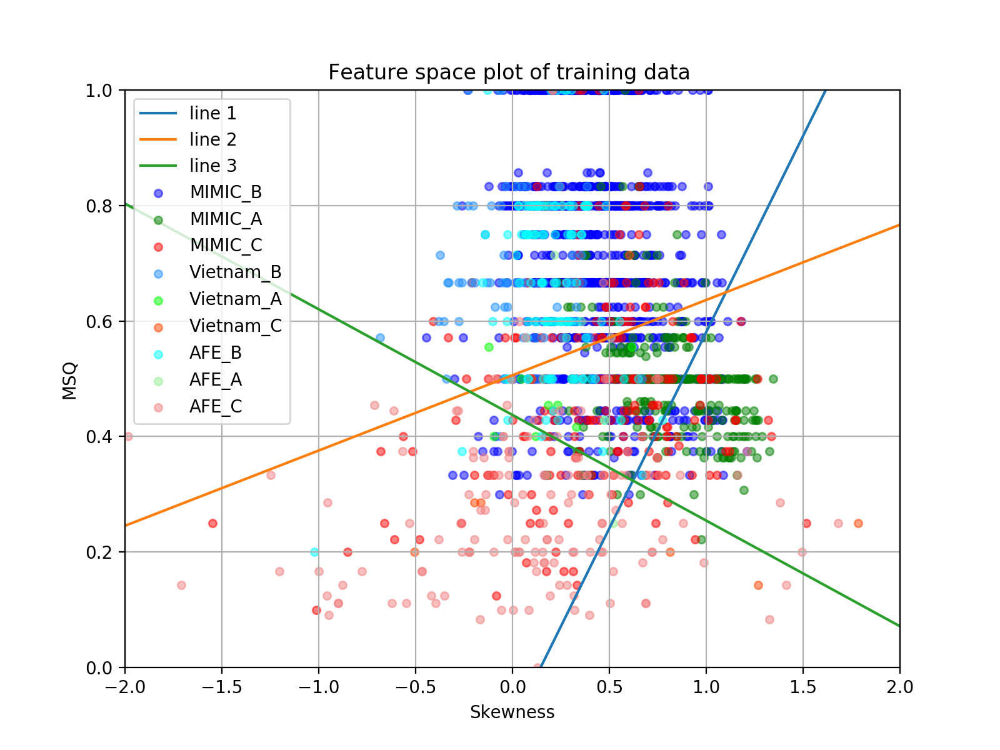

[]

In [83]:

x1="Skewness"
x2="MSQ"
alpha=0.5

ax=MIMIC_B_Scores_train.plot.scatter(x=x1,y=x2,color="blue",alpha=alpha,label="MIMIC_B",figsize=(8,6))
MIMIC_A_Scores_train.plot.scatter(x=x1,y=x2,color="green",alpha=alpha,label="MIMIC_A",ax=ax)
ax=MIMIC_C_Scores_train.plot.scatter(x=x1,y=x2,color="red",alpha=alpha,label="MIMIC_C",ax=ax)

Vietnam_B_Scores_train.plot.scatter(x=x1,y=x2,color="dodgerblue",alpha=alpha,label="Vietnam_B",ax=ax)
Vietnam_A_Scores_train.plot.scatter(x=x1,y=x2,color="lime",alpha=alpha,label="Vietnam_A",ax=ax)
Vietnam_C_Scores_train.plot.scatter(x=x1,y=x2,color="orangered",alpha=alpha,label="Vietnam_C",ax=ax)

AFE_B_Scores_train.plot.scatter(x=x1,y=x2,color="aqua",alpha=alpha,label="AFE_B",ax=ax)
AFE_A_Scores_train.plot.scatter(x=x1,y=x2,color="lightgreen",alpha=alpha,label="AFE_A",ax=ax)
AFE_C_Scores_train.plot.scatter(x=x1,y=x2,color="lightcoral",alpha=alpha,label="AFE_C",ax=ax)

plt.title("Feature space plot of training data ")
plt.xlabel(x1)
plt.ylabel(x2)

plt.grid()

ax.plot(skew_range,y_1s,label="line 1")
ax.plot(skew_range,y_2s,label="line 2")
ax.plot(skew_range,y_3s,label="line 3")
ax.set_ylim([0,1])
ax.set_xlim([-2,2])
plt.legend()
plt.plot()

In [84]:
def predict_sample(sample,coefficients,intercepts):
    Class_0_Score=coefficients[0][0]*sample[0]+coefficients[0][1]*sample[1]+intercepts[0]
    Class_1_Score=coefficients[1][0]*sample[0]+coefficients[1][1]*sample[1]+intercepts[1]
    Class_2_Score=coefficients[2][0]*sample[0]+coefficients[2][1]*sample[1]+intercepts[2]
    Scores=[Class_0_Score,Class_1_Score,Class_2_Score]
    predicted_class=Scores.index(np.max(Scores))
    return predicted_class

def predict_set(X,coefficients,intercepts):
    predictions=[]
    for index in X.index:
        predictions.append(predict_sample(X.loc[index].values,coefficients,intercepts))
    return predictions

In [89]:
train_est=predict_set(X,coefficients,intercepts)
predicted_labels=chosen_clf.predict(X)
test_est=predict_set(X_test,coefficients,intercepts)

print(len(predicted_labels))
print(len(train_est))
print(len(test_est))
print("Train_Report")
print(classification_report(train_est,y,target_names=["A","B","C"]))
print("Test_Report")
print(classification_report(test_est,y_test,target_names=["A","B","C"]))
report=classification_report(test_est,y_test,target_names=["A","B","C"],output_dict=True)
Report=pd.DataFrame.from_dict(report)
Report=Report.apply(percentage)
Report=Report.T
Report.to_csv("Test_Report_3.csv",float_format="%.2f")

1959
1959
1307
Train_Report
              precision    recall  f1-score   support

           A       0.66      0.49      0.56       380
           B       0.86      0.86      0.86      1295
           C       0.50      0.65      0.57       284

    accuracy                           0.76      1959
   macro avg       0.67      0.67      0.66      1959
weighted avg       0.77      0.76      0.76      1959

Test_Report
              precision    recall  f1-score   support

           A       0.57      0.49      0.53       243
           B       0.85      0.83      0.84       853
           C       0.49      0.62      0.55       211

    accuracy                           0.73      1307
   macro avg       0.64      0.65      0.64      1307
weighted avg       0.74      0.73      0.73      1307



In [90]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix
import seaborn as sns

<IPython.core.display.Javascript object>


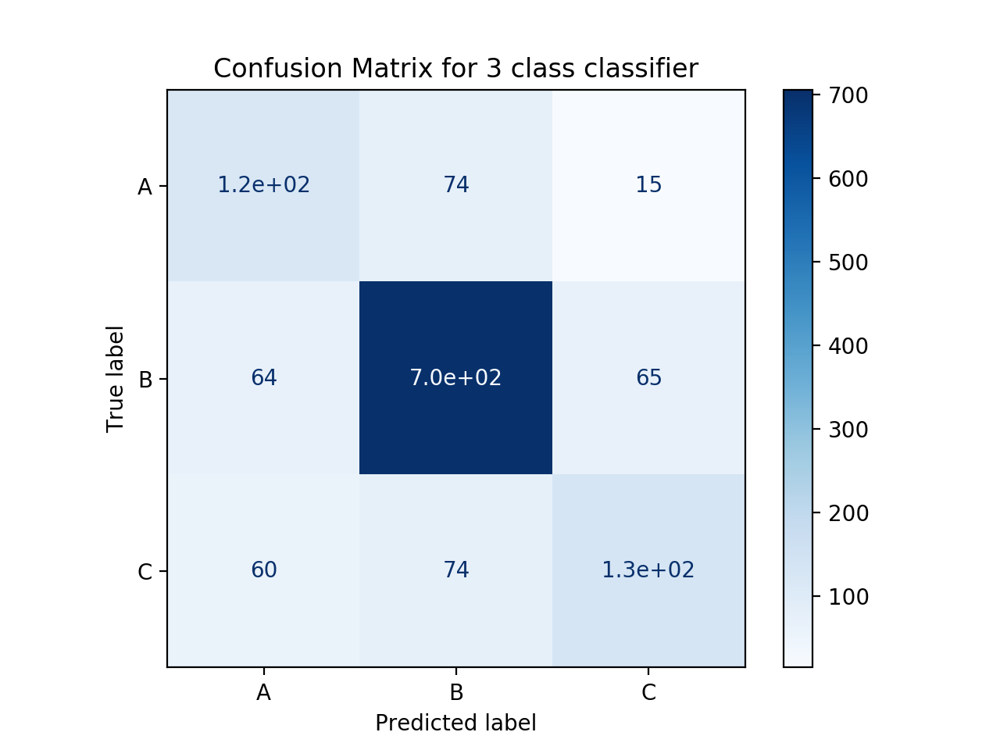

In [91]:
plt.figure()
ax=plt.subplot()
class_names=["A","B","C"]
# cm=confusion_matrix(y_test,test_est)


disp=plot_confusion_matrix(chosen_clf, X_test, y_test,
                                 display_labels=class_names,
                                 cmap=plt.cm.Blues,ax=ax)

plt.title("Confusion Matrix for 3 class classifier")

plt.show()


# Two Class Classifier 

In [189]:
X2 = train_scores[["Skewness","MSQ"]]
y2=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y2.append(0)
    if(label=="B"):
        y2.append(0)
    if(label=="C"):
        y2.append(1)
Xtest2 = test_scores[["Skewness","MSQ"]]
ytest2=[]
for label in test_labels["Label"]:
    if(label=="A"):
        ytest2.append(0)
    if(label=="B"):
        ytest2.append(0)
    if(label=="C"):
        ytest2.append(1)

print("X shape: {}".format(X2.shape))
print("y shape: {}".format(len(y2)))

X shape: (1959, 2)
y shape: 1959


In [190]:
def get_f1_score2(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A&B","C"],output_dict=True)["macro avg"]["f1-score"]

def get_precision_score2(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A&B","C"],output_dict=True)["macro avg"]["precision"]
                                                                                                     
def get_recall_score2(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A&B","C"],output_dict=True)["macro avg"]["recall"] 

# Optimizing Hyper Paramaters

In [468]:
loss="modified_huber"
train_huber_2=[]
val_huber_2=[]
Cs_huber_2=np.arange(0.01,1.0,0.01)

for C in tqdm(Cs_huber_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_huber_2.append(train_r)
    val_huber_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


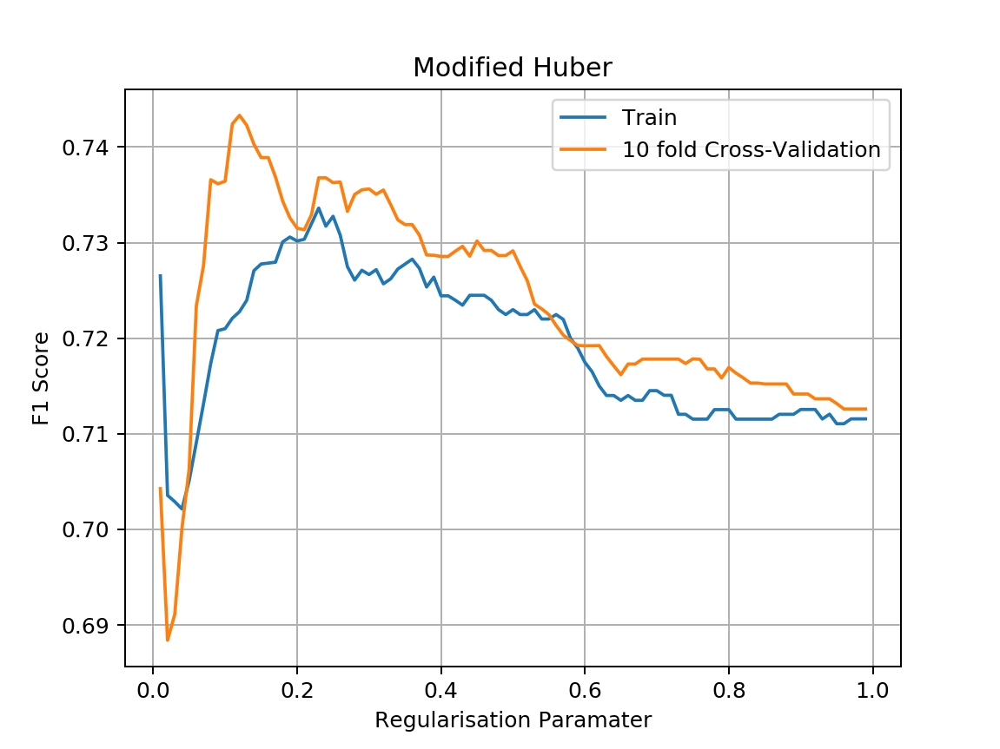

In [469]:
plt.figure()
plt.title("Modified Huber")
plt.plot(Cs_huber_2,train_huber_2,label="Train")
plt.plot(Cs_huber_2,val_huber_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [470]:
index_huber_2=val_huber_2.index(np.max(val_huber_2))
C_huber_2=Cs_huber_2[index_huber_2]
C_huber_2=0.24
print("Huber alpha: ",C_huber_2)

Huber alpha:  0.24


In [471]:
loss="log"
train_log_2=[]
val_log_2=[]
Cs_log_2=np.arange(0.002,.4,0.002)

for C in tqdm(Cs_log_2):
#     print("Regularisation: ",C)
    
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_log_2.append(train_r)
    val_log_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


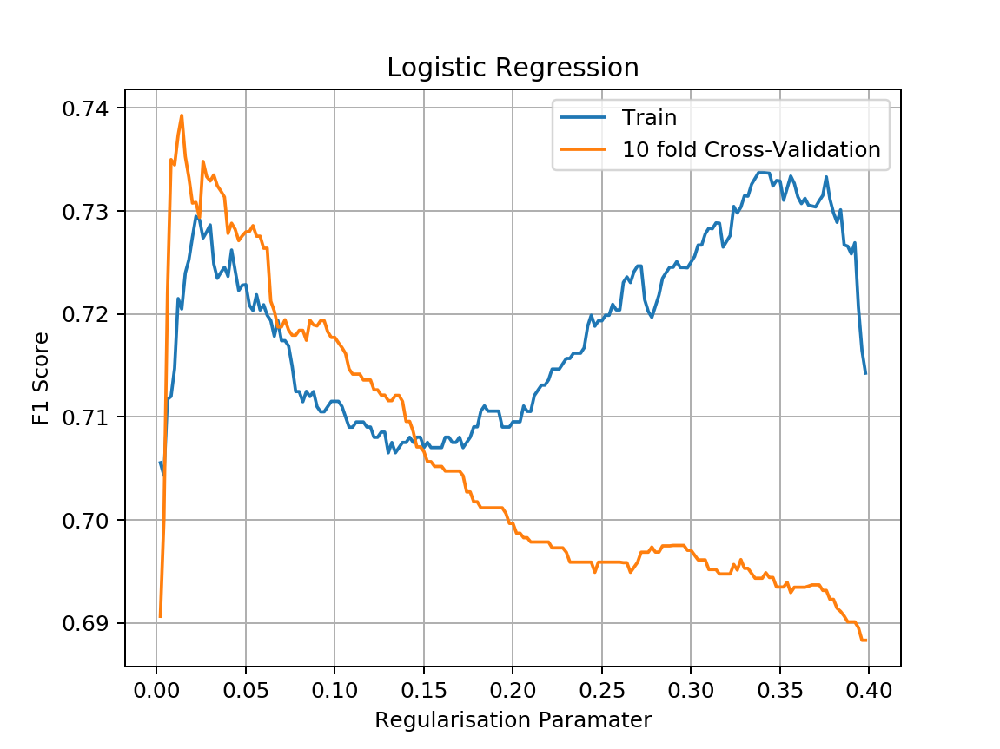

In [483]:
plt.figure()
plt.title("Logistic Regression")
plt.plot(Cs_log_2,train_log_2,label="Train")
plt.plot(Cs_log_2,val_log_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [473]:
index_log_2=val_log_2.index(np.max(val_log_2))
C_log_2=Cs_log_2[index_log_2]
C_log_2=0.026
print("Logistic alpha: ",C_log_2)

Logistic alpha:  0.026


In [474]:
penalty="elasticnet"
train_elas_2=[]
val_elas_2=[]
Cs_elas_2=np.arange(0.003,0.3,0.003)

for C in tqdm(Cs_elas_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(penalty=penalty,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_elas_2.append(train_r)
    val_elas_2.append(val_r)

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


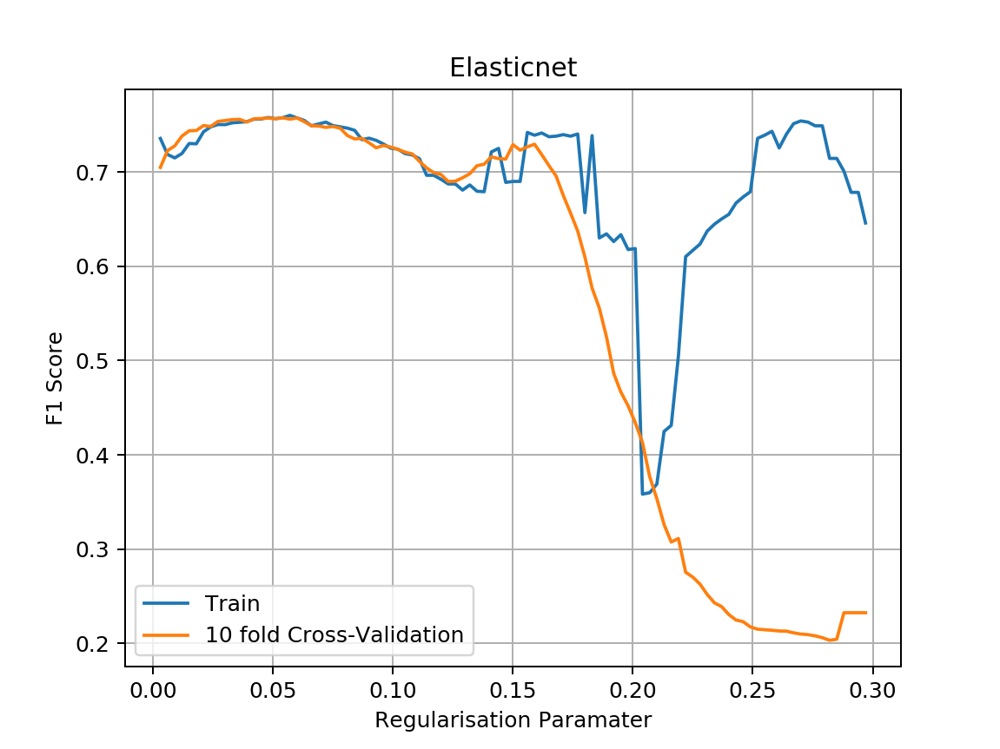

In [475]:
plt.figure()
plt.title("Elasticnet")
plt.plot(Cs_elas_2,train_elas_2,label="Train")
plt.plot(Cs_elas_2,val_elas_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [476]:
index_elas_2=val_elas_2.index(np.max(val_elas_2))
C_elas_2=Cs_elas_2[index_elas_2]
print("Elastic alpha: ",C_elas_2)

Elastic alpha:  0.054000000000000006


In [477]:
loss="squared_loss"
train_sq_2=[]
val_sq_2=[]
Cs_sq_2=np.arange(0.001,.4,0.001)

for C in tqdm(Cs_sq_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_sq_2.append(train_r)
    val_sq_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


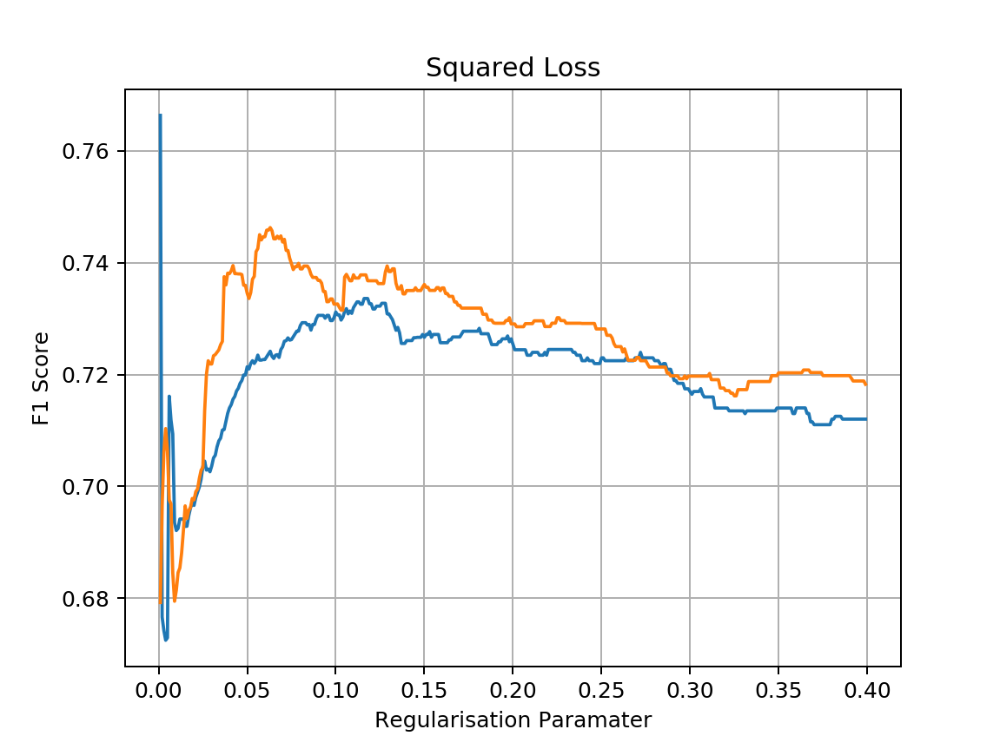

In [478]:
plt.figure()
plt.title("Squared Loss")
plt.plot(Cs_sq_2,train_sq_2,label="Train")
plt.plot(Cs_sq_2,val_sq_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [479]:
index_sq_2=val_sq_2.index(np.max(val_sq_2))
C_sq_2=Cs_sq_2[index_sq_2]
print("squared alpha : ",C_sq_2)

squared alpha :  0.063


In [480]:
train_norm_2=[]
val_norm_2=[]
Cs_norm_2=np.arange(0.001,0.1,0.001)
for C in tqdm(Cs_norm_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_norm_2.append(train_r)
    val_norm_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


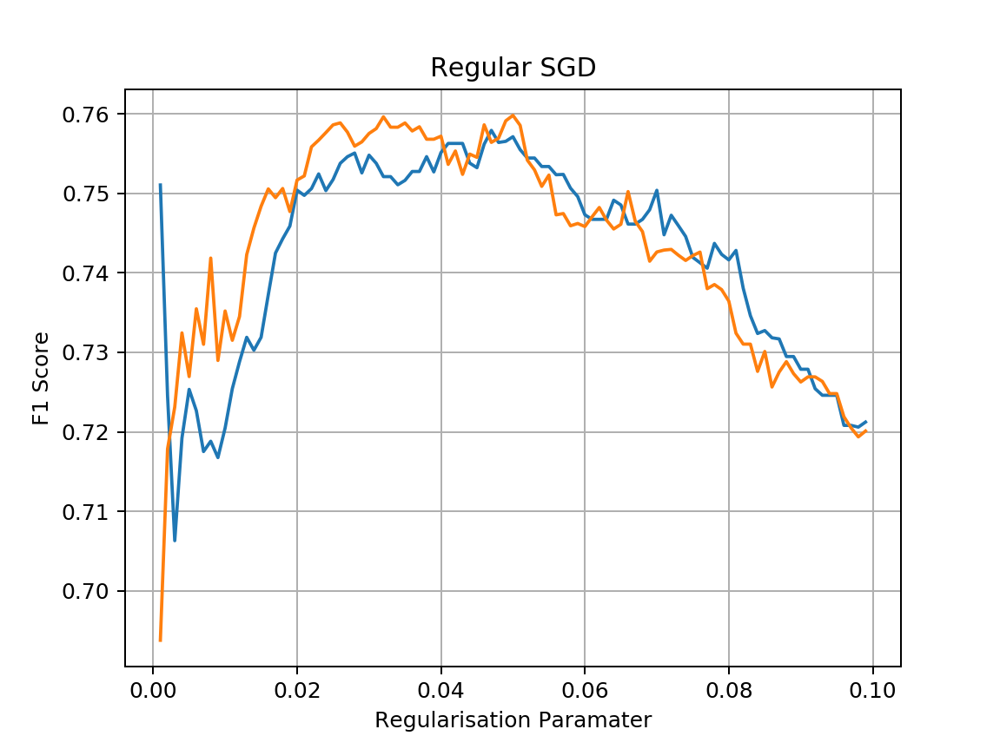

In [481]:
plt.figure()
plt.title("Regular SGD")
plt.plot(Cs_norm_2,train_norm_2,label="Train")
plt.plot(Cs_norm_2,val_norm_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [482]:
index_norm_2=val_norm_2.index(np.max(val_norm_2))
C_norm_2=Cs_norm_2[index_norm_2]
print("Normal alpha: ",C_norm_2)

Normal alpha:  0.05


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


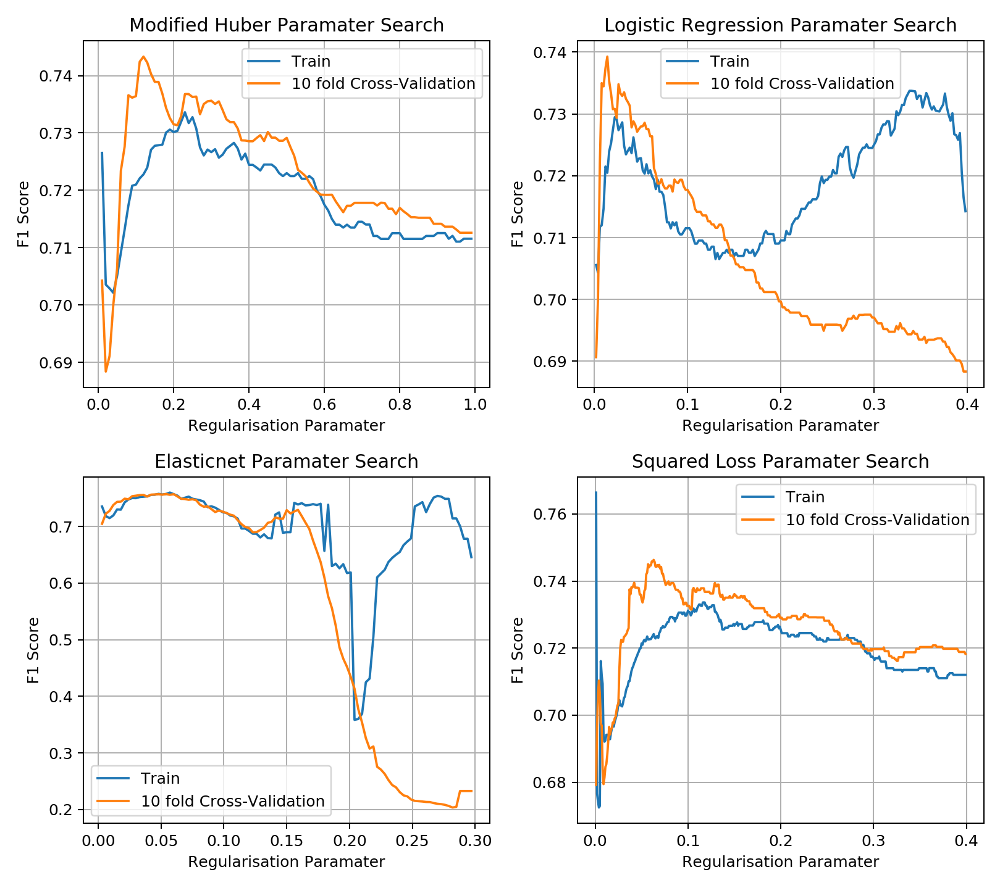

In [484]:
plt.figure(figsize=(9,8))



plt.subplot(2,2,1)
plt.title("Modified Huber Paramater Search")
plt.plot(Cs_huber_2,train_huber_2,label="Train")
plt.plot(Cs_huber_2,val_huber_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(2,2,2)
plt.title("Logistic Regression Paramater Search")
plt.plot(Cs_log_2,train_log_2,label="Train")
plt.plot(Cs_log_2,val_log_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(2,2,3)
plt.title("Elasticnet Paramater Search")
plt.plot(Cs_elas_2,train_elas_2,label="Train")
plt.plot(Cs_elas_2,val_elas_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(2,2,4)
plt.title("Squared Loss Paramater Search")
plt.plot(Cs_sq_2,train_sq_2,label="Train")
plt.plot(Cs_sq_2,val_sq_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.tight_layout()
plt.show()

In [298]:
clf=SGDClassifier(alpha=C_norm_2,class_weight="balanced",random_state=2).fit(X2,y2)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


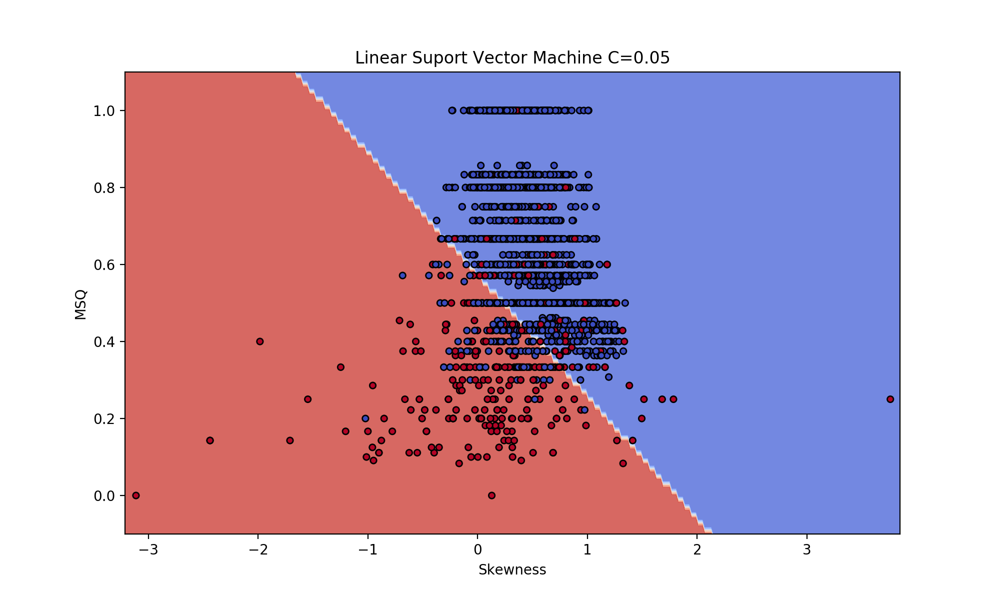

In [299]:
X0, X1 = X2["Skewness"].values, X2["MSQ"].values
fig, sub = plt.subplots(1, 1,figsize=(10,6))
ax = plt.gca()
xx, yy = make_meshgrid(X0, X1)
plot_contours(ax, clf, xx, yy,
              cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
ax.set_xlim(xx.min(), xx.max())
ax.set_ylim(yy.min(), yy.max())
ax.set_xlabel("Skewness")
ax.set_ylabel('MSQ')
ax.set_title("Linear Suport Vector Machine C={}".format(C_norm_2))
plt.show()

In [300]:
train_pred=clf.predict(X2)
train_f1=get_f1_score2(clf,X2,y2)

print("Train f1: ",train_f1)
train_pre=get_precision_score2(clf,X2,y2)

print("Train prec: ",train_pre)
train_rec=get_recall_score2(clf,X2,y2)

print("Train recall: ",train_rec)  

val_f1s= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
val_f1=val_f1s.mean()
stds_err_f1_svm_2=val_f1s.std()


val_pres= cross_val_score(clf, X2, y2,scoring=get_precision_score2, cv=10)
val_pre=val_pres.mean()
stds_err_prec_svm_2=val_pres.std()


val_recs= cross_val_score(clf, X2, y2,scoring=get_recall_score2, cv=10)
val_rec=val_recs.mean()
stds_err_rec_svm_2=val_recs.std()


print("Val f1: {} +- {}".format(val_f1,stds_err_f1_svm_2))
print("Val prec: {} +- {}".format(val_pre,stds_err_prec_svm_2))
print("Val rec: {} +- {}".format(val_rec,stds_err_rec_svm_2))
print("")

Train f1:  0.7571269047593334
Train prec:  0.7526419507492175
Train recall:  0.7619700089761867
Val f1: 0.7598094683759976 +- 0.04870154078990857
Val prec: 0.7552246969355689 +- 0.05147246342913591
Val rec: 0.7665762480922288 +- 0.0481128201239108



In [301]:
columns=["Train Precision","Train Recall","Train F1","Val Precision","Val Recall","Val F1"]
indices=["SVM linear","SGD Ridge","SGD Elasticnet","SGD Modified Huber","SGD Log","SGD Squared Loss","SGD Perceptron"]

Results_Table2=pd.DataFrame(columns=columns,index=indices)
Results_Table2.loc["SVM linear"]=[train_pre*100,train_rec*100,train_f1*100,val_pre*100,val_rec*100,val_f1*100]
Results_Table2
errors_prec2=[]
errors_rec2=[]
errors_f2=[]
errors_prec2.append(stds_err_prec_svm_2)
errors_rec2.append(stds_err_rec_svm_2)
errors_f2.append(stds_err_f1_svm_2)


In [302]:
models4 = [
    RidgeClassifier(random_state=2,class_weight="balanced").fit(X2,y2),
    SGDClassifier(penalty="elasticnet",class_weight="balanced",random_state=2,alpha=C_elas_2).fit(X2,y2),
    SGDClassifier(loss="modified_huber",random_state=2,class_weight="balanced",alpha=C_huber_2).fit(X2,y2),
    SGDClassifier(loss="log",random_state=2,class_weight="balanced",alpha=C_log_2).fit(X2,y2),
    SGDClassifier(loss="squared_loss",random_state=2,class_weight="balanced",alpha=C_sq_2).fit(X2,y2),
    Perceptron(random_state=2,class_weight="balanced").fit(X2,y2),
]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


<IPython.core.display.Javascript object>


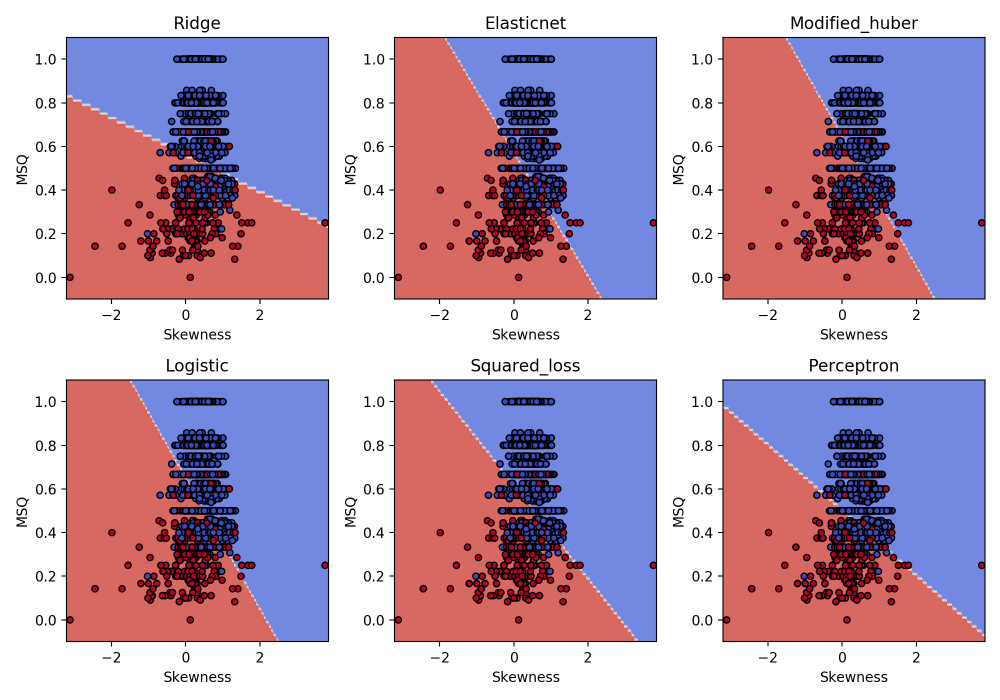

In [303]:
# title for the plots
titles3 = ('Ridge',
          'Elasticnet',
          'Modified_huber',
          'Logistic',
          'Squared_loss',
          'Perceptron',)

# Set-up 2x3 grid for plotting.
fig, sub = plt.subplots(2, 3,figsize=(10,7))
# plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)

# print("titles length: ",len(titles))
# print("models length: ",len(models))
# print("figures length: ",len(sub.flatten()))
colors = "bry"

for clf, title, ax in zip(models4, titles3, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
#     for i, color in zip(clf.classes_, colors):
#         plot_hyperplane(clf.coef_,clf.intercept_,i, color,ax)
    ax.set_xlabel('Skewness')
    ax.set_ylabel('MSQ')
    ax.set_title(title)
plt.tight_layout()
plt.show()

In [304]:
Training_F1s=[]
Training_Precisions=[]
Training_Recals=[]

Validation_F1s=[]
Validation_Precisions=[]
Validation_Recals=[]
stds_err_prec_sgd=[]
stds_err_rec_sgd=[]
stds_err_f1_sgd=[]
for clf,title in zip(models4,titles3):
    print(title)
    train_pred=clf.predict(X2)
    train_f1=get_f1_score2(clf,X2,y2)
    Training_F1s.append(train_f1)
    print("Train f1: ",train_f1)
    train_pre=get_precision_score2(clf,X2,y2)
    Training_Precisions.append(train_pre)
    print("Train prec: ",train_pre)
    train_rec=get_recall_score2(clf,X2,y2)
    Training_Recals.append(train_rec)
    print("Train recall: ",train_rec)  
    
    val_f1s= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_f1=val_f1s.mean()
    val_f1_std=val_f1s.std()
    Validation_F1s.append(val_f1)
    stds_err_f1_sgd.append(val_f1_std)
    
    val_pres= cross_val_score(clf, X2, y2,scoring=get_precision_score2, cv=10)
    val_pre=val_pres.mean()
    val_pre_std=val_pres.std()
    Validation_Precisions.append(val_pre)
    stds_err_prec_sgd.append(val_pre_std)
    
    val_recs= cross_val_score(clf, X2, y2,scoring=get_recall_score2, cv=10)
    val_rec=val_recs.mean()
    val_rec_std=val_recs.std()
    Validation_Recals.append(val_rec)
    stds_err_rec_sgd.append(val_rec_std)
    
    print("Val f1: {} +- {}".format(val_f1,val_f1_std))
    print("Val prec: {} +- {}".format(val_pre,val_pre_std))
    print("Val rec: {} +- {}".format(val_rec,val_rec_std))
    print("")

Ridge
Train f1:  0.6884575292671193
Train prec:  0.7582025229653669
Train recall:  0.6762662078075572
Val f1: 0.6881680019466951 +- 0.0298420223617914
Val prec: 0.7593934770439741 +- 0.045003040852886145
Val rec: 0.6771222871943524 +- 0.02678761023524177

Elasticnet
Train f1:  0.7574960218109702
Train prec:  0.7551107701290678
Train recall:  0.7599798655628475
Val f1: 0.7574313932872252 +- 0.046610905936749415
Val prec: 0.7546892558340901 +- 0.04987442501195119
Val rec: 0.7615938669671272 +- 0.04528436544265623

Modified_huber
Train f1:  0.731724445456089
Train prec:  0.7677340837955828
Train recall:  0.7129068223047685
Val f1: 0.7367813519180569 +- 0.039769539847853204
Val prec: 0.7613141043825619 +- 0.03932655347246357
Val rec: 0.7219334719482106 +- 0.03836255975494284

Logistic
Train f1:  0.727375745526839
Train prec:  0.7673691500268185
Train recall:  0.7082303329940381
Val f1: 0.734806584182764 +- 0.04148775975896037
Val prec: 0.7600522621725467 +- 0.04034930469821833
Val rec: 0.7

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Val f1: 0.6790121533990103 +- 0.18172074273519753
Val prec: 0.7009596157946942 +- 0.0818107205558588
Val rec: 0.7326998742994291 +- 0.23020391532202666



/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [305]:
for t_prec,t_recal,t_f1,v_prec,v_recal,v_f1,title in zip(Training_Precisions,Training_Recals,Training_F1s,Validation_Precisions,Validation_Recals,Validation_F1s,indices[1:]):
    Results_Table2.loc[title]=[t_prec*100,t_recal*100,t_f1*100,v_prec*100,v_recal*100,v_f1*100]

In [306]:
Results_Table2

,Train Precision,Train Recall,Train F1,Val Precision,Val Recall,Val F1
SVM linear,75.2642,76.197,75.7127,75.5225,76.6576,75.9809
SGD Ridge,75.8203,67.6266,68.8458,75.9393,67.7122,68.8168
SGD Elasticnet,75.5111,75.998,75.7496,75.4689,76.1594,75.7431
SGD Modified Huber,76.7734,71.2907,73.1724,76.1314,72.1933,73.6781
SGD Log,76.7369,70.823,72.7376,76.0052,71.9889,73.4807
SGD Squared Loss,77.5444,70.4543,72.4175,77.6959,72.9078,74.6298
SGD Perceptron,76.7025,78.5793,77.5763,70.096,73.27,67.9012


In [307]:
for prec,rec,f1 in zip(stds_err_prec_sgd,stds_err_rec_sgd,stds_err_f1_sgd):
    errors_prec2.append(prec)
    errors_rec2.append(rec)
    errors_f2.append(f1)

In [308]:
Errors_prec=[]
Errors_rec=[]
Errors_f1=[]
for e_prec,e_rec,e_f1 in zip(errors_prec2,errors_rec2,errors_f2):
    Errors_prec.append(e_prec*100)
    Errors_rec.append(e_rec*100)
    Errors_f1.append(e_f1*100)

In [313]:
Results_Table2

,Train Precision,Train Recall,Train F1,Val Precision,Val Recall,Val F1
SVM linear,75.2642,76.197,75.7127,75.5225,76.6576,75.9809
SGD Ridge,75.8203,67.6266,68.8458,75.9393,67.7122,68.8168
SGD Elasticnet,75.5111,75.998,75.7496,75.4689,76.1594,75.7431
SGD Modified Huber,76.7734,71.2907,73.1724,76.1314,72.1933,73.6781
SGD Log,76.7369,70.823,72.7376,76.0052,71.9889,73.4807
SGD Squared Loss,77.5444,70.4543,72.4175,77.6959,72.9078,74.6298
SGD Perceptron,76.7025,78.5793,77.5763,70.096,73.27,67.9012


In [315]:
# indices=["SVC Linear","SVC RBF","SGD Elastic","SGD Mod Huber","SGD Logistic","SGD Squared","SGD Percep","Decision Tree"]
# columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
All_Errors=[Errors_prec,Errors_rec,Errors_f1]
Results_Table_std_2=pd.DataFrame(columns=Results_Table2.columns,index=Results_Table2.index)
for c in Results_Table2.columns[:3]:
    for i in Results_Table2.index:
        Results_Table_std_2[c][i]="{0:2.2f}".format(Results_Table2[c][i])
for c,Errors in zip(Results_Table2.columns[3:],All_Errors):
    for i,Error in zip(Results_Table2.index,Errors):
        Results_Table_std_2[c][i]="{0:2.2f} $\pm$ {1:2.2f}".format(Results_Table2[c][i],Error)
        

In [317]:
Results_Table_std_2.to_csv("Results_Table_2.csv")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


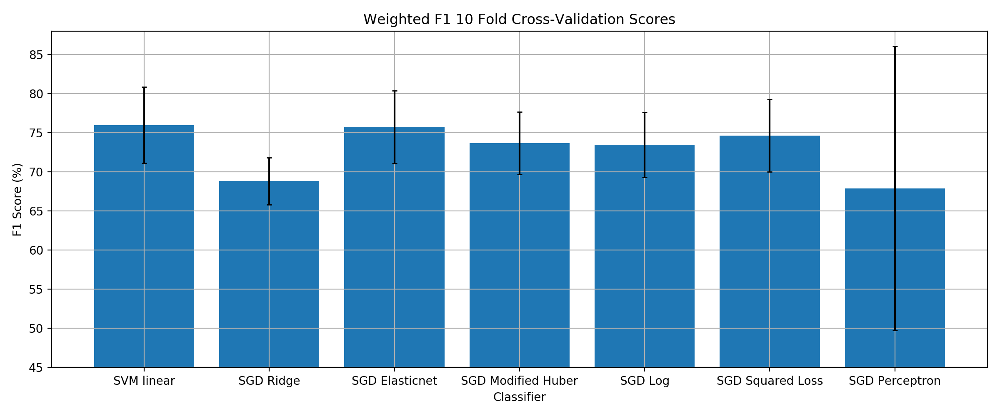

In [328]:
plt.figure(figsize=(12,5))
plt.title("Weighted F1 10 Fold Cross-Validation Scores")
plt.bar(indices,Results_Table2["Val F1"].values,yerr=Errors_f1,capsize=2)
plt.grid()
plt.xlabel("Classifier")
plt.ylabel("F1 Score (%)")
plt.ylim([45,88])
plt.tight_layout()
plt.show()

In [330]:
C_norm_2=0.05
C_sq_2=0.063
chosen_clf_2=SGDClassifier(loss="squared_loss",alpha=C_sq_2,class_weight="balanced",random_state=2).fit(X2,y2)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


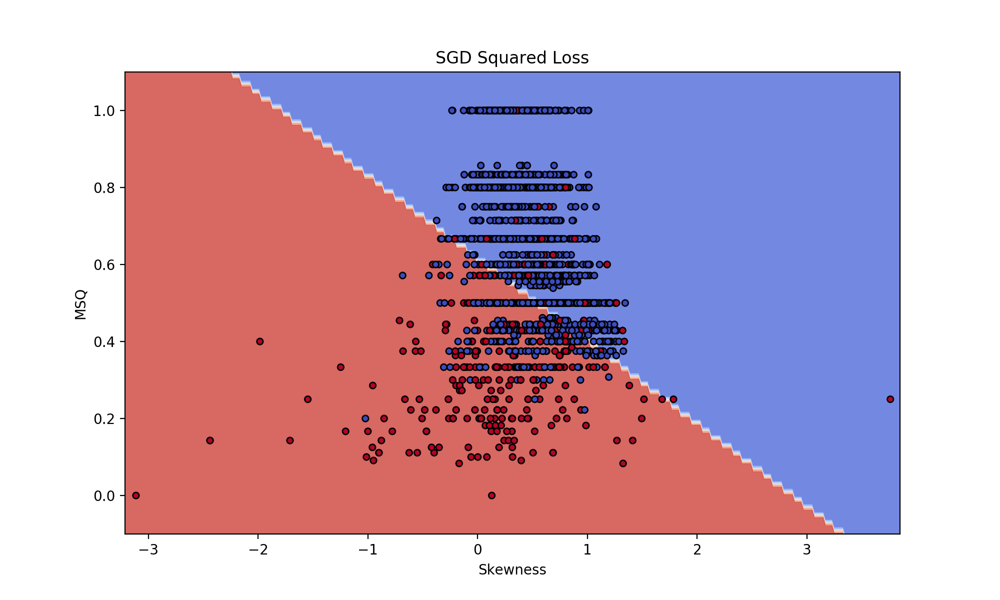

In [336]:
X0, X1 = X2["Skewness"].values, X2["MSQ"].values
fig, sub = plt.subplots(1, 1,figsize=(10,6))
ax = plt.gca()
xx, yy = make_meshgrid(X0, X1)
plot_contours(ax, chosen_clf_2, xx, yy,
              cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
ax.set_xlim(xx.min(), xx.max())
ax.set_ylim(yy.min(), yy.max())
ax.set_xlabel("Skewness")
ax.set_ylabel('MSQ')
ax.set_title("SGD Squared Loss")
plt.show()

In [333]:
train_pred=chosen_clf_2.predict(X2)
train_f1=get_f1_score2(chosen_clf_2,X2,y2)

print("Train f1: ",train_f1)
train_pre=get_precision_score2(chosen_clf_2,X2,y2)

print("Train prec: ",train_pre)
train_rec=get_recall_score2(chosen_clf_2,X2,y2)

print("Train recall: ",train_rec)  

val_f1s= cross_val_score(chosen_clf_2, X2, y2,scoring=get_f1_score2, cv=10)
val_f1=val_f1s.mean()
stds_err_f1_2=val_f1s.std()


val_pres= cross_val_score(chosen_clf_2, X2, y2,scoring=get_precision_score2, cv=10)
val_pre=val_pres.mean()
stds_err_prec_2=val_pres.std()


val_recs= cross_val_score(chosen_clf_2, X2, y2,scoring=get_recall_score2, cv=10)
val_rec=val_recs.mean()
stds_err_rec_2=val_recs.std()


print("Val f1: {} +- {}".format(val_f1,stds_err_f1_2))
print("Val prec: {} +- {}".format(val_pre,stds_err_prec_2))
print("Val rec: {} +- {}".format(val_rec,stds_err_rec_2))
print("")

Train f1:  0.7241754814332945
Train prec:  0.7754435218315262
Train recall:  0.7045429336344982
Val f1: 0.7462982447246475 +- 0.046219502329059796
Val prec: 0.7769593176196321 +- 0.04762572607617466
Val rec: 0.729077912137674 +- 0.04366245112581116



In [166]:

def predict_sample_2(sample,coefficients,intercepts):
    Score1=coefficients[0][0]*sample[0]+coefficients[0][1]*sample[1]+intercepts[0]
    Scores=[0,Score1]
    return Scores.index(np.max(Scores))

def predict_set_2(X2,coefficients,intercepts):
    predictions=[]
    for index in X2.index:
        predictions.append(predict_sample_2(X2.loc[index].values,coefficients,intercepts))
    return predictions

In [334]:
coefficients_2=chosen_clf_2.coef_
intercepts_2=chosen_clf_2.intercept_
train_pred=chosen_clf_2.predict(X2)
train_est=predict_set_2(X2,coefficients_2,intercepts_2)

In [335]:
print(coefficients_2)
print(intercepts_2)

[[-0.23720892 -1.10489991]]
[0.68119408]


In [172]:
test_pred=chosen_clf_2.predict(Xtest2)
train_pred=chosen_clf_2.predict(X2)
print(classification_report(train_pred,y2,target_names=["AB","C"]))
print(classification_report(test_pred,ytest2,target_names=["AB","C"]))

report2=classification_report(test_pred,ytest2,target_names=["AB","C"],output_dict=True)
Report2=pd.DataFrame.from_dict(report2)
Report2=Report2.apply(percentage)
Report2=Report2.T
Report2.to_csv("Test_Report_2.csv",float_format="%.2f")

              precision    recall  f1-score   support

          AB       0.91      0.91      0.91      1605
           C       0.59      0.62      0.60       354

    accuracy                           0.85      1959
   macro avg       0.75      0.76      0.76      1959
weighted avg       0.86      0.85      0.85      1959

              precision    recall  f1-score   support

          AB       0.91      0.89      0.90      1061
           C       0.58      0.62      0.60       246

    accuracy                           0.84      1307
   macro avg       0.74      0.76      0.75      1307
weighted avg       0.85      0.84      0.85      1307



In [ ]:
plt.figure()
ax=plt.subplot()
class_names=["AB","C"]
# cm=confusion_matrix(y_test,test_est)


disp=plot_confusion_matrix(chosen_clf_2, Xtest2, ytest2,
                                 display_labels=class_names,
                                 cmap=plt.cm.Blues,ax=ax)

plt.title("Confusion matrix for two class classifier")

plt.show()

# Timing Tests:

In [176]:
lowcut=0.5
highcut=30
fs=125
b , a = butter_bandpass(lowcut, highcut, fs, order=4)

def classify_from_raw3(raw_sig,b,a,coefficients,intercepts):
    detrend_sig=detrend(filt_pipeline(raw_sig,b,a,period=375))
    tmp_sk = analysis.skew1(detrend_sig)
    tmp_msq = get_msq(detrend_sig)
    tmp_class=predict_sample([tmp_sk,tmp_msq],coefficients,intercepts)
    return tmp_class

def classify_from_raw2(raw_sig,b,a,coefficients,intercepts):
    detrend_sig=detrend(filt_pipeline(raw_sig,b,a,period=375))
    tmp_sk = analysis.skew1(detrend_sig)
    tmp_msq = get_msq(detrend_sig)
    tmp_class=predict_sample_2([tmp_sk,tmp_msq],coefficients,intercepts)
    return tmp_class




In [110]:
Vietnam_Raw_Data.columns=["Vietnam_{}".format(i) for i in range(len(Vietnam_Raw_Data.columns))]
MIMIC_Raw_Data.columns=["MIMIC_{}".format(i) for i in range(len(MIMIC_Raw_Data.columns))]

In [155]:
rand_MIMIC_List=random.sample(list(MIMIC_Raw_Data.columns),10)
rand_Vietnam_List=random.sample(list(Vietnam_Raw_Data.columns),10)
rand_Omar_List=random.sample(list(Omar_Raw_Data.columns),10)
rand_Stefan_List=random.sample(list(Stefan_Raw_Data.columns),10)
print("MIMIC: ",rand_MIMIC_List)
print("Vietnam: ",rand_Vietnam_List)
print("Omar: ",rand_Omar_List)
print("Stefan: ",rand_Stefan_List)
All_Lists=[rand_MIMIC_List,rand_Vietnam_List,rand_Omar_List,rand_Stefan_List]
All_Data=[MIMIC_Raw_Data,Vietnam_Raw_Data,Omar_Raw_Data,Stefan_Raw_Data]

MIMIC:  ['MIMIC_2388', 'MIMIC_2104', 'MIMIC_430', 'MIMIC_2237', 'MIMIC_1672', 'MIMIC_1376', 'MIMIC_1429', 'MIMIC_1495', 'MIMIC_2346', 'MIMIC_2355']
Vietnam:  ['Vietnam_126', 'Vietnam_33', 'Vietnam_57', 'Vietnam_70', 'Vietnam_58', 'Vietnam_43', 'Vietnam_91', 'Vietnam_36', 'Vietnam_120', 'Vietnam_81']
Omar:  ['Omar_15', 'Omar_207', 'Omar_103', 'Omar_29', 'Omar_291', 'Omar_163', 'Omar_124', 'Omar_129', 'Omar_290', 'Omar_222']
Stefan:  ['Stefan_Wrist LED 2_2', 'Stefan_57', 'Stefan_43', 'Stefan_37', 'Stefan_Wrist LED 3_14', 'Stefan_Wrist LED 2_0', 'Stefan_26', 'Stefan_30', 'Stefan_Finger LED 2_0', 'Stefan_45']


In [181]:
lowcut=0.5
highcut=30
coefficients=chosen_clf.coef_
intercepts=chosen_clf.intercept_
test_time=[]
test_dev=[]
with tqdm(total=40) as pbar:
    for List,Raw_Data in zip(All_Lists,All_Data):
        fs=Raw_Data[List[0]].shape[0]/3
        b , a = butter_bandpass(lowcut, highcut, fs, order=4)
        for sample in List:
            t=%timeit -o -q -p 5 -r 20 classify_from_raw3(Raw_Data[sample].values,b,a,coefficients,intercepts)
            test_time.append(t.average)
            test_dev.append(t.stdev**2)
            pbar.update(1)

In [182]:
lowcut=0.5
highcut=30
coefficients=chosen_clf_2.coef_
intercepts=chosen_clf_2.intercept_
test_time2=[]
test_dev2=[]
with tqdm(total=40) as pbar:
    for List,Raw_Data in zip(All_Lists,All_Data):
        fs=Raw_Data[List[0]].shape[0]/3
        b , a = butter_bandpass(lowcut, highcut, fs, order=4)
        for sample in List:
            t=%timeit -o -q -p 5 -r 20 classify_from_raw2(Raw_Data[sample].values,b,a,coefficients,intercepts)
            test_time2.append(t.average)
            test_dev2.append(t.stdev**2)
            pbar.update(1)

<IPython.core.display.Javascript object>


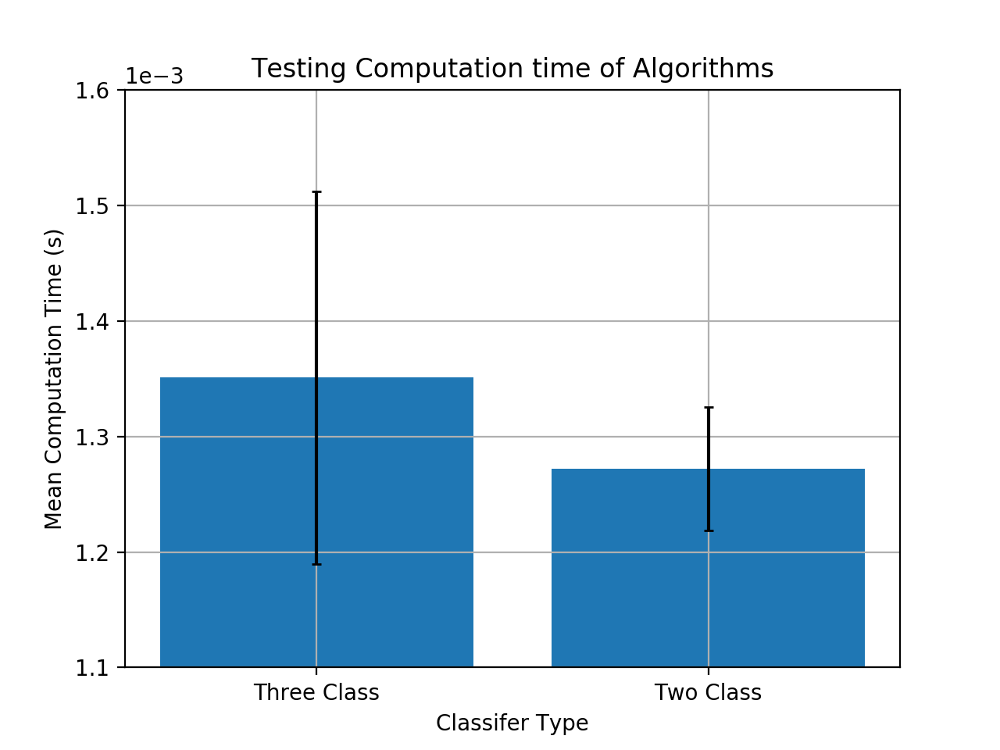

(0.0011, 0.0016)

In [188]:
Time1=np.mean(test_time)
Dev1=np.sqrt(np.mean(test_dev))
Time2=np.mean(test_time2)
Dev2=np.sqrt(np.mean(test_dev2))
plt.figure()
plt.ticklabel_format(axis="y", style="sci",scilimits=(-3,-3))
plt.bar(["Three Class","Two Class"],[Time1,Time2],yerr=[Dev1,Dev2],capsize=2)
plt.xlabel("Classifer Type")
plt.ylabel("Mean Computation Time (s)")
plt.title("Testing Computation time of Algorithms")
plt.grid()
plt.ylim([0.0011,0.0016])

# Classifier:

In [1189]:
import sklearn.svm as svm
from sklearn.utils import shuffle
from  sklearn.model_selection import train_test_split

In [ ]:
All_Scores=pd.concat([Full_Scores,AFE_Scores,Stefan_Scores])
All_labels=pd.concat([Full_labels,AFE_labels,Stefan_labels])

## Linear Classification:

In [ ]:
good_predicted=[]
bad_predicted=[]
for col in All_Scores.index:
    print(All_Scores["Skewness"][col])
    print(All_Scores["MSQ"][col])
    if All_Scores["Skewness"][col]>0.0 and All_Scores["MSQ"][col]>0.5:
        good_predicted.append(col)
    else:
        bad_predicted.append(col)

In [ ]:
len(good_predicted)

In [ ]:
len(bad_predicted)

In [ ]:
All_Data = pd.concat([Full_Data,AFE_Filtered_Data],axis=1)
num_1 = random.sample(list(good_predicted),1)
num_2 = random.sample(list(bad_predicted),1)
print(num_1[0])
print(num_2[0])
fig, (ax1, ax2) = plt.subplots(1, 2)
All_Data[num_1[0]].plot(ax=ax1)
ax1.title.set_text('Good Sample')
All_Data[num_2[0]].plot(ax=ax2)
ax2.title.set_text('Bad Sample')
plt.show()

In [ ]:
X=All_Scores
y = []
for label in All_labels["Label"]:
    if(label=="A"):
        y.append(0)
    if(label=="B"):
        y.append(1)
    if(label=="C"):
        y.append(2)

In [ ]:
def predict(Scores,sk,msq):
    predictions=[]
    for col in Scores.index:
        if Scores["Skewness"][col]>sk and Scores["MSQ"][col]>msq:
            predictions.append(0)
        else:
            predictions.append(1)
    return predictions

def predict3(Scores,sk1,sk2,msq):
    predictions=[]
    for col in Scores.index:
        if  Scores["MSQ"][col]>msq:
            if Scores["Skewness"][col]>sk1:
                predictions.append(0)
            elif Scores["Skewness"][col]>sk2:
                predictions.append(1)
            else:
                predictions.append(2)
        else:
            predictions.append(2)
    return predictions

def acc(pred,y):
    correct=0
    for i in range(len(pred)):
        if pred[i]==y[i]:
            correct+=1
    return correct/len(y)

def get_accuracy_3class(pred,y):
    As= [i for i in range(len(y)) if y[i]==0]
    Bs= [i for i in range(len(y)) if y[i]==1]
    Cs= [i for i in range(len(y)) if y[i]==2]
    a=0
    b=0
    c=0
    for p,label in zip(pred,y):
        if label==0:
            if p==label:
                a+=1
        elif label==1:
            if p==label:
                b+=1
        elif label ==2:
            if p==label:
                c+=1
    return a/len(As), b/len(Bs) , c/len(Cs)
                
def get_accuracy_2class(pred,y):
    zeros= [i for i in range(len(y)) if y[i]==0]
    ones= [i for i in range(len(y)) if y[i]==1]
    zero=0
    one=0
    for p,label in zip(pred,y):
        if label==0:
            if p==label:
                zero+=1
        elif label==1:
            if p==label:
                one+=1
    return zero/len(zeros),one/len(ones)   

In [ ]:
# pred = predict3(All_Scores,0.58,0.37,0.4)
pred = predict3(All_Scores,0.58,0.37,0.4)
print("pred length: ",len(pred))
print("y length: ",len(y))
get_accuracy_3class(pred,y)
# print("Bad Sample accuracy: {} , Good Sample accuracy: {} ".format(accs[0],accs[1]))

## SVM Classifier

In [192]:
from sklearn.model_selection import cross_val_score

### Functions required:

In [97]:
def make_meshgrid(x, y, h=.02):
    """Create a mesh of points to plot in

    Parameters
    ----------
    x: data to base x-axis meshgrid on
    y: data to base y-axis meshgrid on
    h: stepsize for meshgrid, optional

    Returns
    -------
    xx, yy : ndarray
    """
    x_min, x_max = x.min()-0.1, x.max()+0.1 
    y_min, y_max = y.min()-0.1, y.max()+0.1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))
    return xx, yy

def plot_contours(ax, clf, xx, yy, **params):
    """Plot the decision boundaries for a classifier.

    Parameters
    ----------
    ax: matplotlib axes object
    clf: a classifier
    xx: meshgrid ndarray
    yy: meshgrid ndarray
    params: dictionary of params to pass to contourf, optional
    """
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    out = ax.contourf(xx, yy, Z, **params)
    return out

## 3 Classes 

In [3607]:
train_scores

,Skewness,Kurtosis,Entropy,Zeros,MSQ,SNR,Relative_Power,mean_Skewness,mean_Kurtosis,mean_Entropy,...,median_Relative_Power,std_Skewness,std_Kurtosis,std_Entropy,std_SNR,std_Relative_Power,AC_loc1,AC_peak1,AC_loc2,AC_peak2
MIMIC_775,0.545448,-0.898156,5.780437,0.024000,1.000000,3.551156,0.761015,0.410386,-1.168065,4.291057,...,0.732170,0.123350,0.024478,0.020954,0.472194,0.010570,84,0.953156,167,0.950075
MIMIC_2390,1.204559,0.389113,5.645754,0.032000,1.000000,2.488205,0.385338,-0.062777,-1.204585,3.606587,...,0.000000,0.310758,0.409953,0.127941,1.059750,0.000000,45,0.080761,90,0.952044
Vietnam_75,0.116644,-0.880757,5.728975,0.026667,0.800000,3.203567,0.735511,-0.011650,-0.986398,4.178711,...,0.599274,0.147646,0.146306,0.036168,0.390984,0.070164,76,0.908330,153,0.881144
MIMIC_427,-0.009536,-1.002045,5.786584,0.021333,1.000000,3.632957,0.770833,0.007671,-1.255974,4.323768,...,0.786804,0.006310,0.056395,0.023373,0.138471,0.019505,88,0.893703,176,0.860756
MIMIC_2501,0.671354,-0.881972,5.572505,0.018667,0.600000,3.910750,0.839731,0.335166,-1.313604,4.327847,...,0.721032,0.139687,0.037554,0.026005,0.870442,0.019299,101,0.804259,201,0.933360
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MIMIC_2384,0.965816,0.350812,5.821468,0.040000,1.000000,2.396235,0.354742,0.046053,-0.903834,3.865477,...,0.000000,0.613373,0.545598,0.266520,1.370102,0.177225,44,0.104821,91,0.706712
Vietnam_3,0.330471,-0.556068,5.729151,0.034667,0.833333,2.749334,0.661860,0.026059,-0.840212,3.921391,...,0.463966,0.309233,0.058224,0.296948,0.688339,0.212942,34,-0.256934,71,0.797641
MIMIC_1996,0.233650,-1.250471,5.719109,0.026667,0.800000,4.283399,0.832988,0.385161,-1.249358,4.200767,...,0.622902,0.059401,0.156065,0.106300,1.008330,0.044194,85,0.920905,171,0.876589
MIMIC_1975,0.377820,-1.047009,5.675620,0.024000,1.000000,3.746100,0.797228,0.342783,-1.245525,4.244122,...,0.704512,0.049739,0.177481,0.056944,1.328572,0.078931,85,0.795931,169,0.769537


In [2040]:
scaler.fit(train_scores)
train_scaled_scores = scaler.transform(train_scores)
train_scaled_scores = pd.DataFrame(train_scaled_scores,columns=train_scores.columns,index=train_scores.index)
test_scaled_scores= scaler.transform(test_scores)
test_scaled_scores = pd.DataFrame(test_scaled_scores,columns=test_scores.columns,index=test_scores.index)

In [72]:
X = train_scores[["Skewness","MSQ"]]
y=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y.append(0)
    if(label=="B"):
        y.append(1)
    if(label=="C"):
        y.append(2)

X_test = test_scores[["Skewness","MSQ"]]
y_test=[]
for label in test_labels["Label"]:
    if(label=="A"):
        y_test.append(0)
    if(label=="B"):
        y_test.append(1)
    if(label=="C"):
        y_test.append(2)
print("X shape: {}".format(X.shape[0]))
print("y shape: {}".format(len(y)))

X shape: 1959
y shape: 1959


In [73]:
def get_f1_score(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A","B","C"],output_dict=True)["macro avg"]["f1-score"]

def get_precision_score(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A","B","C"],output_dict=True)["macro avg"]["precision"]
                                                                                                     
def get_recall_score(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A","B","C"],output_dict=True)["macro avg"]["recall"] 

In [3769]:
train_f1s_1=[]
val_f1s_1=[]
Cs=np.arange(1.0,100.0,1.0)

for C in tqdm(Cs):
    print("Regularisation: ",C)
    
    clf=svm.SVC(kernel='linear', C=C ,class_weight="balanced",random_state=2).fit(X,y)
    
    train_r=get_f1_score(clf,X,y)
    print("Train f1: ",train_r)
    val_rs= cross_val_score(svm.SVC(kernel='linear', C=C,class_weight="balanced",random_state=2), X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
    print("Val f1: ",val_r)
    train_f1s_1.append(train_r)
    val_f1s_1.append(val_r)
    print("")


Regularisation:  1.0
Train f1:  0.6517606777461045
Val f1:  0.6514301088975262

Regularisation:  2.0
Train f1:  0.6523973701498321
Val f1:  0.6522252306238225

Regularisation:  3.0
Train f1:  0.6531044117015735
Val f1:  0.6526651550977904

Regularisation:  4.0
Train f1:  0.6523891123967682
Val f1:  0.6540850124551959

Regularisation:  5.0
Train f1:  0.6534459394520001
Val f1:  0.6549522681081983

Regularisation:  6.0
Train f1:  0.6537644501689764
Val f1:  0.6549522681081983

Regularisation:  7.0
Train f1:  0.6538007870758348
Val f1:  0.6553144002868746

Regularisation:  8.0
Train f1:  0.6541536419703039
Val f1:  0.6553144002868746

Regularisation:  9.0
Train f1:  0.6541536419703039
Val f1:  0.6547155272813379

Regularisation:  10.0
Train f1:  0.6541536419703039
Val f1:  0.6543762417705492

Regularisation:  11.0
Train f1:  0.6543746567257163
Val f1:  0.6543762417705492

Regularisation:  12.0
Train f1:  0.6543746567257163
Val f1:  0.6548106306725997

Regularisation:  13.0
Train f1:  0.65

<IPython.core.display.Javascript object>


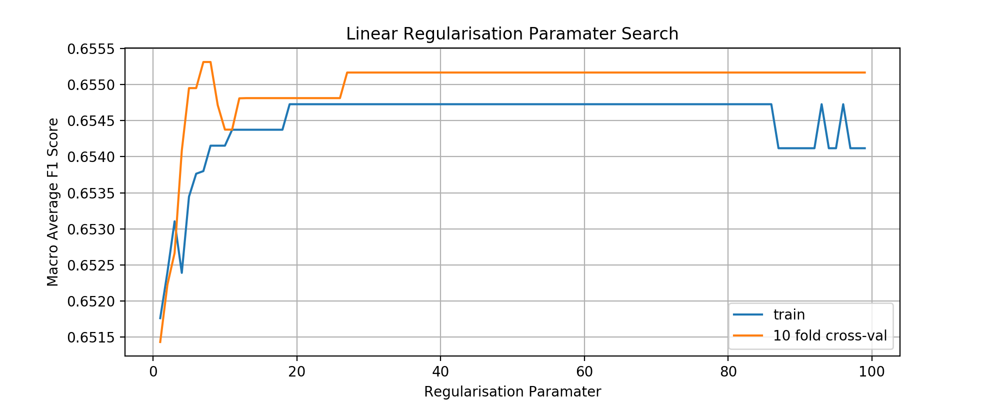

In [3770]:
plt.figure(figsize=(10,4))
plt.title("Linear Regularisation Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Macro Average F1 Score")
plt.plot(Cs,train_f1s_1,label="train")
plt.plot(Cs,val_f1s_1,label="10 fold cross-val")
plt.grid()
plt.legend()
plt.show()

In [3681]:
np.max(val_f1s_1)
index=val_f1s_1.index(np.max(val_f1s_1))
print(Cs[index])
C_linear=Cs[index]

43.0


In [3672]:
C_linear=Cs[index]

In [3682]:
clf = svm.SVC(kernel='linear',class_weight="balanced",C=C_linear).fit(X,y)

<IPython.core.display.Javascript object>


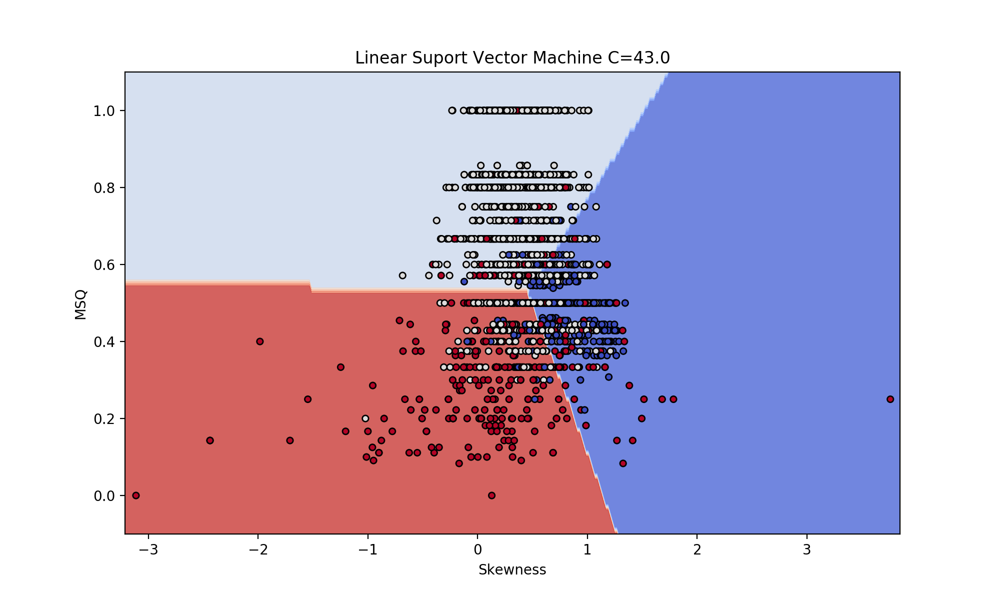

In [3683]:
X0, X1 = X["Skewness"].values, X["MSQ"].values
fig, sub = plt.subplots(1, 1,figsize=(10,6))
ax = plt.gca()
xx, yy = make_meshgrid(X0, X1)
plot_contours(ax, clf, xx, yy,
              cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
ax.set_xlim(xx.min(), xx.max())
ax.set_ylim(yy.min(), yy.max())
ax.set_xlabel("Skewness")
ax.set_ylabel('MSQ')
ax.set_title("Linear Suport Vector Machine C={}".format(C_linear))
plt.show()

In [2082]:
dict_models=[{"classifier":svm.SVC,"kernel":"linear"},
             {"classifier":svm.SVC,"kernel":"rbf"},
#              {"classifier":svm.SVC,"kernel":"poly"},
            ]

In [3675]:
train_f1s_2=[]
val_f1s_2=[]
Cs2=np.arange(0.01,3.0,0.01)

for C in tqdm(Cs2):
    print("Regularisation: ",C)
    
    clf=svm.SVC(kernel='rbf', C=C ,class_weight="balanced",random_state=2).fit(X,y)
    
    train_r=get_f1_score(clf,X,y)
    print("Train f1: ",train_r)
    val_rs= cross_val_score(svm.SVC(kernel='rbf', C=C,class_weight="balanced",random_state=2), X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
    print("Val f1: ",val_r)
    train_f1s_2.append(train_r)
    val_f1s_2.append(val_r)
    print("")


Regularisation:  0.01
Train f1:  0.632471581884753
Val f1:  0.6310585644298445

Regularisation:  0.02
Train f1:  0.6406529226402641
Val f1:  0.638896281396092

Regularisation:  0.03
Train f1:  0.6438040562899766
Val f1:  0.6388006959249245

Regularisation:  0.04
Train f1:  0.6504289554356165
Val f1:  0.6414265186215631

Regularisation:  0.05
Train f1:  0.6549996848611243
Val f1:  0.6496295405994545

Regularisation:  0.060000000000000005
Train f1:  0.6544790776335704
Val f1:  0.6509744439341896

Regularisation:  0.06999999999999999
Train f1:  0.6548281511541524
Val f1:  0.652699302539723

Regularisation:  0.08
Train f1:  0.655331866781475
Val f1:  0.6529458598561708

Regularisation:  0.09
Train f1:  0.6569893885054453
Val f1:  0.6534736313501817

Regularisation:  0.09999999999999999
Train f1:  0.6591724341624889
Val f1:  0.6546264563834608

Regularisation:  0.11
Train f1:  0.6595676573853594
Val f1:  0.6538412075792316

Regularisation:  0.12
Train f1:  0.6582177845860187
Val f1:  0.6548

Val f1:  0.6680427014311416

Regularisation:  0.99
Train f1:  0.6677560182684158
Val f1:  0.6680427014311416

Regularisation:  1.0
Train f1:  0.6677560182684158
Val f1:  0.6687834446951918

Regularisation:  1.01
Train f1:  0.6677560182684158
Val f1:  0.6687834446951918

Regularisation:  1.02
Train f1:  0.6677560182684158
Val f1:  0.6687834446951918

Regularisation:  1.03
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.04
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.05
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.06
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.07
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.08
Train f1:  0.6681985422808561
Val f1:  0.6692239428852298

Regularisation:  1.09
Train f1:  0.6681985422808561
Val f1:  0.6692239428852298

Regularisation:  1.1
Train f1:  0.6681985422808561
Val f1:  0.6692239428852298

R

Val f1:  0.6684758437323575

Regularisation:  1.98
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  1.99
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.0
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.01
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.02
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.03
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.04
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.05
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.0599999999999996
Train f1:  0.6717296842094429
Val f1:  0.6676793965733616

Regularisation:  2.07
Train f1:  0.6717296842094429
Val f1:  0.6676793965733616

Regularisation:  2.0799999999999996
Train f1:  0.6717296842094429
Val f1:  0.6670077197504914

Regularisation:  2.09
Train f1:  0.6717296842094429
V

Val f1:  0.6662203695073972

Regularisation:  2.94
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.9499999999999997
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.96
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.9699999999999998
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.98
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.9899999999999998
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972




<IPython.core.display.Javascript object>


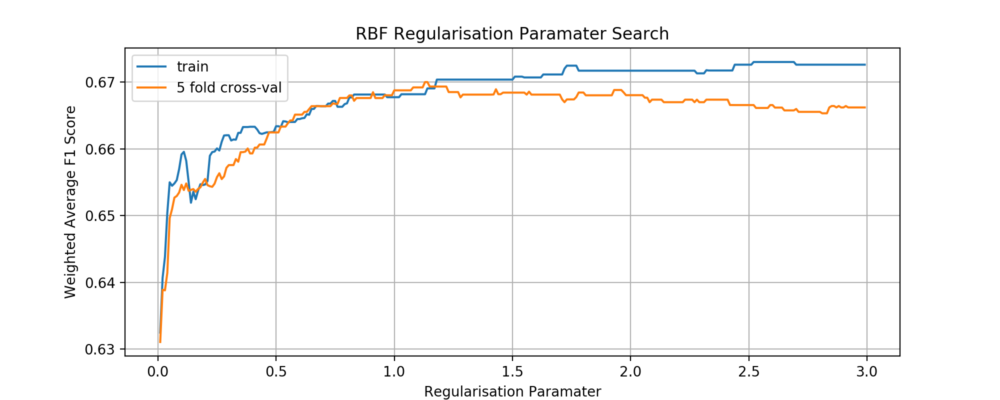

In [3676]:
plt.figure(figsize=(10,4))
plt.title("RBF Regularisation Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs2,train_f1s_2,label="train")
plt.plot(Cs2,val_f1s_2,label="5 fold cross-val")
plt.grid()
plt.legend()
plt.show()

In [3677]:
np.max(val_f1s_2)
index2=val_f1s_2.index(np.max(val_f1s_2))
print(Cs2[index2])
C_rbf=Cs2[index2]

1.1300000000000001


In [3678]:
train_f1s_3=[]
val_f1s_3=[]
Cs3=np.arange(1.0,500.0,10.0)

for C in tqdm(Cs3):
    print("Regularisation: ",C)
    
    clf=svm.SVC(kernel='poly',gamma="auto",degree=4, C=C,class_weight="balanced",random_state=2).fit(X,y)
    
    train_r=get_f1_score(clf,X,y)
    print("Train f1: ",train_r)
    val_rs= cross_val_score(svm.SVC(kernel='poly',gamma="auto",degree=4, C=C,class_weight="balanced",random_state=2), X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
    print("Val f1: ",val_r)
    train_f1s_3.append(train_r)
    val_f1s_3.append(val_r)
    print("")


Regularisation:  1.0
Train f1:  0.5790175286221876
Val f1:  0.5663900354654665

Regularisation:  11.0
Train f1:  0.6194427049016072
Val f1:  0.6141609345136114

Regularisation:  21.0
Train f1:  0.6218066354956401
Val f1:  0.6181186681005064

Regularisation:  31.0
Train f1:  0.6227065545779301
Val f1:  0.6193456407066918

Regularisation:  41.0
Train f1:  0.6236864142858245
Val f1:  0.6193733393379465

Regularisation:  51.0
Train f1:  0.6240570323878522
Val f1:  0.6190341472849725

Regularisation:  61.0
Train f1:  0.6268183508402801
Val f1:  0.6179765362859417

Regularisation:  71.0
Train f1:  0.6242591925550744
Val f1:  0.6175890330002175

Regularisation:  81.0
Train f1:  0.623428779125682
Val f1:  0.6175741585127732

Regularisation:  91.0
Train f1:  0.622529493635543
Val f1:  0.6164547480083309

Regularisation:  101.0
Train f1:  0.6214168592248045
Val f1:  0.6151840373169917

Regularisation:  111.0
Train f1:  0.6218639040646642
Val f1:  0.6155586274939864

Regularisation:  121.0
Train 

<IPython.core.display.Javascript object>


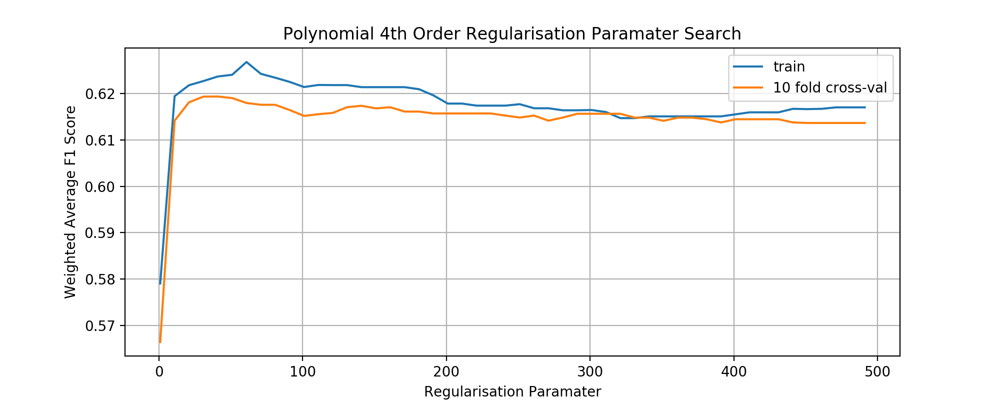

In [3679]:
plt.figure(figsize=(10,4))
plt.title("Polynomial 4th Order Regularisation Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs3,train_f1s_3,label="train")
plt.plot(Cs3,val_f1s_3,label="10 fold cross-val")
plt.grid()
plt.legend()
plt.show()

In [3680]:
np.max(val_f1s_3)
index3=val_f1s_3.index(np.max(val_f1s_3))
print(Cs3[index3])
C_poly=Cs3[index3]

41.0


In [3699]:
# # we create an instance of SVM and fit out data. We do not scale our
# # data since we want to plot the support vectors
C1 = 43.0 # SVM regularization parameter
C2 = 2.69 
# C3 = 400.0
models1 = [svm.SVC(kernel='linear',class_weight="balanced",C=C_linear,random_state=2).fit(X,y),
          svm.SVC(kernel='rbf',class_weight="balanced",C=C_rbf,random_state=2).fit(X,y),
          svm.SVC(kernel='poly', degree=4, gamma='auto',max_iter=10000,class_weight="balanced",C=C_poly,random_state=2).fit(X,y)]

<IPython.core.display.Javascript object>


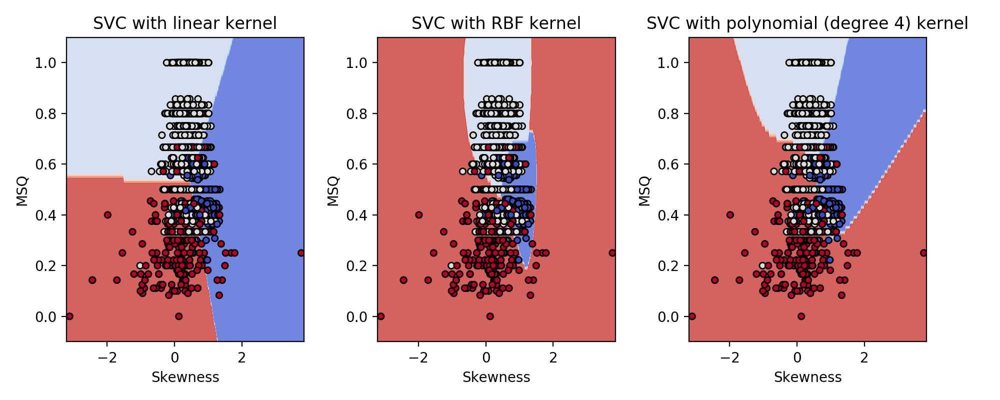

In [3700]:
# title for the plots
titles = ('SVC with linear kernel',
          'SVC with RBF kernel',
          'SVC with polynomial (degree 4) kernel')

# Set-up 2x2 grid for plotting.
fig, sub = plt.subplots(1, 3,figsize=(10,4))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)


for clf, title, ax in zip(models1, titles, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(yy.min(), yy.max())
    ax.set_xlabel("Skewness")
    ax.set_ylabel('MSQ')
    ax.set_title(title)
# plt.legend(["A","B","C"])
plt.tight_layout()
plt.show()

In [3701]:
Training_F1s=[]
Training_Precisions=[]
Training_Recals=[]

Validation_F1s=[]
Validation_Precisions=[]
Validation_Recals=[]
stds_err_prec_svm=[]
stds_err_rec_svm=[]
stds_err_f1_svm=[]
for clf,title in zip(models1,titles):
    print(title)
    train_pred=clf.predict(X)
    train_f1=get_f1_score(clf,X,y)
    Training_F1s.append(train_f1)
    print("Train f1: ",train_f1)
    train_pre=get_precision_score(clf,X,y)
    Training_Precisions.append(train_pre)
    print("Train prec: ",train_pre)
    train_rec=get_recall_score(clf,X,y)
    Training_Recals.append(train_rec)
    print("Train recall: ",train_rec)  
    
    val_f1s= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_f1=val_f1s.mean()
    val_f1_std=val_f1s.std()
    Validation_F1s.append(val_f1)
    stds_err_f1_svm.append(val_f1_std)
    
    val_pres= cross_val_score(clf, X, y,scoring=get_precision_score, cv=10)
    val_pre=val_pres.mean()
    val_pre_std=val_pres.std()
    Validation_Precisions.append(val_pre)
    stds_err_prec_svm.append(val_pre_std)
    
    val_recs= cross_val_score(clf, X, y,scoring=get_recall_score, cv=10)
    val_rec=val_recs.mean()
    val_rec_std=val_recs.std()
    Validation_Recals.append(val_rec)
    stds_err_rec_svm.append(val_rec_std)
    
    print("Val f1: {} +- {}".format(val_f1,val_f1_std))
    print("Val prec: {} +- {}".format(val_pre,val_pre_std))
    print("Val rec: {} +- {}".format(val_rec,val_rec_std))
    print("")

SVC with linear kernel
Train f1:  0.6559260570478873
Train prec:  0.7136734153620337
Train recall:  0.6391927055556034
Val f1: 0.6558363349866936 +- 0.02655434962139589
Val prec: 0.7134187868870125 +- 0.03219677761223458
Val rec: 0.6394442441529942 +- 0.023955005878428935

SVC with RBF kernel
Train f1:  0.6681985422808561
Train prec:  0.7206782002945425
Train recall:  0.6578130371204044
Val f1: 0.6700247726350936 +- 0.02901609273965288
Val prec: 0.7223729249529669 +- 0.033320564808141155
Val rec: 0.6607015932488793 +- 0.02875771201567418

SVC with polynomial (degree 4) kernel
Train f1:  0.6236864142858245
Train prec:  0.7032251630130569
Train recall:  0.6111413040824126
Val f1: 0.6193733393379465 +- 0.028067615035188058
Val prec: 0.6996808948973647 +- 0.03329213794671786
Val rec: 0.6092315285768416 +- 0.02252108311251527



In [88]:
def percentage(col):
    cols=[]
    for c in col:
        cols.append(c*100.00)
    return cols

In [2668]:
Training_F1s

[0.7053803849984258, 0.7250607981904017, 0.6440701794750476]

In [2807]:
columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
SVM_Table=pd.DataFrame([Training_Precisions,Training_Recals,Training_F1s,Validation_Precisions,Validation_Recals,Validation_F1s]).T
SVM_Table.columns=columns
SVM_Table.index=titles
SVM_Table = SVM_Table.apply(percentage)
SVM_Table


,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.367342,63.919271,65.592606,71.341879,63.944424,65.583633
SVC with RBF kernel,72.779411,66.186712,67.619978,72.477749,66.015237,67.272176
SVC with polynomial (degree 4) kernel,70.322516,61.114130,62.368641,69.968089,60.923153,61.937334


## 2 Classes 

In [2567]:
X2 = train_scores[["Skewness","MSQ"]]
y2=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y2.append(0)
    if(label=="B"):
        y2.append(0)
    if(label=="C"):
        y2.append(1)
Xtest2 = test_scores[["Skewness","MSQ"]]
ytest2=[]
for label in test_labels["Label"]:
    if(label=="A"):
        ytest2.append(0)
    if(label=="B"):
        ytest2.append(0)
    if(label=="C"):
        ytest2.append(1)

print("X shape: {}".format(X2.shape))
print("y shape: {}".format(len(y2)))

X shape: (1959, 2)
y shape: 1959


In [2568]:
# we create an instance of SVM and fit out data. We do not scale our
# data since we want to plot the support vectors
C = 1.e10  # SVM regularization parameter
models2 = [svm.SVC(kernel='linear', C=C_linear).fit(X2,y2),
          svm.LinearSVC(C=C, max_iter=1000000).fit(X2,y2),
          svm.SVC(kernel='rbf', gamma="auto", C=C).fit(X2,y2),
          svm.SVC(kernel='poly', degree=4, gamma='auto', C=C,max_iter=1000000).fit(X2,y2)]

KeyboardInterrupt: 

In [ ]:
# title for the plots
titles = ('SVC with linear kernel',
          'LinearSVC (linear kernel)',
          'SVC with RBF kernel',
          'SVC with polynomial (degree 4) kernel')

# Set-up 2x2 grid for plotting.
fig, sub = plt.subplots(2, 2,figsize=(9,9))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X2["Skewness"].values, X2["MSQ"].values
xx, yy = make_meshgrid(X0, X1)

for clf, title, ax in zip(models2, titles, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(yy.min(), yy.max())
    ax.set_xlabel("Skewness")
    ax.set_ylabel("MSQ")
    ax.set_title(title)
# plt.legend(["A","B","C"])
plt.show()

In [ ]:
for clf,title in zip(models2,titles):
    train_pred=clf.predict(X2)
    test_pred=clf.predict(Xtest2)
    print(title)
    AB_train, C_train = get_accuracy_2class(train_pred,y2)
    print("Train accuracy: A: {} B: {} ".format(AB_train, C_train))
    AB_test, C_test = get_accuracy_2class(test_pred,ytest2)
    print("Test accuracy: A: {} B: {} ".format(AB_test, C_test))

In [ ]:
pred = predict(Xtest2,0.0,0.5)
accs = get_accuracy_2class(pred,ytest2)
print("Good Sample accuracy: {} , Bad Sample accuracy: {} ".format(accs[0],accs[1]))

# Linear Classifiers

In [75]:
from sklearn.linear_model import Perceptron
from sklearn import linear_model
from sklearn.linear_model import SGDClassifier, Perceptron
from sklearn.linear_model import PassiveAggressiveClassifier
from sklearn.linear_model import LogisticRegression

In [1616]:
def make_meshgrid(x, y, h=.02):
    """Create a mesh of points to plot in

    Parameters
    ----------
    x: data to base x-axis meshgrid on
    y: data to base y-axis meshgrid on
    h: stepsize for meshgrid, optional

    Returns
    -------
    xx, yy : ndarray
    """
    x_min, x_max = x.min()-0.1, x.max()+0.1 
    y_min, y_max = y.min()-0.1, y.max()+0.1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))
    return xx, yy

def plot_contours(ax, clf, xx, yy, **params):
    """Plot the decision boundaries for a classifier.

    Parameters
    ----------
    ax: matplotlib axes object
    clf: a classifier
    xx: meshgrid ndarray
    yy: meshgrid ndarray
    params: dictionary of params to pass to contourf, optional
    """
#     print(clf)
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    out = ax.contourf(xx, yy, Z, **params)
    return out

def plot_hyperplane(coef,intercept,c, color,ax):
    print("coef: ",coef)
    print("intercept: ",intercept)
    def line(x0):
        return (-(x0 * coef[c, 0]) - intercept[c]) / coef[c, 1]
    ax.plot([xmin, xmax], [line(xmin), line(xmax)],
             ls="--", color=color)

In [ ]:
X = train_scores[["Skewness","MSQ"]]
y=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y.append(0)
    if(label=="B"):
        y.append(1)
    if(label=="C"):
        y.append(2)
print("X shape: {}".format(X.shape[0]))
print("y shape: {}".format(len(y)))

In [1535]:
for model in models3:
    print(model.classes_)

[0 1 2]
[0 1 2]
[0 1 2]
[0 1 2]
[0 1 2]
[0 1 2]


In [1771]:
import warnings
warnings.filterwarnings('ignore')

In [3244]:
print(y)

MSQ


In [452]:
loss="modified_huber"
train_huber=[]
val_huber=[]
Cs_huber=np.arange(0.0006,.08,0.0006)

for C in tqdm(Cs_huber):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_huber.append(train_r)
    val_huber.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


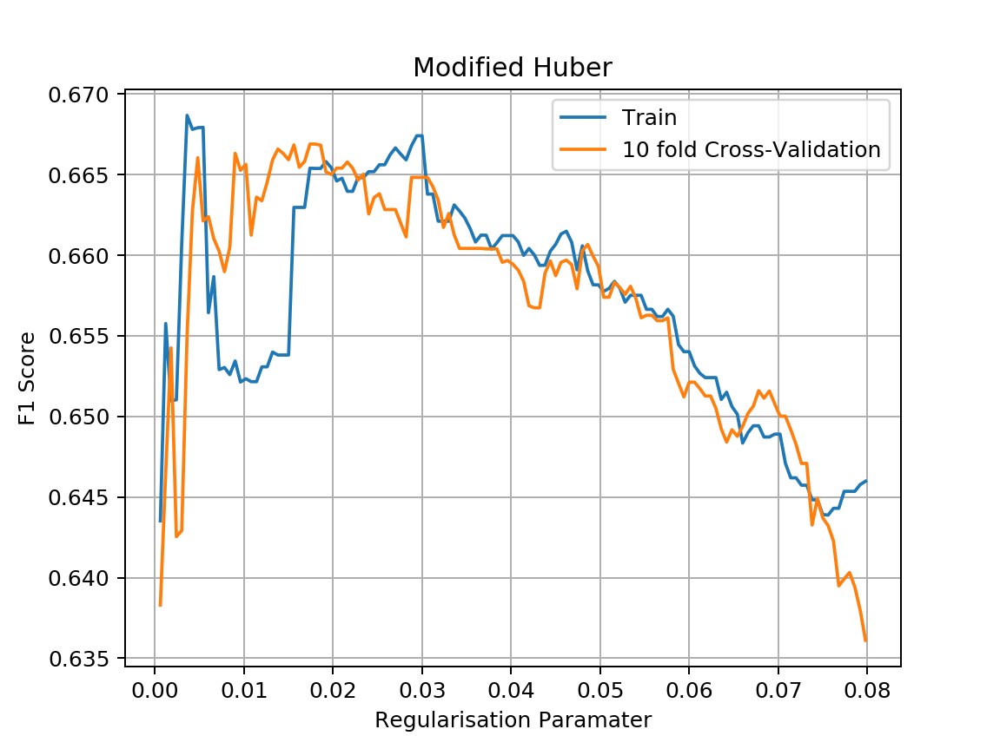

In [453]:
plt.figure()
plt.title("Modified Huber")
plt.plot(Cs_huber,train_huber,label="Train")
plt.plot(Cs_huber,val_huber,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [454]:
index_huber=val_huber.index(np.max(val_huber))
C_huber=Cs_huber[index_huber]
print("Huber alpha: ",C_huber)

Huber alpha:  0.0174


In [455]:
loss="log"
train_log=[]
val_log=[]
Cs_log=np.arange(0.0001,0.01,0.0001)

for C in tqdm(Cs_log):
#     print("Regularisation: ",C)
    
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_log.append(train_r)
    val_log.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


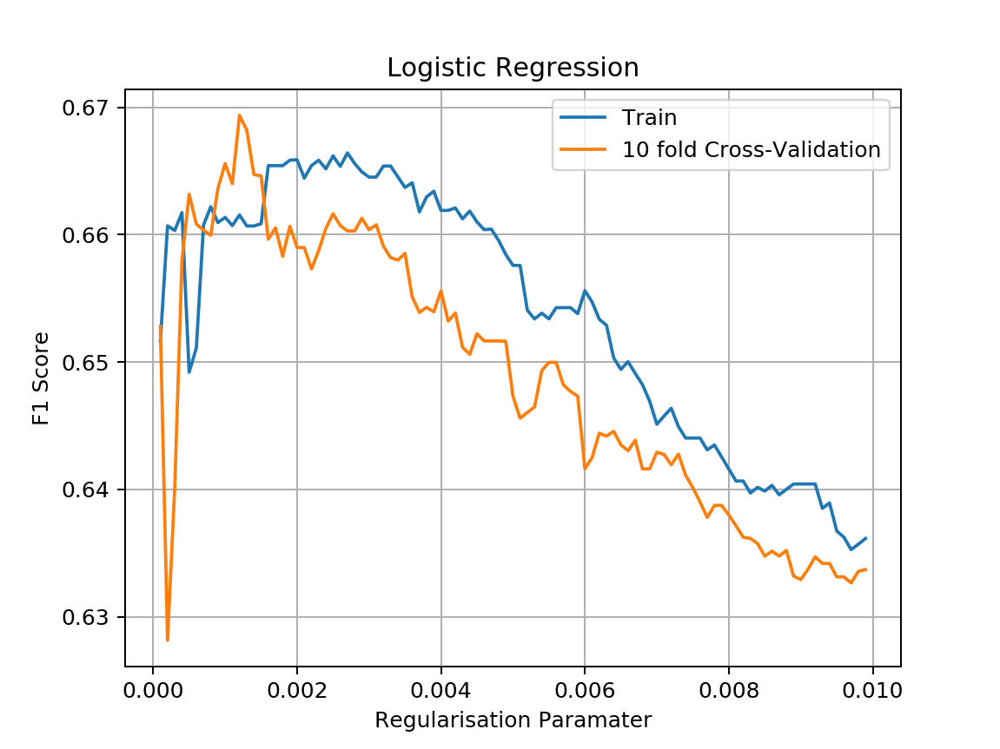

In [456]:
plt.figure()
plt.title("Logistic Regression")
plt.plot(Cs_log,train_log,label="Train")
plt.plot(Cs_log,val_log,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [457]:
index_log=val_log.index(np.max(val_log))
C_log=Cs_log[index_log]
print("Logistic alpha: ",C_log)

Logistic alpha:  0.0012000000000000001


In [458]:
penalty="elasticnet"
train_elas=[]
val_elas=[]
Cs_elas=np.arange(0.0002,0.02,0.0002)

for C in tqdm(Cs_elas):
#     print("Regularisation: ",C)
    clf=SGDClassifier(penalty=penalty,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_elas.append(train_r)
    val_elas.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


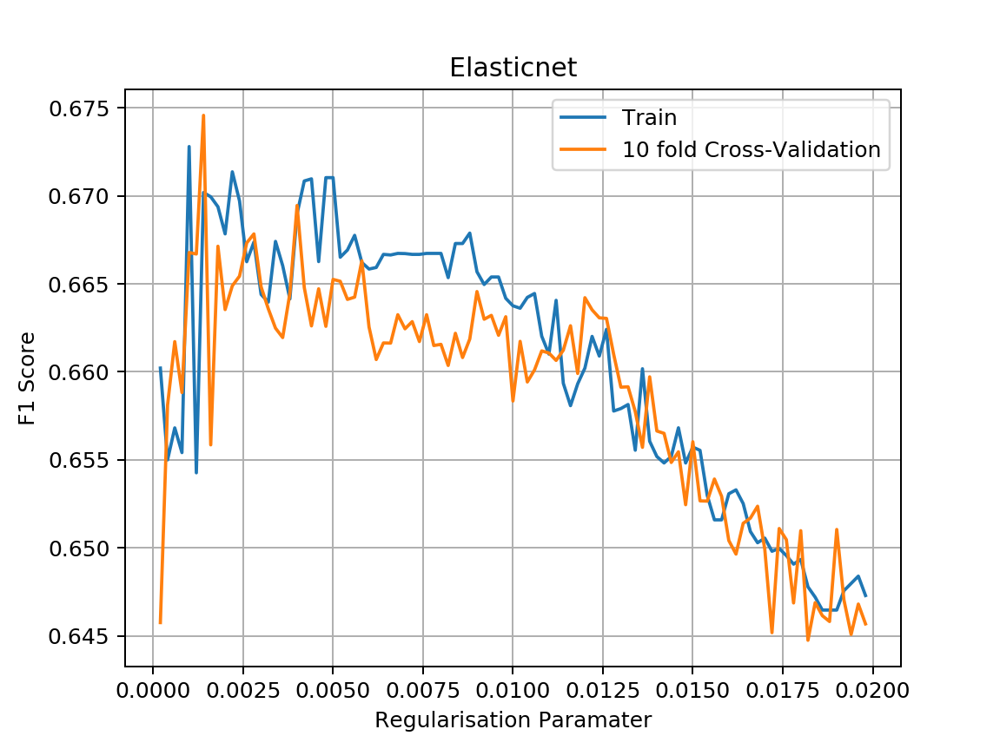

In [459]:
plt.figure()
plt.title("Elasticnet")
plt.plot(Cs_elas,train_elas,label="Train")
plt.plot(Cs_elas,val_elas,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [460]:
index_elas=val_elas.index(np.max(val_elas))
C_elas=Cs_elas[index_elas]
print("Elastic alpha: ",C_elas)

Elastic alpha:  0.0014000000000000002


In [461]:
loss="squared_loss"
train_sq=[]
val_sq=[]
Cs_sq=np.arange(0.0002,.02,0.0002)

for C in tqdm(Cs_sq):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_sq.append(train_r)
    val_sq.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


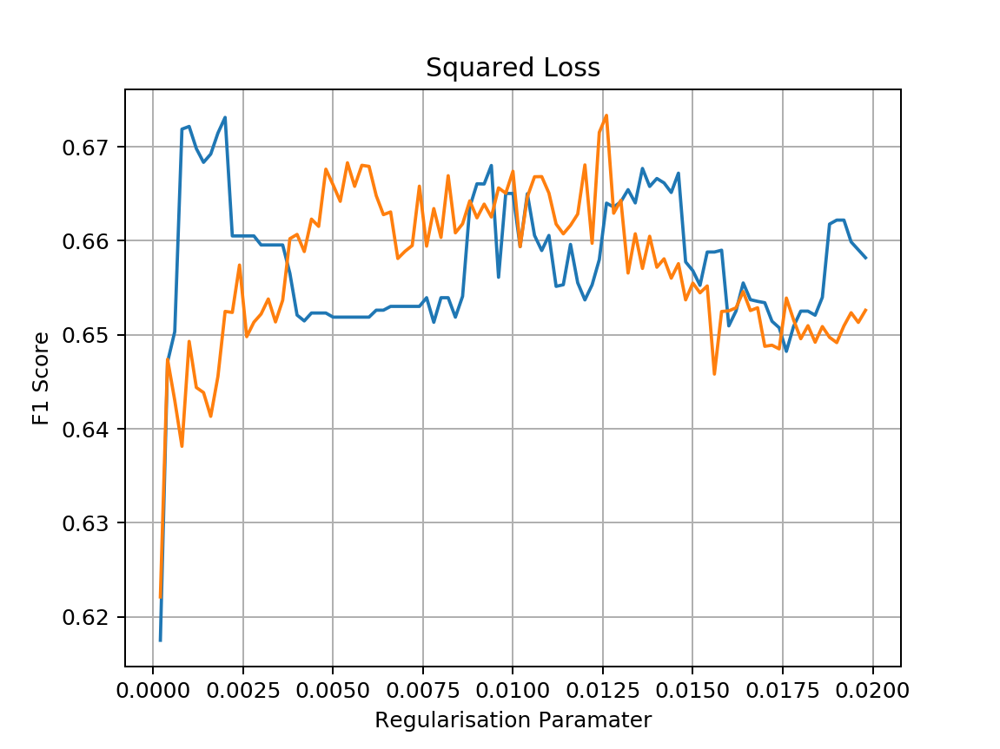

In [462]:
plt.figure()
plt.title("Squared Loss")
plt.plot(Cs_sq,train_sq,label="Train")
plt.plot(Cs_sq,val_sq,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [463]:
index_sq=val_sq.index(np.max(val_sq))
C_sq=Cs_sq[index_sq]
print("Squared Alpha: ",C_sq)

Squared Alpha:  0.012600000000000002


In [464]:
train_norm=[]
val_norm=[]
Cs_norm=np.arange(0.0002,0.02,0.0002)
for C in tqdm(Cs_norm):
#     print("Regularisation: ",C)
    clf=SGDClassifier(alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_norm.append(train_r)
    val_norm.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


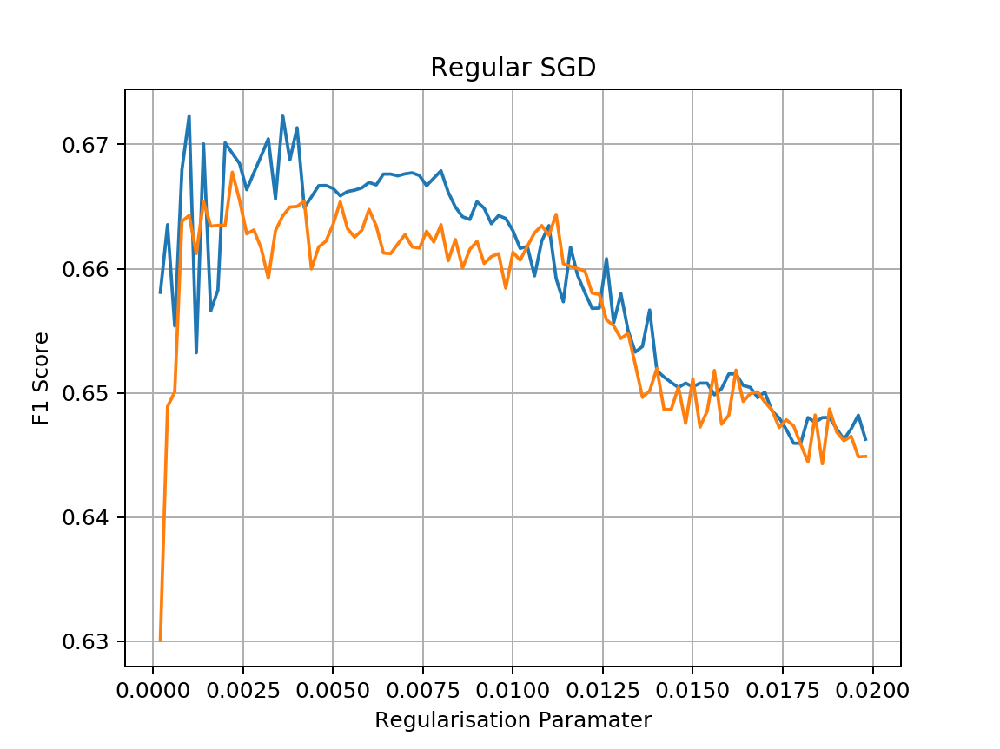

In [465]:
plt.figure()
plt.title("Regular SGD")
plt.plot(Cs_norm,train_norm,label="Train")
plt.plot(Cs_norm,val_norm,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [466]:
index_norm=val_norm.index(np.max(val_norm))
C_norm=Cs_norm[index_norm]
print("Logistic alpha: ",C_norm)

Logistic alpha:  0.0022


In [467]:
from sklearn.linear_model import RidgeClassifier

In [238]:
models4 = [
    RidgeClassifier(random_state=2,class_weight="balanced").fit(X,y),
    SGDClassifier(penalty="elasticnet",class_weight="balanced",random_state=2,alpha=C_elas).fit(X,y),
    SGDClassifier(loss="modified_huber",random_state=2,class_weight="balanced",alpha=C_huber).fit(X,y),
    SGDClassifier(loss="log",random_state=2,class_weight="balanced",alpha=C_log).fit(X,y),
    SGDClassifier(loss="squared_loss",random_state=2,class_weight="balanced",alpha=C_sq).fit(X,y),
    Perceptron(random_state=2,class_weight="balanced").fit(X,y),
]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


<IPython.core.display.Javascript object>


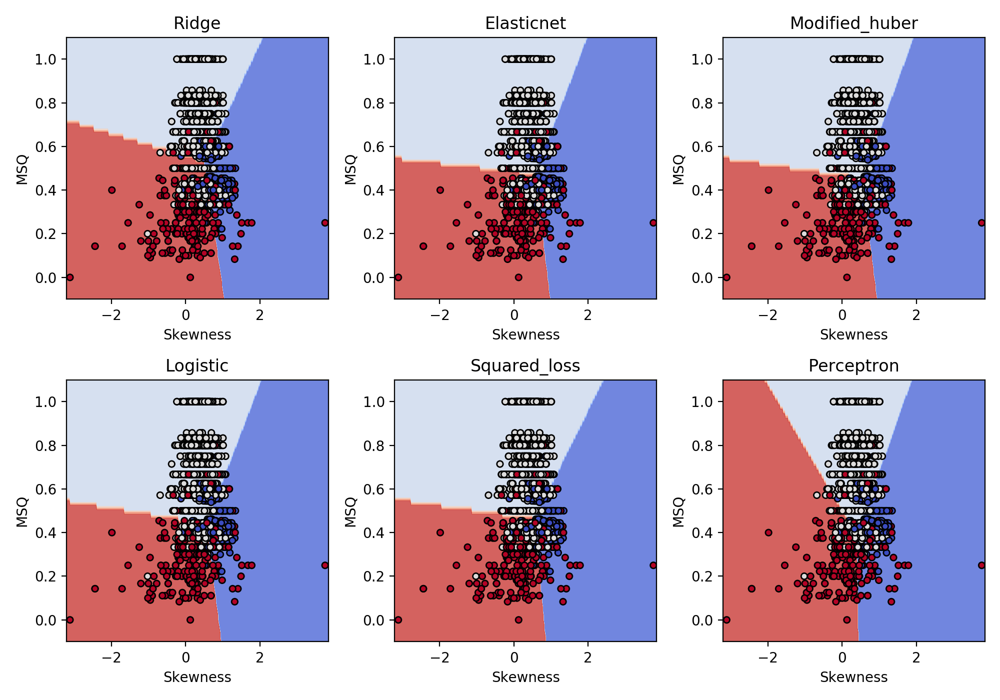

In [239]:
# title for the plots
titles4 = ('Ridge',
          'Elasticnet',
          'Modified_huber',
          'Logistic',
          'Squared_loss',
          'Perceptron',)

# Set-up 2x3 grid for plotting.
fig, sub = plt.subplots(2, 3,figsize=(10,7))
# plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)

# print("titles length: ",len(titles))
# print("models length: ",len(models))
# print("figures length: ",len(sub.flatten()))
colors = "bry"

for clf, title, ax in zip(models4, titles3, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
#     for i, color in zip(clf.classes_, colors):
#         plot_hyperplane(clf.coef_,clf.intercept_,i, color,ax)
    ax.set_xlabel('Skewness')
    ax.set_ylabel('MSQ')
    ax.set_title(title)
plt.tight_layout()
plt.show()

In [3772]:
Training_F1s=[]
Training_Precisions=[]
Training_Recals=[]

Validation_F1s=[]
Validation_Precisions=[]
Validation_Recals=[]
stds_err_prec_sgd=[]
stds_err_rec_sgd=[]
stds_err_f1_sgd=[]
for clf,title in zip(models3,titles3):
    print(title)
    train_pred=clf.predict(X)
    train_f1=get_f1_score(clf,X,y)
    Training_F1s.append(train_f1)
    print("Train f1: ",train_f1)
    train_pre=get_precision_score(clf,X,y)
    Training_Precisions.append(train_pre)
    print("Train prec: ",train_pre)
    train_rec=get_recall_score(clf,X,y)
    Training_Recals.append(train_rec)
    print("Train recall: ",train_rec)  
    
    val_f1s= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_f1=val_f1s.mean()
    val_f1_std=val_f1s.std()
    Validation_F1s.append(val_f1)
    stds_err_f1_sgd.append(val_f1_std)
    
    val_pres= cross_val_score(clf, X, y,scoring=get_precision_score, cv=10)
    val_pre=val_pres.mean()
    val_pre_std=val_pres.std()
    Validation_Precisions.append(val_pre)
    stds_err_prec_sgd.append(val_pre_std)
    
    val_recs= cross_val_score(clf, X, y,scoring=get_recall_score, cv=10)
    val_rec=val_recs.mean()
    val_rec_std=val_recs.std()
    Validation_Recals.append(val_rec)
    stds_err_rec_sgd.append(val_rec_std)
    
    print("Val f1: {} +- {}".format(val_f1,val_f1_std))
    print("Val prec: {} +- {}".format(val_pre,val_pre_std))
    print("Val rec: {} +- {}".format(val_rec,val_rec_std))
    print("")

Ridge
Train f1:  0.6599071914234846
Train prec:  0.7080559356200381
Train recall:  0.6400538958083904
Val f1: 0.6634744210431853 +- 0.045233393676194486
Val prec: 0.7139607064961662 +- 0.04690006841920165
Val rec: 0.6459044644688173 +- 0.041500899012120444

Elasticnet
Train f1:  0.6728681057379434
Train prec:  0.6855274900146696
Train recall:  0.6710844135297189
Val f1: 0.6670645499792875 +- 0.04629222552840013
Val prec: 0.6927842486351018 +- 0.049428683803991444
Val rec: 0.6595367943153965 +- 0.04229677120504061

Modified_huber
Train f1:  0.668049902593328
Train prec:  0.6801160134493468
Train recall:  0.6709377085501044
Val f1: 0.6692941602165962 +- 0.05240253457750968
Val prec: 0.6840005734499579 +- 0.05427233538360059
Val rec: 0.6749680091956249 +- 0.05280204862052864

Logistic
Train f1:  0.6652274793774112
Train prec:  0.6665553620681826
Train recall:  0.6734892787524366
Val f1: 0.6601088629232462 +- 0.05808478635196214
Val prec: 0.6678213180355164 +- 0.05818558794841338
Val rec: 

In [3773]:
columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
SGD_Table=pd.DataFrame([Training_Precisions,Training_Recals,Training_F1s,Validation_Precisions,Validation_Recals,Validation_F1s]).T
SGD_Table.columns=columns
SGD_Table.index=titles3
SGD_Table = SGD_Table.apply(percentage)
SGD_Table

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
Ridge,70.805594,64.005390,65.990719,71.396071,64.590446,66.347442
Elasticnet,68.552749,67.108441,67.286811,69.278425,65.953679,66.706455
Modified_huber,68.011601,67.093771,66.804990,68.400057,67.496801,66.929416
Logistic,66.655536,67.348928,66.522748,66.782132,66.749254,66.010886
Squared_loss,67.349833,67.191677,66.726498,68.437570,68.241379,67.726455
Perceptron,66.470514,67.861037,64.781388,57.041552,63.114612,52.901158


In [3726]:
Results_Table=pd.concat([SVM_Table,SGD_Table])

In [3727]:
Results_Table

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.367342,63.919271,65.592606,71.341879,63.944424,65.583633
SVC with RBF kernel,72.779411,66.186712,67.619978,72.477749,66.015237,67.272176
SVC with polynomial (degree 4) kernel,70.322516,61.114130,62.368641,69.968089,60.923153,61.937334
Ridge,70.796480,63.894462,65.778596,70.783577,63.987421,65.706538
Elasticnet,68.577048,66.935939,67.018753,69.726977,67.078426,67.456846
Modified_huber,68.035569,66.986988,66.539591,68.143564,66.982138,66.689407
Logistic,66.472578,67.112350,66.155489,68.720917,67.024963,66.937873
Squared_loss,67.294336,67.011843,66.401383,68.188158,67.612145,67.335161
Perceptron,66.858146,68.270685,64.866071,56.681520,65.228258,53.811095


In [2356]:
Results_Table.to_csv("Results_Table.csv",float_format="%.2f")

# Decision Tree Classification

In [1554]:
from sklearn import tree

In [1560]:
feature_names=["Skewness","MSQ"]
target_names=["A","B","C"]

In [3880]:
t = tree.DecisionTreeClassifier(class_weight="balanced",max_depth=4,random_state=2)
t = t.fit(X, y)

<IPython.core.display.Javascript object>


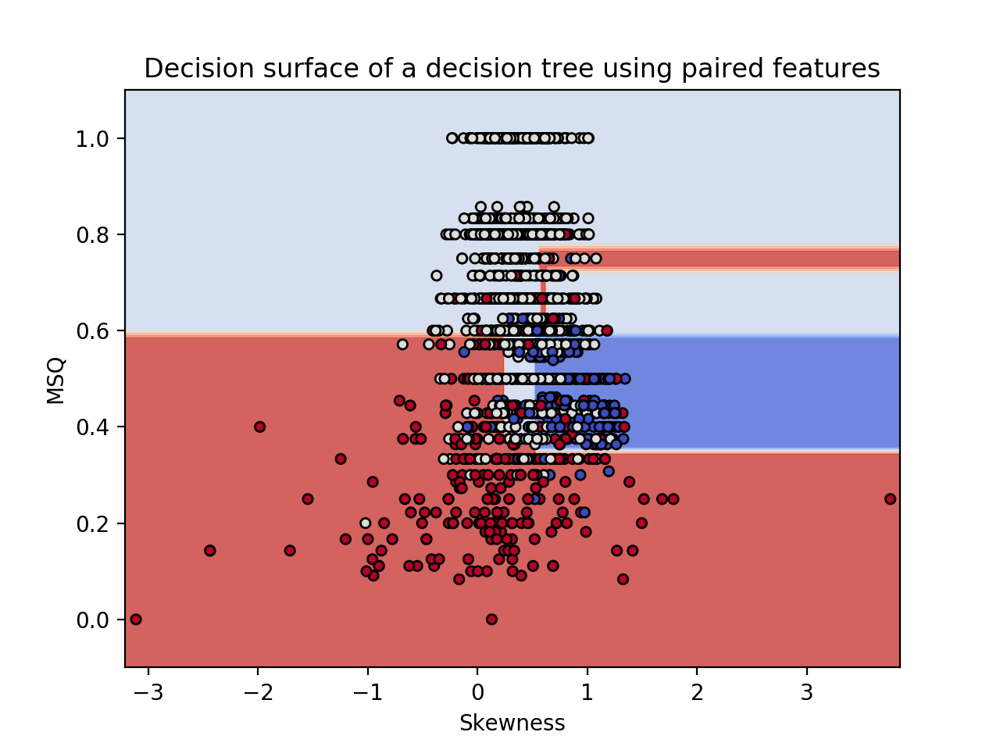

(-3.2124930601009427, 3.847506939899063, -0.1, 1.1)

In [3881]:
plt.figure()
plot_step = 0.02
x_min, x_max = X["Skewness"].min() - 0.1, X["Skewness"].max() + 0.1
y_min, y_max = X["MSQ"].min() - 0.1, X["MSQ"].max() + 0.1

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)
plot_contours(plt,t, xx, yy, cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')

plt.xlabel("Skewness")
plt.ylabel("MSQ")

plt.title("Decision surface of a decision tree using paired features")
# plt.legend(loc='lower right', borderpad=0, handletextpad=0)
plt.axis("tight")

<IPython.core.display.Javascript object>


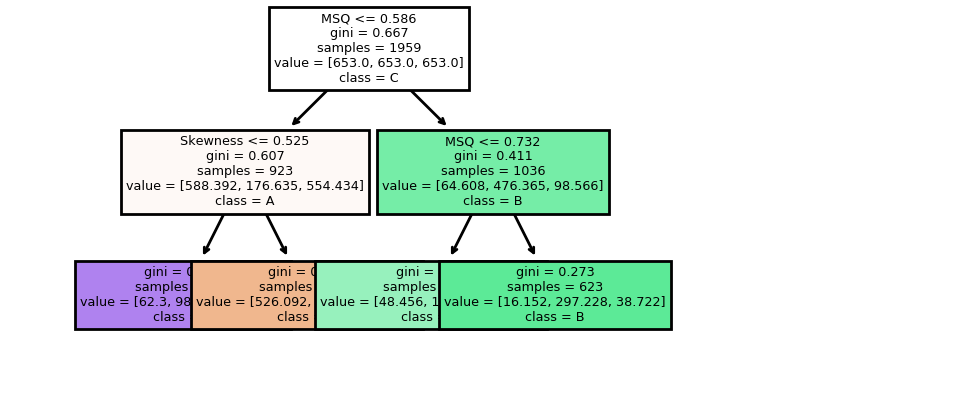

In [3730]:
plt.figure()
tree.plot_tree(t,filled=True,feature_names=feature_names,class_names=target_names) 
plt.axis("tight")
plt.show()

In [3731]:
train_pred=t.predict(X)
train_f1=get_f1_score(t,X,y)

print("Train f1: ",train_f1)
train_pre=get_precision_score(t,X,y)

print("Train prec: ",train_pre)
train_rec=get_recall_score(t,X,y)

print("Train recall: ",train_rec)  

val_f1s= cross_val_score(t, X, y,scoring=get_f1_score, cv=10)
val_f1=val_f1s.mean()
stds_err_f1_dt=val_f1s.std()


val_pres= cross_val_score(t, X, y,scoring=get_precision_score, cv=10)
val_pre=val_pres.mean()
stds_err_prec_dt=val_pres.std()


val_recs= cross_val_score(t, X, y,scoring=get_recall_score, cv=10)
val_rec=val_recs.mean()
stds_err_rec_dt=val_recs.std()


print("Val f1: {} +- {}".format(val_f1,val_f1_std))
print("Val prec: {} +- {}".format(val_pre,val_pre_std))
print("Val rec: {} +- {}".format(val_rec,val_rec_std))
print("")

Train f1:  0.6444721569538753
Train prec:  0.7030932050581636
Train recall:  0.6252078378700837
Val f1: 0.639559877637119 +- 0.1183729141219032
Val prec: 0.6962216726741325 +- 0.08685642281041318
Val rec: 0.6213521594537926 +- 0.10582667137760082



In [3732]:
Results_Table.loc["Decision Tree"]=[train_pre*100,train_rec*100,train_f1*100,val_pre*100,val_rec*100,val_f1*100]

In [2847]:
stds_err_prec_svm

[0.03219677761223458, 0.03518939453767777, 0.03329213794671786]

In [3733]:
errors_prec=[]
errors_prec.extend(stds_err_prec_svm)
errors_prec.extend(stds_err_prec_sgd)
errors_prec.append(stds_err_prec_dt)

In [3734]:
errors_rec=[]
errors_rec.extend(stds_err_rec_svm)
errors_rec.extend(stds_err_rec_sgd)
errors_rec.append(stds_err_rec_dt)

In [3735]:
errors_f1=[]
errors_f1.extend(stds_err_f1_svm)
errors_f1.extend(stds_err_f1_sgd)
errors_f1.append(stds_err_f1_dt)

In [2858]:
print(len(errors_prec))
print(len(errors_rec))
print(len(errors_f1))

10
10
10


In [3736]:
Errors_prec=[]
Errors_rec=[]
Errors_f1=[]
for e_prec,e_rec,e_f1 in zip(errors_prec,errors_rec,errors_f1):
    Errors_prec.append(e_prec*100)
    Errors_rec.append(e_rec*100)
    Errors_f1.append(e_f1*100)

In [2864]:
for index,error in zip(Results_Table["Validation F1-Score"].index,Errors_f1):
    print("F1: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation F1-Score"][index],error))
for index,error in zip(Results_Table["Validation Recall"].index,Errors_rec):
    print("Recall: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Recall"][index],error))
for index,error in zip(Results_Table["Validation Precision"].index,Errors_prec):
    print("Precision: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Precision"][index],error))

F1: 65.58 $\pm$ 2.66
F1: 67.27 $\pm$ 3.17
F1: 61.94 $\pm$ 2.81
F1: 65.71 $\pm$ 2.47
F1: 67.46 $\pm$ 4.02
F1: 66.69 $\pm$ 3.13
F1: 66.94 $\pm$ 3.16
F1: 67.34 $\pm$ 3.30
F1: 53.81 $\pm$ 11.84
F1: 53.81 $\pm$ 2.47
Recall: 63.94 $\pm$ 2.40
Recall: 66.02 $\pm$ 3.18
Recall: 60.92 $\pm$ 2.25
Recall: 63.99 $\pm$ 2.28
Recall: 67.08 $\pm$ 4.14
Recall: 66.98 $\pm$ 3.58
Recall: 67.02 $\pm$ 3.77
Recall: 67.61 $\pm$ 3.73
Recall: 65.23 $\pm$ 10.58
Recall: 65.23 $\pm$ 2.14
Precision: 71.34 $\pm$ 3.22
Precision: 72.48 $\pm$ 3.52
Precision: 69.97 $\pm$ 3.33
Precision: 70.78 $\pm$ 2.97
Precision: 69.73 $\pm$ 4.54
Precision: 68.14 $\pm$ 3.30
Precision: 68.72 $\pm$ 3.51
Precision: 68.19 $\pm$ 3.27
Precision: 56.68 $\pm$ 8.69
Precision: 56.68 $\pm$ 3.18


In [3737]:
for index,error in zip(Results_Table["Validation F1-Score"].index,Errors_f1):
    print("F1: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation F1-Score"][index],error))
for index,error in zip(Results_Table["Validation Recall"].index,Errors_rec):
    print("Recall: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Recall"][index],error))
for index,error in zip(Results_Table["Validation Precision"].index,Errors_prec):
    print("Precision: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Precision"][index],error))

F1: 65.58 $\pm$ 2.66
F1: 67.27 $\pm$ 2.90
F1: 61.94 $\pm$ 2.81
F1: 65.71 $\pm$ 2.47
F1: 67.46 $\pm$ 4.02
F1: 66.69 $\pm$ 3.13
F1: 66.94 $\pm$ 3.16
F1: 67.34 $\pm$ 3.30
F1: 53.81 $\pm$ 11.84
F1: 63.96 $\pm$ 2.47
Recall: 63.94 $\pm$ 2.40
Recall: 66.02 $\pm$ 2.88
Recall: 60.92 $\pm$ 2.25
Recall: 63.99 $\pm$ 2.28
Recall: 67.08 $\pm$ 4.14
Recall: 66.98 $\pm$ 3.58
Recall: 67.02 $\pm$ 3.77
Recall: 67.61 $\pm$ 3.73
Recall: 65.23 $\pm$ 10.58
Recall: 62.14 $\pm$ 2.14
Precision: 71.34 $\pm$ 3.22
Precision: 72.48 $\pm$ 3.33
Precision: 69.97 $\pm$ 3.33
Precision: 70.78 $\pm$ 2.97
Precision: 69.73 $\pm$ 4.54
Precision: 68.14 $\pm$ 3.30
Precision: 68.72 $\pm$ 3.51
Precision: 68.19 $\pm$ 3.27
Precision: 56.68 $\pm$ 8.69
Precision: 69.62 $\pm$ 3.18


In [2906]:
Results_Table

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.367342,63.919271,65.592606,71.341879,63.944424,65.583633
SVC with RBF kernel,72.779411,66.186712,67.619978,72.477749,66.015237,67.272176
SVC with polynomial (degree 4) kernel,70.322516,61.114130,62.368641,69.968089,60.923153,61.937334
Ridge,70.796480,63.894462,65.778596,70.783577,63.987421,65.706538
Elasticnet,68.577048,66.935939,67.018753,69.726977,67.078426,67.456846
Modified_huber,68.035569,66.986988,66.539591,68.143564,66.982138,66.689407
Logistic,66.472578,67.112350,66.155489,68.720917,67.024963,66.937873
Squared_loss,67.294336,67.011843,66.401383,68.188158,67.612145,67.335161
Perceptron,66.858146,68.270685,64.866071,56.681520,65.228258,53.811095
Decision Tree,66.858146,68.270685,64.866071,56.681520,65.228258,53.811095


In [3738]:
indices=["SVC Linear","SVC RBF","SVC Polynomial","SGD Ridge","SGD Elastic","SGD Mod Huber","SGD Logistic","SGD Squared","SGD Percep","Decision Tree"]
columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
All_Errors=[Errors_prec,Errors_rec,Errors_f1]
Results_Table_std=pd.DataFrame(columns=Results_Table.columns,index=Results_Table.index)
for c in Results_Table.columns[:3]:
    for i in Results_Table.index:
        Results_Table_std[c][i]="{0:2.2f}".format(Results_Table[c][i])
for c,Errors in zip(Results_Table.columns[3:],All_Errors):
    for i,Error in zip(Results_Table.index,Errors):
        Results_Table_std[c][i]="{0:2.2f} $\pm$ {1:2.2f}".format(Results_Table[c][i],Error)
        
        

In [3739]:
Results_Table_std

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.37,63.92,65.59,71.34 $\pm$ 3.22,63.94 $\pm$ 2.40,65.58 $\pm$ 2.66
SVC with RBF kernel,72.78,66.19,67.62,72.48 $\pm$ 3.33,66.02 $\pm$ 2.88,67.27 $\pm$ 2.90
SVC with polynomial (degree 4) kernel,70.32,61.11,62.37,69.97 $\pm$ 3.33,60.92 $\pm$ 2.25,61.94 $\pm$ 2.81
Ridge,70.80,63.89,65.78,70.78 $\pm$ 2.97,63.99 $\pm$ 2.28,65.71 $\pm$ 2.47
Elasticnet,68.58,66.94,67.02,69.73 $\pm$ 4.54,67.08 $\pm$ 4.14,67.46 $\pm$ 4.02
Modified_huber,68.04,66.99,66.54,68.14 $\pm$ 3.30,66.98 $\pm$ 3.58,66.69 $\pm$ 3.13
Logistic,66.47,67.11,66.16,68.72 $\pm$ 3.51,67.02 $\pm$ 3.77,66.94 $\pm$ 3.16
Squared_loss,67.29,67.01,66.40,68.19 $\pm$ 3.27,67.61 $\pm$ 3.73,67.34 $\pm$ 3.30
Perceptron,66.86,68.27,64.87,56.68 $\pm$ 8.69,65.23 $\pm$ 10.58,53.81 $\pm$ 11.84
Decision Tree,70.31,62.52,64.45,69.62 $\pm$ 3.18,62.14 $\pm$ 2.14,63.96 $\pm$ 2.47


In [3740]:
Results_Table_std.to_csv("Results_Table_std")

<IPython.core.display.Javascript object>


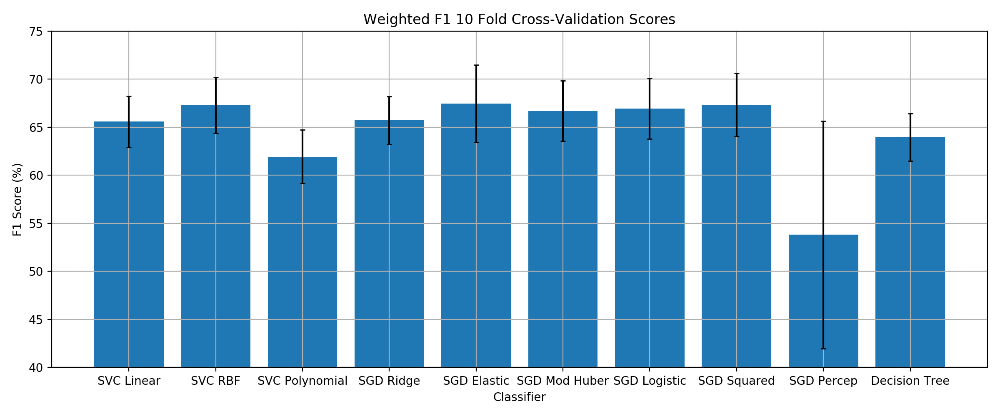

In [3741]:
indices=["SVC Linear","SVC RBF","SVC Polynomial","SGD Ridge","SGD Elastic","SGD Mod Huber","SGD Logistic","SGD Squared","SGD Percep","Decision Tree"]
plt.figure(figsize=(12,5))
plt.title("Weighted F1 10 Fold Cross-Validation Scores")
plt.bar(indices,Results_Table["Validation F1-Score"].values,yerr=Errors_f1,capsize=2)
plt.grid()
plt.xlabel("Classifier")
plt.ylabel("F1 Score (%)")
plt.ylim([40,75])
plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


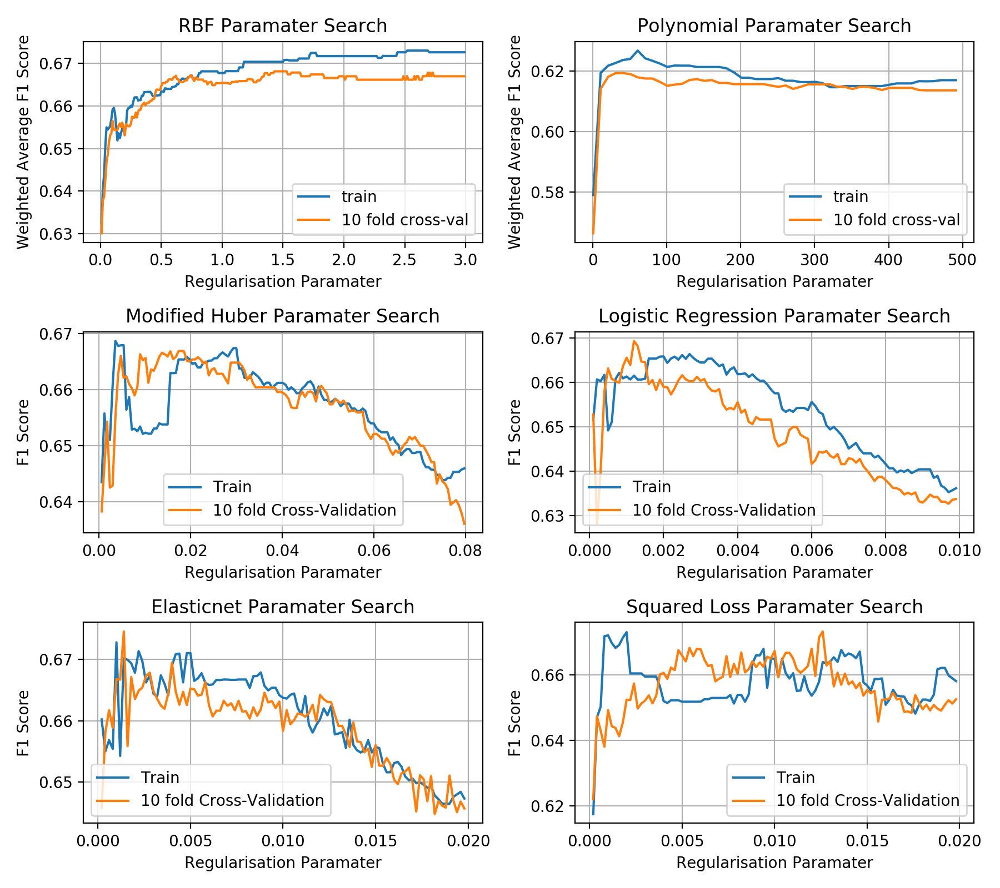

In [2972]:
plt.figure(figsize=(9,8))

plt.subplot(3,2,1)
plt.title("RBF Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs2,train_f1s_2,label="train")
plt.plot(Cs2,val_f1s_2,label="10 fold cross-val")
plt.grid()
plt.legend()

plt.subplot(3,2,2)
plt.title("Polynomial Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs3,train_f1s_3,label="train")
plt.plot(Cs3,val_f1s_3,label="10 fold cross-val")
plt.grid()
plt.legend()

plt.subplot(3,2,3)
plt.title("Modified Huber Paramater Search")
plt.plot(Cs_huber,train_huber,label="Train")
plt.plot(Cs_huber,val_huber,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(3,2,4)
plt.title("Logistic Regression Paramater Search")
plt.plot(Cs_log,train_log,label="Train")
plt.plot(Cs_log,val_log,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(3,2,5)
plt.title("Elasticnet Paramater Search")
plt.plot(Cs_elas,train_elas,label="Train")
plt.plot(Cs_elas,val_elas,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(3,2,6)
plt.title("Squared Loss Paramater Search")
plt.plot(Cs_sq,train_sq,label="Train")
plt.plot(Cs_sq,val_sq,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.tight_layout()
plt.show()

# Extracting Linear Threshold for chosen Classifier

In [2515]:
print(train_scores.columns[4])

MSQ


In [76]:
C_sq=0.012600000000000002
chosen_clf=SGDClassifier(loss="squared_loss",random_state=2,class_weight="balanced",alpha=C_sq).fit(X,y)

In [77]:
coefficients=chosen_clf.coef_
intercepts=chosen_clf.intercept_
print("Coefficients: ",coefficients)
print("Intercepts: ",intercepts)

Coefficients:  [[ 0.86748371 -1.27669843]
 [-0.26330752  2.02026498]
 [-0.36095814 -1.97291746]]
Intercepts:  [-0.12581411 -1.02240841  0.86276226]


In [78]:
line_1_x1=coefficients[0][0]
line_1_x2=coefficients[0][1]
intercept_1=intercepts[0]

line_2_x1=coefficients[1][0]
line_2_x2=coefficients[1][1]
intercept_2=intercepts[1]

line_3_x1=coefficients[2][0]
line_3_x2=coefficients[2][1]
intercept_3=intercepts[2]

In [79]:
skew_range=np.arange(-3.,3.0,0.01)
y_1s=(intercepts[0]+skew_range*line_1_x1)/(-line_1_x2)
y_2s=(intercepts[1]+skew_range*line_2_x1)/(-line_2_x2)
y_3s=(intercepts[2]+skew_range*line_3_x1)/(-line_3_x2)

<IPython.core.display.Javascript object>


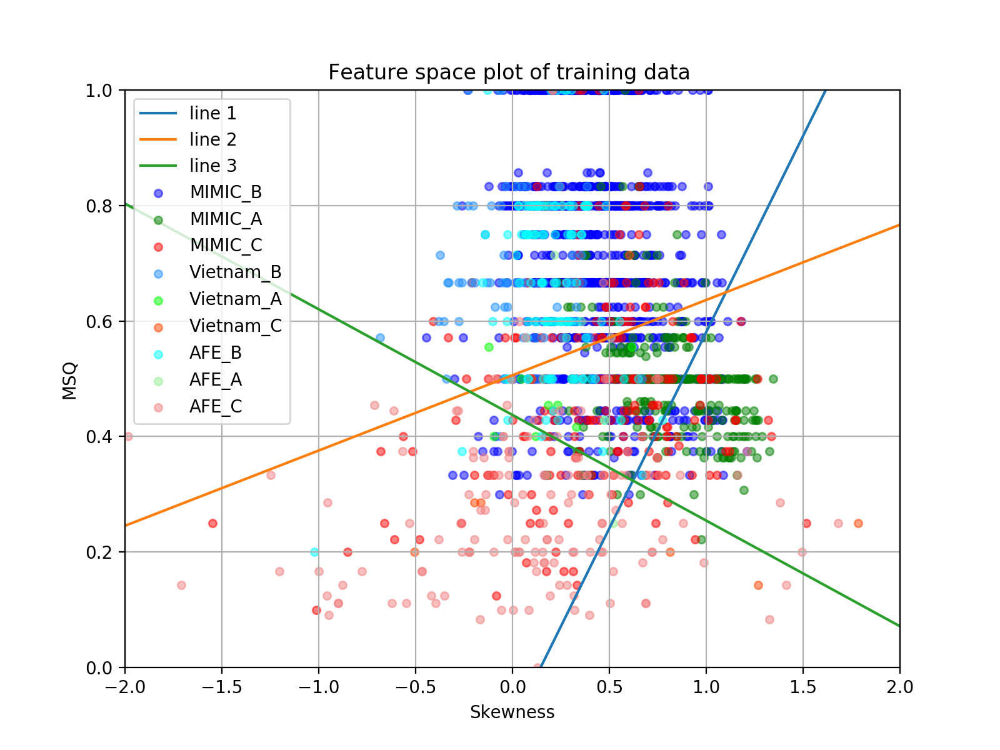

[]

In [83]:

x1="Skewness"
x2="MSQ"
alpha=0.5

ax=MIMIC_B_Scores_train.plot.scatter(x=x1,y=x2,color="blue",alpha=alpha,label="MIMIC_B",figsize=(8,6))
MIMIC_A_Scores_train.plot.scatter(x=x1,y=x2,color="green",alpha=alpha,label="MIMIC_A",ax=ax)
ax=MIMIC_C_Scores_train.plot.scatter(x=x1,y=x2,color="red",alpha=alpha,label="MIMIC_C",ax=ax)

Vietnam_B_Scores_train.plot.scatter(x=x1,y=x2,color="dodgerblue",alpha=alpha,label="Vietnam_B",ax=ax)
Vietnam_A_Scores_train.plot.scatter(x=x1,y=x2,color="lime",alpha=alpha,label="Vietnam_A",ax=ax)
Vietnam_C_Scores_train.plot.scatter(x=x1,y=x2,color="orangered",alpha=alpha,label="Vietnam_C",ax=ax)

AFE_B_Scores_train.plot.scatter(x=x1,y=x2,color="aqua",alpha=alpha,label="AFE_B",ax=ax)
AFE_A_Scores_train.plot.scatter(x=x1,y=x2,color="lightgreen",alpha=alpha,label="AFE_A",ax=ax)
AFE_C_Scores_train.plot.scatter(x=x1,y=x2,color="lightcoral",alpha=alpha,label="AFE_C",ax=ax)

plt.title("Feature space plot of training data ")
plt.xlabel(x1)
plt.ylabel(x2)

plt.grid()

ax.plot(skew_range,y_1s,label="line 1")
ax.plot(skew_range,y_2s,label="line 2")
ax.plot(skew_range,y_3s,label="line 3")
ax.set_ylim([0,1])
ax.set_xlim([-2,2])
plt.legend()
plt.plot()

In [84]:
def predict_sample(sample,coefficients,intercepts):
    Class_0_Score=coefficients[0][0]*sample[0]+coefficients[0][1]*sample[1]+intercepts[0]
    Class_1_Score=coefficients[1][0]*sample[0]+coefficients[1][1]*sample[1]+intercepts[1]
    Class_2_Score=coefficients[2][0]*sample[0]+coefficients[2][1]*sample[1]+intercepts[2]
    Scores=[Class_0_Score,Class_1_Score,Class_2_Score]
    predicted_class=Scores.index(np.max(Scores))
    return predicted_class

def predict_set(X,coefficients,intercepts):
    predictions=[]
    for index in X.index:
        predictions.append(predict_sample(X.loc[index].values,coefficients,intercepts))
    return predictions

In [89]:
train_est=predict_set(X,coefficients,intercepts)
predicted_labels=chosen_clf.predict(X)
test_est=predict_set(X_test,coefficients,intercepts)

print(len(predicted_labels))
print(len(train_est))
print(len(test_est))
print("Train_Report")
print(classification_report(train_est,y,target_names=["A","B","C"]))
print("Test_Report")
print(classification_report(test_est,y_test,target_names=["A","B","C"]))
report=classification_report(test_est,y_test,target_names=["A","B","C"],output_dict=True)
Report=pd.DataFrame.from_dict(report)
Report=Report.apply(percentage)
Report=Report.T
Report.to_csv("Test_Report_3.csv",float_format="%.2f")

1959
1959
1307
Train_Report
              precision    recall  f1-score   support

           A       0.66      0.49      0.56       380
           B       0.86      0.86      0.86      1295
           C       0.50      0.65      0.57       284

    accuracy                           0.76      1959
   macro avg       0.67      0.67      0.66      1959
weighted avg       0.77      0.76      0.76      1959

Test_Report
              precision    recall  f1-score   support

           A       0.57      0.49      0.53       243
           B       0.85      0.83      0.84       853
           C       0.49      0.62      0.55       211

    accuracy                           0.73      1307
   macro avg       0.64      0.65      0.64      1307
weighted avg       0.74      0.73      0.73      1307



In [90]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix
import seaborn as sns

<IPython.core.display.Javascript object>


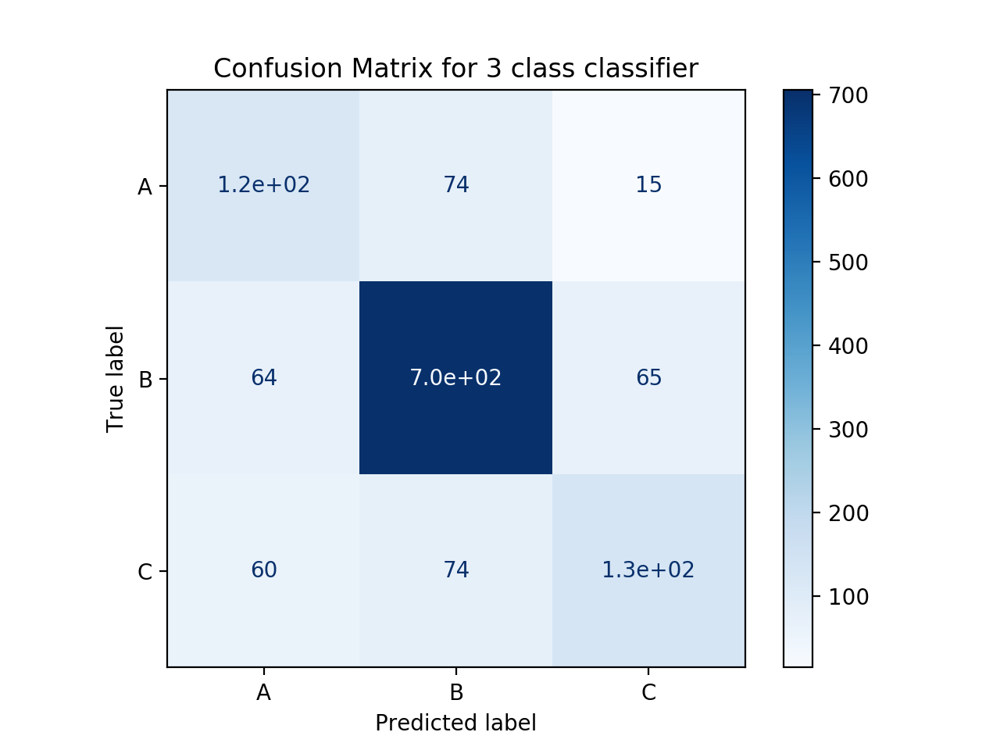

In [91]:
plt.figure()
ax=plt.subplot()
class_names=["A","B","C"]
# cm=confusion_matrix(y_test,test_est)


disp=plot_confusion_matrix(chosen_clf, X_test, y_test,
                                 display_labels=class_names,
                                 cmap=plt.cm.Blues,ax=ax)

plt.title("Confusion Matrix for 3 class classifier")

plt.show()


# Two Class Classifier 

In [189]:
X2 = train_scores[["Skewness","MSQ"]]
y2=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y2.append(0)
    if(label=="B"):
        y2.append(0)
    if(label=="C"):
        y2.append(1)
Xtest2 = test_scores[["Skewness","MSQ"]]
ytest2=[]
for label in test_labels["Label"]:
    if(label=="A"):
        ytest2.append(0)
    if(label=="B"):
        ytest2.append(0)
    if(label=="C"):
        ytest2.append(1)

print("X shape: {}".format(X2.shape))
print("y shape: {}".format(len(y2)))

X shape: (1959, 2)
y shape: 1959


In [190]:
def get_f1_score2(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A&B","C"],output_dict=True)["macro avg"]["f1-score"]

def get_precision_score2(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A&B","C"],output_dict=True)["macro avg"]["precision"]
                                                                                                     
def get_recall_score2(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A&B","C"],output_dict=True)["macro avg"]["recall"] 

# Optimizing Hyper Paramaters

In [468]:
loss="modified_huber"
train_huber_2=[]
val_huber_2=[]
Cs_huber_2=np.arange(0.01,1.0,0.01)

for C in tqdm(Cs_huber_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_huber_2.append(train_r)
    val_huber_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


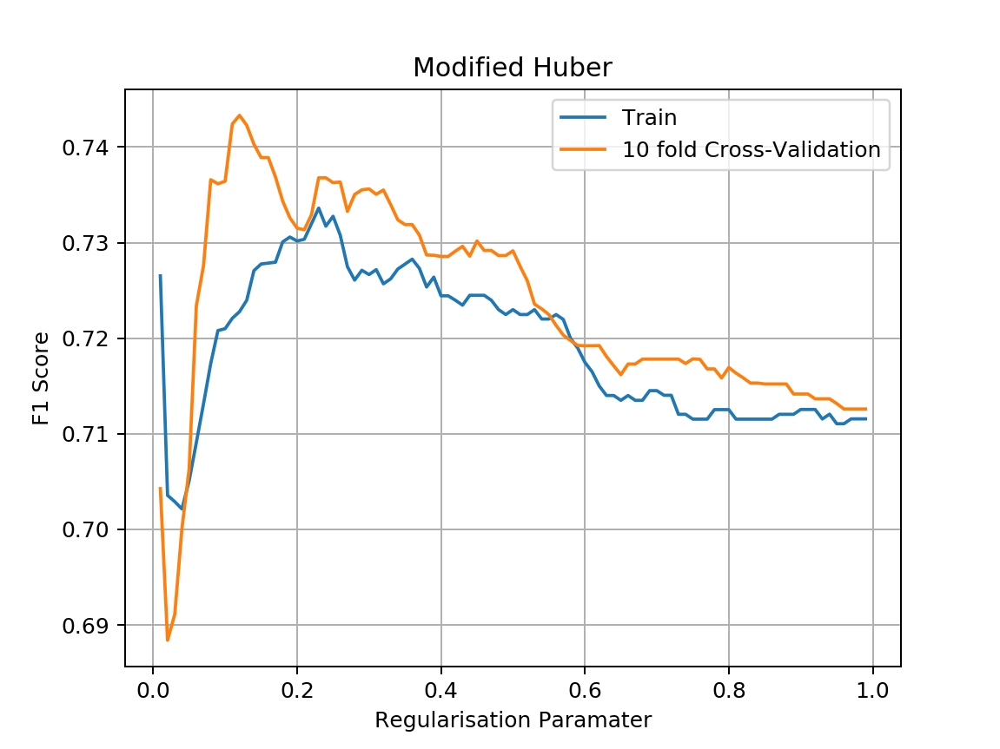

In [469]:
plt.figure()
plt.title("Modified Huber")
plt.plot(Cs_huber_2,train_huber_2,label="Train")
plt.plot(Cs_huber_2,val_huber_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [470]:
index_huber_2=val_huber_2.index(np.max(val_huber_2))
C_huber_2=Cs_huber_2[index_huber_2]
C_huber_2=0.24
print("Huber alpha: ",C_huber_2)

Huber alpha:  0.24


In [471]:
loss="log"
train_log_2=[]
val_log_2=[]
Cs_log_2=np.arange(0.002,.4,0.002)

for C in tqdm(Cs_log_2):
#     print("Regularisation: ",C)
    
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_log_2.append(train_r)
    val_log_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


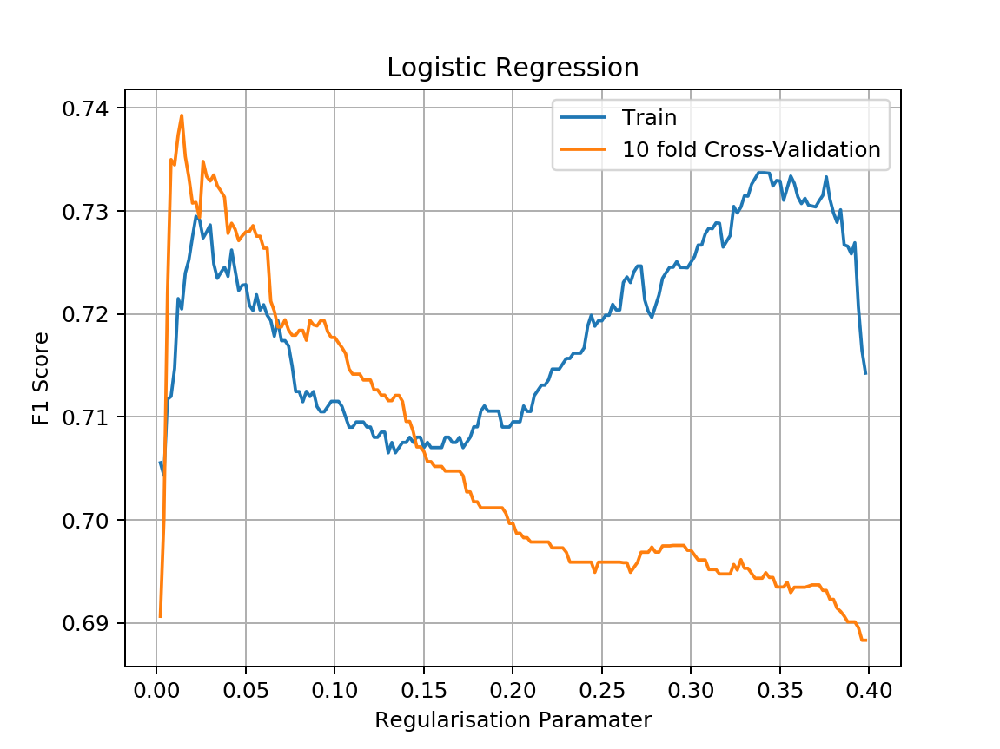

In [483]:
plt.figure()
plt.title("Logistic Regression")
plt.plot(Cs_log_2,train_log_2,label="Train")
plt.plot(Cs_log_2,val_log_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [473]:
index_log_2=val_log_2.index(np.max(val_log_2))
C_log_2=Cs_log_2[index_log_2]
C_log_2=0.026
print("Logistic alpha: ",C_log_2)

Logistic alpha:  0.026


In [474]:
penalty="elasticnet"
train_elas_2=[]
val_elas_2=[]
Cs_elas_2=np.arange(0.003,0.3,0.003)

for C in tqdm(Cs_elas_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(penalty=penalty,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_elas_2.append(train_r)
    val_elas_2.append(val_r)

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


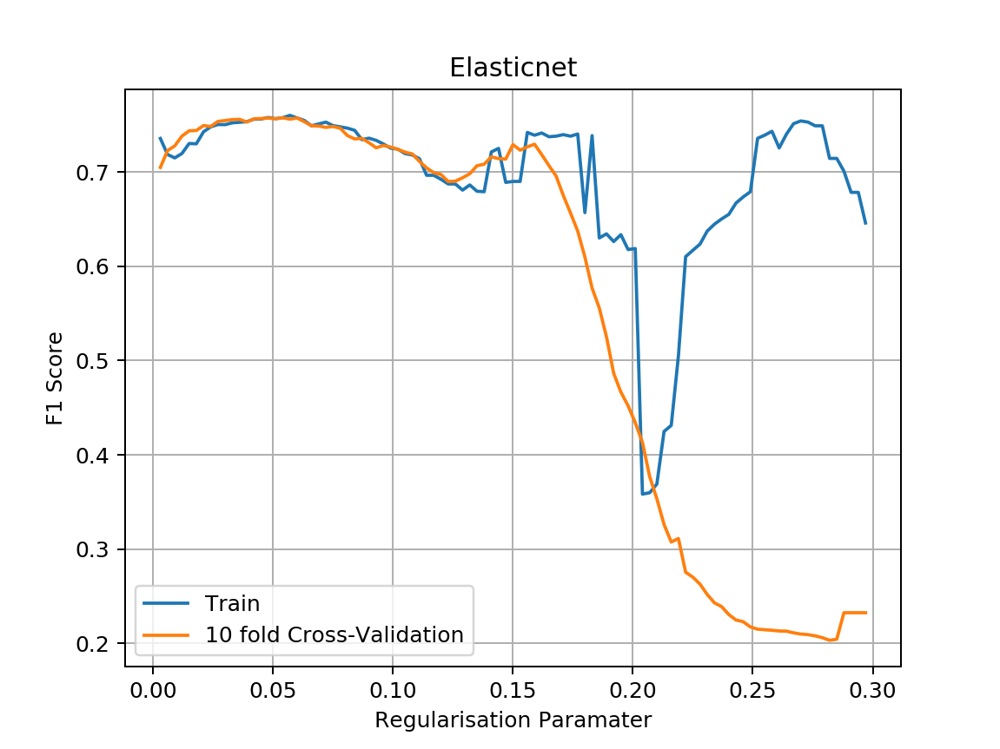

In [475]:
plt.figure()
plt.title("Elasticnet")
plt.plot(Cs_elas_2,train_elas_2,label="Train")
plt.plot(Cs_elas_2,val_elas_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [476]:
index_elas_2=val_elas_2.index(np.max(val_elas_2))
C_elas_2=Cs_elas_2[index_elas_2]
print("Elastic alpha: ",C_elas_2)

Elastic alpha:  0.054000000000000006


In [477]:
loss="squared_loss"
train_sq_2=[]
val_sq_2=[]
Cs_sq_2=np.arange(0.001,.4,0.001)

for C in tqdm(Cs_sq_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_sq_2.append(train_r)
    val_sq_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


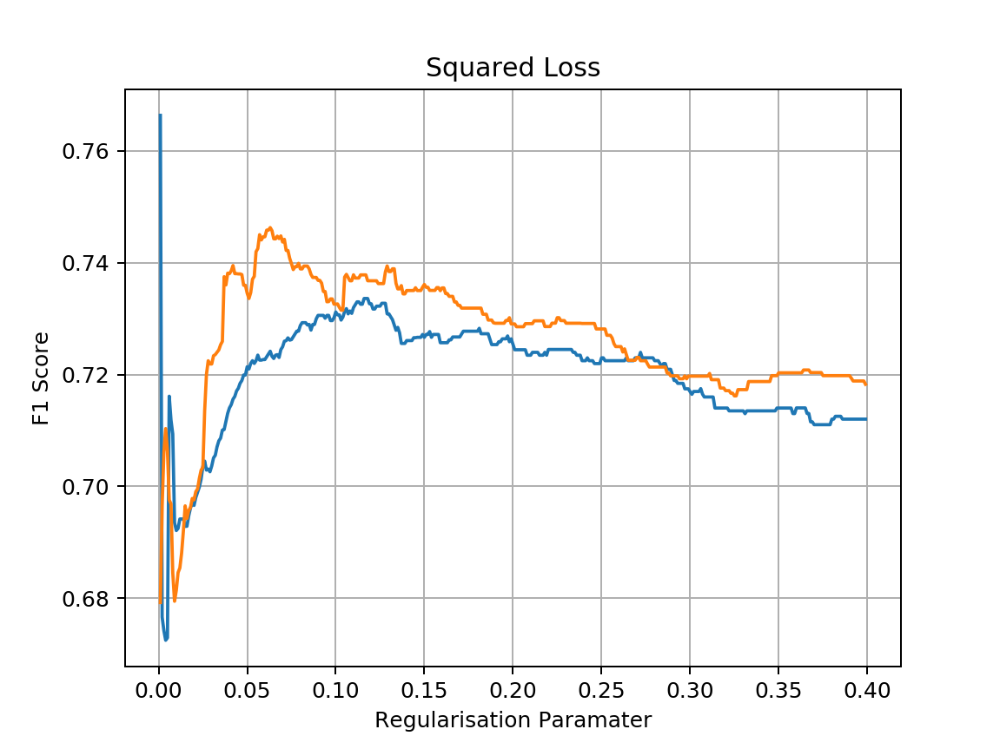

In [478]:
plt.figure()
plt.title("Squared Loss")
plt.plot(Cs_sq_2,train_sq_2,label="Train")
plt.plot(Cs_sq_2,val_sq_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [479]:
index_sq_2=val_sq_2.index(np.max(val_sq_2))
C_sq_2=Cs_sq_2[index_sq_2]
print("squared alpha : ",C_sq_2)

squared alpha :  0.063


In [480]:
train_norm_2=[]
val_norm_2=[]
Cs_norm_2=np.arange(0.001,0.1,0.001)
for C in tqdm(Cs_norm_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_norm_2.append(train_r)
    val_norm_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


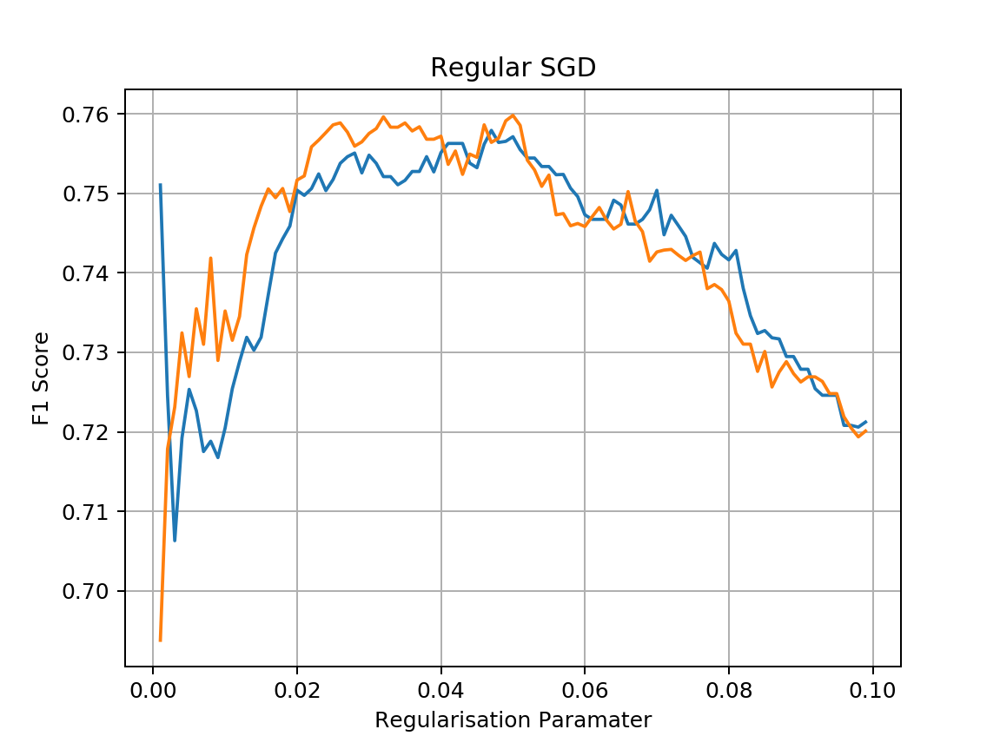

In [481]:
plt.figure()
plt.title("Regular SGD")
plt.plot(Cs_norm_2,train_norm_2,label="Train")
plt.plot(Cs_norm_2,val_norm_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [482]:
index_norm_2=val_norm_2.index(np.max(val_norm_2))
C_norm_2=Cs_norm_2[index_norm_2]
print("Normal alpha: ",C_norm_2)

Normal alpha:  0.05


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


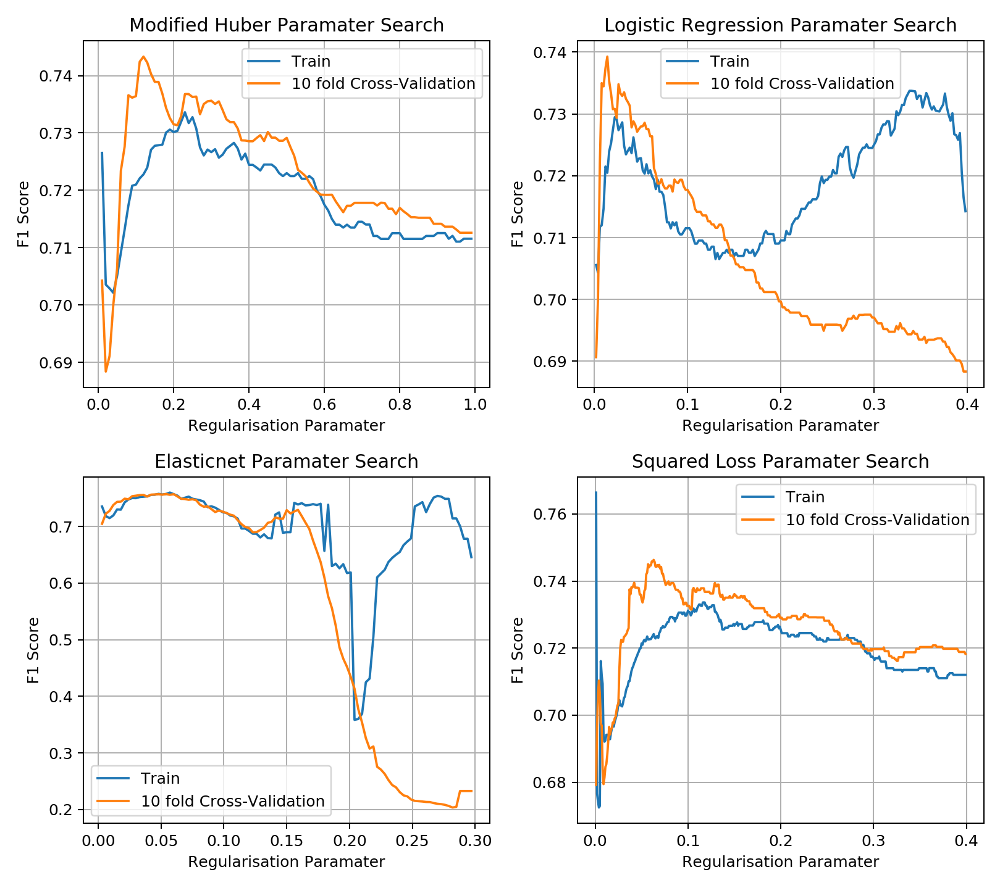

In [484]:
plt.figure(figsize=(9,8))



plt.subplot(2,2,1)
plt.title("Modified Huber Paramater Search")
plt.plot(Cs_huber_2,train_huber_2,label="Train")
plt.plot(Cs_huber_2,val_huber_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(2,2,2)
plt.title("Logistic Regression Paramater Search")
plt.plot(Cs_log_2,train_log_2,label="Train")
plt.plot(Cs_log_2,val_log_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(2,2,3)
plt.title("Elasticnet Paramater Search")
plt.plot(Cs_elas_2,train_elas_2,label="Train")
plt.plot(Cs_elas_2,val_elas_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(2,2,4)
plt.title("Squared Loss Paramater Search")
plt.plot(Cs_sq_2,train_sq_2,label="Train")
plt.plot(Cs_sq_2,val_sq_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.tight_layout()
plt.show()

In [298]:
clf=SGDClassifier(alpha=C_norm_2,class_weight="balanced",random_state=2).fit(X2,y2)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


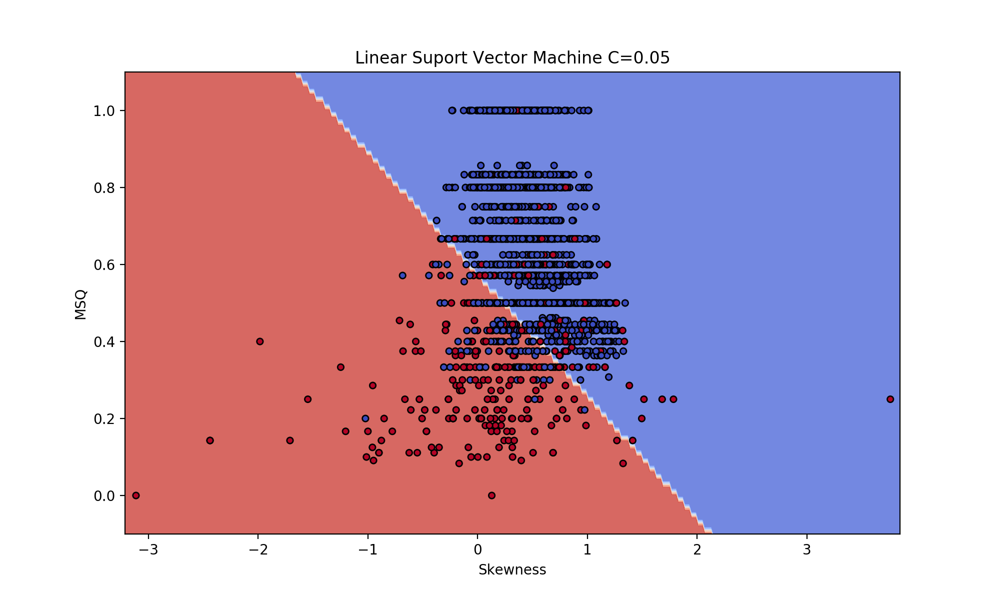

In [299]:
X0, X1 = X2["Skewness"].values, X2["MSQ"].values
fig, sub = plt.subplots(1, 1,figsize=(10,6))
ax = plt.gca()
xx, yy = make_meshgrid(X0, X1)
plot_contours(ax, clf, xx, yy,
              cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
ax.set_xlim(xx.min(), xx.max())
ax.set_ylim(yy.min(), yy.max())
ax.set_xlabel("Skewness")
ax.set_ylabel('MSQ')
ax.set_title("Linear Suport Vector Machine C={}".format(C_norm_2))
plt.show()

In [300]:
train_pred=clf.predict(X2)
train_f1=get_f1_score2(clf,X2,y2)

print("Train f1: ",train_f1)
train_pre=get_precision_score2(clf,X2,y2)

print("Train prec: ",train_pre)
train_rec=get_recall_score2(clf,X2,y2)

print("Train recall: ",train_rec)  

val_f1s= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
val_f1=val_f1s.mean()
stds_err_f1_svm_2=val_f1s.std()


val_pres= cross_val_score(clf, X2, y2,scoring=get_precision_score2, cv=10)
val_pre=val_pres.mean()
stds_err_prec_svm_2=val_pres.std()


val_recs= cross_val_score(clf, X2, y2,scoring=get_recall_score2, cv=10)
val_rec=val_recs.mean()
stds_err_rec_svm_2=val_recs.std()


print("Val f1: {} +- {}".format(val_f1,stds_err_f1_svm_2))
print("Val prec: {} +- {}".format(val_pre,stds_err_prec_svm_2))
print("Val rec: {} +- {}".format(val_rec,stds_err_rec_svm_2))
print("")

Train f1:  0.7571269047593334
Train prec:  0.7526419507492175
Train recall:  0.7619700089761867
Val f1: 0.7598094683759976 +- 0.04870154078990857
Val prec: 0.7552246969355689 +- 0.05147246342913591
Val rec: 0.7665762480922288 +- 0.0481128201239108



In [301]:
columns=["Train Precision","Train Recall","Train F1","Val Precision","Val Recall","Val F1"]
indices=["SVM linear","SGD Ridge","SGD Elasticnet","SGD Modified Huber","SGD Log","SGD Squared Loss","SGD Perceptron"]

Results_Table2=pd.DataFrame(columns=columns,index=indices)
Results_Table2.loc["SVM linear"]=[train_pre*100,train_rec*100,train_f1*100,val_pre*100,val_rec*100,val_f1*100]
Results_Table2
errors_prec2=[]
errors_rec2=[]
errors_f2=[]
errors_prec2.append(stds_err_prec_svm_2)
errors_rec2.append(stds_err_rec_svm_2)
errors_f2.append(stds_err_f1_svm_2)


In [302]:
models4 = [
    RidgeClassifier(random_state=2,class_weight="balanced").fit(X2,y2),
    SGDClassifier(penalty="elasticnet",class_weight="balanced",random_state=2,alpha=C_elas_2).fit(X2,y2),
    SGDClassifier(loss="modified_huber",random_state=2,class_weight="balanced",alpha=C_huber_2).fit(X2,y2),
    SGDClassifier(loss="log",random_state=2,class_weight="balanced",alpha=C_log_2).fit(X2,y2),
    SGDClassifier(loss="squared_loss",random_state=2,class_weight="balanced",alpha=C_sq_2).fit(X2,y2),
    Perceptron(random_state=2,class_weight="balanced").fit(X2,y2),
]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


<IPython.core.display.Javascript object>


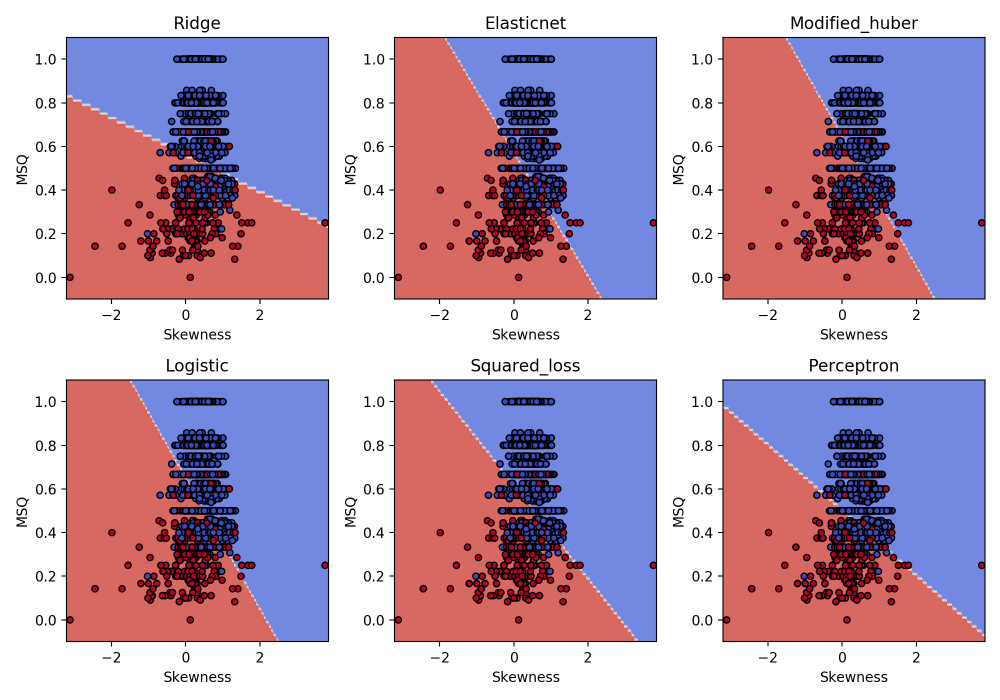

In [303]:
# title for the plots
titles3 = ('Ridge',
          'Elasticnet',
          'Modified_huber',
          'Logistic',
          'Squared_loss',
          'Perceptron',)

# Set-up 2x3 grid for plotting.
fig, sub = plt.subplots(2, 3,figsize=(10,7))
# plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)

# print("titles length: ",len(titles))
# print("models length: ",len(models))
# print("figures length: ",len(sub.flatten()))
colors = "bry"

for clf, title, ax in zip(models4, titles3, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
#     for i, color in zip(clf.classes_, colors):
#         plot_hyperplane(clf.coef_,clf.intercept_,i, color,ax)
    ax.set_xlabel('Skewness')
    ax.set_ylabel('MSQ')
    ax.set_title(title)
plt.tight_layout()
plt.show()

In [304]:
Training_F1s=[]
Training_Precisions=[]
Training_Recals=[]

Validation_F1s=[]
Validation_Precisions=[]
Validation_Recals=[]
stds_err_prec_sgd=[]
stds_err_rec_sgd=[]
stds_err_f1_sgd=[]
for clf,title in zip(models4,titles3):
    print(title)
    train_pred=clf.predict(X2)
    train_f1=get_f1_score2(clf,X2,y2)
    Training_F1s.append(train_f1)
    print("Train f1: ",train_f1)
    train_pre=get_precision_score2(clf,X2,y2)
    Training_Precisions.append(train_pre)
    print("Train prec: ",train_pre)
    train_rec=get_recall_score2(clf,X2,y2)
    Training_Recals.append(train_rec)
    print("Train recall: ",train_rec)  
    
    val_f1s= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_f1=val_f1s.mean()
    val_f1_std=val_f1s.std()
    Validation_F1s.append(val_f1)
    stds_err_f1_sgd.append(val_f1_std)
    
    val_pres= cross_val_score(clf, X2, y2,scoring=get_precision_score2, cv=10)
    val_pre=val_pres.mean()
    val_pre_std=val_pres.std()
    Validation_Precisions.append(val_pre)
    stds_err_prec_sgd.append(val_pre_std)
    
    val_recs= cross_val_score(clf, X2, y2,scoring=get_recall_score2, cv=10)
    val_rec=val_recs.mean()
    val_rec_std=val_recs.std()
    Validation_Recals.append(val_rec)
    stds_err_rec_sgd.append(val_rec_std)
    
    print("Val f1: {} +- {}".format(val_f1,val_f1_std))
    print("Val prec: {} +- {}".format(val_pre,val_pre_std))
    print("Val rec: {} +- {}".format(val_rec,val_rec_std))
    print("")

Ridge
Train f1:  0.6884575292671193
Train prec:  0.7582025229653669
Train recall:  0.6762662078075572
Val f1: 0.6881680019466951 +- 0.0298420223617914
Val prec: 0.7593934770439741 +- 0.045003040852886145
Val rec: 0.6771222871943524 +- 0.02678761023524177

Elasticnet
Train f1:  0.7574960218109702
Train prec:  0.7551107701290678
Train recall:  0.7599798655628475
Val f1: 0.7574313932872252 +- 0.046610905936749415
Val prec: 0.7546892558340901 +- 0.04987442501195119
Val rec: 0.7615938669671272 +- 0.04528436544265623

Modified_huber
Train f1:  0.731724445456089
Train prec:  0.7677340837955828
Train recall:  0.7129068223047685
Val f1: 0.7367813519180569 +- 0.039769539847853204
Val prec: 0.7613141043825619 +- 0.03932655347246357
Val rec: 0.7219334719482106 +- 0.03836255975494284

Logistic
Train f1:  0.727375745526839
Train prec:  0.7673691500268185
Train recall:  0.7082303329940381
Val f1: 0.734806584182764 +- 0.04148775975896037
Val prec: 0.7600522621725467 +- 0.04034930469821833
Val rec: 0.7

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Val f1: 0.6790121533990103 +- 0.18172074273519753
Val prec: 0.7009596157946942 +- 0.0818107205558588
Val rec: 0.7326998742994291 +- 0.23020391532202666



/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [305]:
for t_prec,t_recal,t_f1,v_prec,v_recal,v_f1,title in zip(Training_Precisions,Training_Recals,Training_F1s,Validation_Precisions,Validation_Recals,Validation_F1s,indices[1:]):
    Results_Table2.loc[title]=[t_prec*100,t_recal*100,t_f1*100,v_prec*100,v_recal*100,v_f1*100]

In [306]:
Results_Table2

,Train Precision,Train Recall,Train F1,Val Precision,Val Recall,Val F1
SVM linear,75.2642,76.197,75.7127,75.5225,76.6576,75.9809
SGD Ridge,75.8203,67.6266,68.8458,75.9393,67.7122,68.8168
SGD Elasticnet,75.5111,75.998,75.7496,75.4689,76.1594,75.7431
SGD Modified Huber,76.7734,71.2907,73.1724,76.1314,72.1933,73.6781
SGD Log,76.7369,70.823,72.7376,76.0052,71.9889,73.4807
SGD Squared Loss,77.5444,70.4543,72.4175,77.6959,72.9078,74.6298
SGD Perceptron,76.7025,78.5793,77.5763,70.096,73.27,67.9012


In [307]:
for prec,rec,f1 in zip(stds_err_prec_sgd,stds_err_rec_sgd,stds_err_f1_sgd):
    errors_prec2.append(prec)
    errors_rec2.append(rec)
    errors_f2.append(f1)

In [308]:
Errors_prec=[]
Errors_rec=[]
Errors_f1=[]
for e_prec,e_rec,e_f1 in zip(errors_prec2,errors_rec2,errors_f2):
    Errors_prec.append(e_prec*100)
    Errors_rec.append(e_rec*100)
    Errors_f1.append(e_f1*100)

In [313]:
Results_Table2

,Train Precision,Train Recall,Train F1,Val Precision,Val Recall,Val F1
SVM linear,75.2642,76.197,75.7127,75.5225,76.6576,75.9809
SGD Ridge,75.8203,67.6266,68.8458,75.9393,67.7122,68.8168
SGD Elasticnet,75.5111,75.998,75.7496,75.4689,76.1594,75.7431
SGD Modified Huber,76.7734,71.2907,73.1724,76.1314,72.1933,73.6781
SGD Log,76.7369,70.823,72.7376,76.0052,71.9889,73.4807
SGD Squared Loss,77.5444,70.4543,72.4175,77.6959,72.9078,74.6298
SGD Perceptron,76.7025,78.5793,77.5763,70.096,73.27,67.9012


In [315]:
# indices=["SVC Linear","SVC RBF","SGD Elastic","SGD Mod Huber","SGD Logistic","SGD Squared","SGD Percep","Decision Tree"]
# columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
All_Errors=[Errors_prec,Errors_rec,Errors_f1]
Results_Table_std_2=pd.DataFrame(columns=Results_Table2.columns,index=Results_Table2.index)
for c in Results_Table2.columns[:3]:
    for i in Results_Table2.index:
        Results_Table_std_2[c][i]="{0:2.2f}".format(Results_Table2[c][i])
for c,Errors in zip(Results_Table2.columns[3:],All_Errors):
    for i,Error in zip(Results_Table2.index,Errors):
        Results_Table_std_2[c][i]="{0:2.2f} $\pm$ {1:2.2f}".format(Results_Table2[c][i],Error)
        

In [317]:
Results_Table_std_2.to_csv("Results_Table_2.csv")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


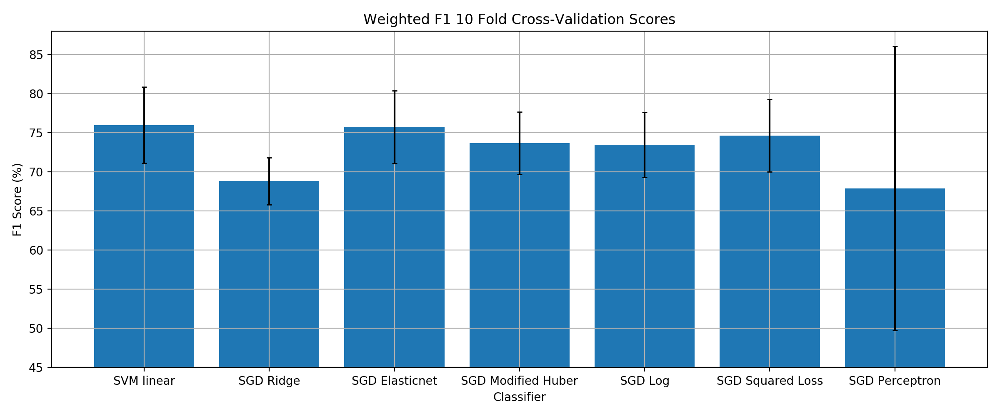

In [328]:
plt.figure(figsize=(12,5))
plt.title("Weighted F1 10 Fold Cross-Validation Scores")
plt.bar(indices,Results_Table2["Val F1"].values,yerr=Errors_f1,capsize=2)
plt.grid()
plt.xlabel("Classifier")
plt.ylabel("F1 Score (%)")
plt.ylim([45,88])
plt.tight_layout()
plt.show()

In [330]:
C_norm_2=0.05
C_sq_2=0.063
chosen_clf_2=SGDClassifier(loss="squared_loss",alpha=C_sq_2,class_weight="balanced",random_state=2).fit(X2,y2)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


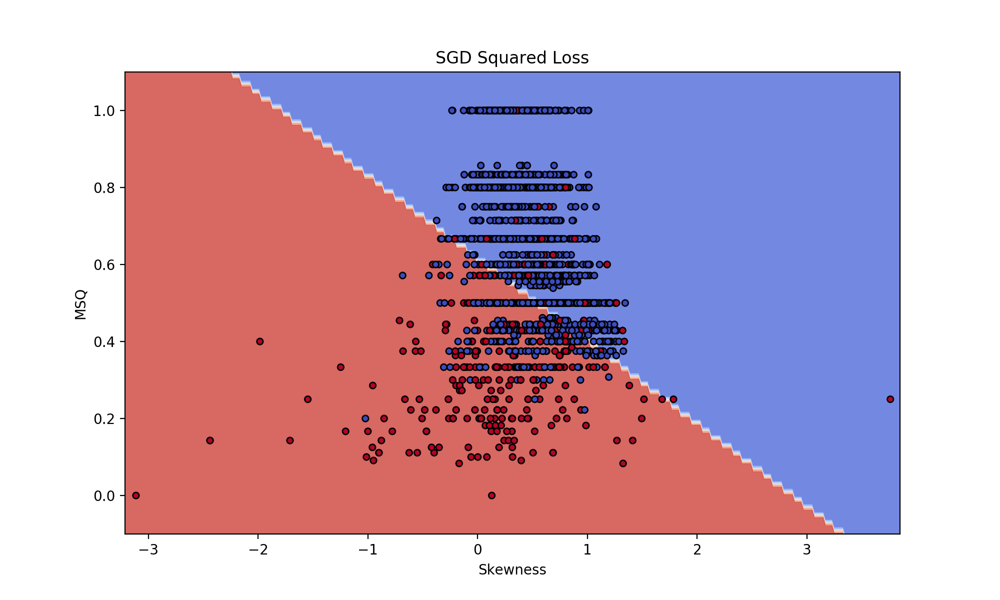

In [336]:
X0, X1 = X2["Skewness"].values, X2["MSQ"].values
fig, sub = plt.subplots(1, 1,figsize=(10,6))
ax = plt.gca()
xx, yy = make_meshgrid(X0, X1)
plot_contours(ax, chosen_clf_2, xx, yy,
              cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
ax.set_xlim(xx.min(), xx.max())
ax.set_ylim(yy.min(), yy.max())
ax.set_xlabel("Skewness")
ax.set_ylabel('MSQ')
ax.set_title("SGD Squared Loss")
plt.show()

In [333]:
train_pred=chosen_clf_2.predict(X2)
train_f1=get_f1_score2(chosen_clf_2,X2,y2)

print("Train f1: ",train_f1)
train_pre=get_precision_score2(chosen_clf_2,X2,y2)

print("Train prec: ",train_pre)
train_rec=get_recall_score2(chosen_clf_2,X2,y2)

print("Train recall: ",train_rec)  

val_f1s= cross_val_score(chosen_clf_2, X2, y2,scoring=get_f1_score2, cv=10)
val_f1=val_f1s.mean()
stds_err_f1_2=val_f1s.std()


val_pres= cross_val_score(chosen_clf_2, X2, y2,scoring=get_precision_score2, cv=10)
val_pre=val_pres.mean()
stds_err_prec_2=val_pres.std()


val_recs= cross_val_score(chosen_clf_2, X2, y2,scoring=get_recall_score2, cv=10)
val_rec=val_recs.mean()
stds_err_rec_2=val_recs.std()


print("Val f1: {} +- {}".format(val_f1,stds_err_f1_2))
print("Val prec: {} +- {}".format(val_pre,stds_err_prec_2))
print("Val rec: {} +- {}".format(val_rec,stds_err_rec_2))
print("")

Train f1:  0.7241754814332945
Train prec:  0.7754435218315262
Train recall:  0.7045429336344982
Val f1: 0.7462982447246475 +- 0.046219502329059796
Val prec: 0.7769593176196321 +- 0.04762572607617466
Val rec: 0.729077912137674 +- 0.04366245112581116



In [166]:

def predict_sample_2(sample,coefficients,intercepts):
    Score1=coefficients[0][0]*sample[0]+coefficients[0][1]*sample[1]+intercepts[0]
    Scores=[0,Score1]
    return Scores.index(np.max(Scores))

def predict_set_2(X2,coefficients,intercepts):
    predictions=[]
    for index in X2.index:
        predictions.append(predict_sample_2(X2.loc[index].values,coefficients,intercepts))
    return predictions

In [334]:
coefficients_2=chosen_clf_2.coef_
intercepts_2=chosen_clf_2.intercept_
train_pred=chosen_clf_2.predict(X2)
train_est=predict_set_2(X2,coefficients_2,intercepts_2)

In [335]:
print(coefficients_2)
print(intercepts_2)

[[-0.23720892 -1.10489991]]
[0.68119408]


In [172]:
test_pred=chosen_clf_2.predict(Xtest2)
train_pred=chosen_clf_2.predict(X2)
print(classification_report(train_pred,y2,target_names=["AB","C"]))
print(classification_report(test_pred,ytest2,target_names=["AB","C"]))

report2=classification_report(test_pred,ytest2,target_names=["AB","C"],output_dict=True)
Report2=pd.DataFrame.from_dict(report2)
Report2=Report2.apply(percentage)
Report2=Report2.T
Report2.to_csv("Test_Report_2.csv",float_format="%.2f")

              precision    recall  f1-score   support

          AB       0.91      0.91      0.91      1605
           C       0.59      0.62      0.60       354

    accuracy                           0.85      1959
   macro avg       0.75      0.76      0.76      1959
weighted avg       0.86      0.85      0.85      1959

              precision    recall  f1-score   support

          AB       0.91      0.89      0.90      1061
           C       0.58      0.62      0.60       246

    accuracy                           0.84      1307
   macro avg       0.74      0.76      0.75      1307
weighted avg       0.85      0.84      0.85      1307



In [ ]:
plt.figure()
ax=plt.subplot()
class_names=["AB","C"]
# cm=confusion_matrix(y_test,test_est)


disp=plot_confusion_matrix(chosen_clf_2, Xtest2, ytest2,
                                 display_labels=class_names,
                                 cmap=plt.cm.Blues,ax=ax)

plt.title("Confusion matrix for two class classifier")

plt.show()

# Timing Tests:

In [176]:
lowcut=0.5
highcut=30
fs=125
b , a = butter_bandpass(lowcut, highcut, fs, order=4)

def classify_from_raw3(raw_sig,b,a,coefficients,intercepts):
    detrend_sig=detrend(filt_pipeline(raw_sig,b,a,period=375))
    tmp_sk = analysis.skew1(detrend_sig)
    tmp_msq = get_msq(detrend_sig)
    tmp_class=predict_sample([tmp_sk,tmp_msq],coefficients,intercepts)
    return tmp_class

def classify_from_raw2(raw_sig,b,a,coefficients,intercepts):
    detrend_sig=detrend(filt_pipeline(raw_sig,b,a,period=375))
    tmp_sk = analysis.skew1(detrend_sig)
    tmp_msq = get_msq(detrend_sig)
    tmp_class=predict_sample_2([tmp_sk,tmp_msq],coefficients,intercepts)
    return tmp_class




In [110]:
Vietnam_Raw_Data.columns=["Vietnam_{}".format(i) for i in range(len(Vietnam_Raw_Data.columns))]
MIMIC_Raw_Data.columns=["MIMIC_{}".format(i) for i in range(len(MIMIC_Raw_Data.columns))]

In [155]:
rand_MIMIC_List=random.sample(list(MIMIC_Raw_Data.columns),10)
rand_Vietnam_List=random.sample(list(Vietnam_Raw_Data.columns),10)
rand_Omar_List=random.sample(list(Omar_Raw_Data.columns),10)
rand_Stefan_List=random.sample(list(Stefan_Raw_Data.columns),10)
print("MIMIC: ",rand_MIMIC_List)
print("Vietnam: ",rand_Vietnam_List)
print("Omar: ",rand_Omar_List)
print("Stefan: ",rand_Stefan_List)
All_Lists=[rand_MIMIC_List,rand_Vietnam_List,rand_Omar_List,rand_Stefan_List]
All_Data=[MIMIC_Raw_Data,Vietnam_Raw_Data,Omar_Raw_Data,Stefan_Raw_Data]

MIMIC:  ['MIMIC_2388', 'MIMIC_2104', 'MIMIC_430', 'MIMIC_2237', 'MIMIC_1672', 'MIMIC_1376', 'MIMIC_1429', 'MIMIC_1495', 'MIMIC_2346', 'MIMIC_2355']
Vietnam:  ['Vietnam_126', 'Vietnam_33', 'Vietnam_57', 'Vietnam_70', 'Vietnam_58', 'Vietnam_43', 'Vietnam_91', 'Vietnam_36', 'Vietnam_120', 'Vietnam_81']
Omar:  ['Omar_15', 'Omar_207', 'Omar_103', 'Omar_29', 'Omar_291', 'Omar_163', 'Omar_124', 'Omar_129', 'Omar_290', 'Omar_222']
Stefan:  ['Stefan_Wrist LED 2_2', 'Stefan_57', 'Stefan_43', 'Stefan_37', 'Stefan_Wrist LED 3_14', 'Stefan_Wrist LED 2_0', 'Stefan_26', 'Stefan_30', 'Stefan_Finger LED 2_0', 'Stefan_45']


In [181]:
lowcut=0.5
highcut=30
coefficients=chosen_clf.coef_
intercepts=chosen_clf.intercept_
test_time=[]
test_dev=[]
with tqdm(total=40) as pbar:
    for List,Raw_Data in zip(All_Lists,All_Data):
        fs=Raw_Data[List[0]].shape[0]/3
        b , a = butter_bandpass(lowcut, highcut, fs, order=4)
        for sample in List:
            t=%timeit -o -q -p 5 -r 20 classify_from_raw3(Raw_Data[sample].values,b,a,coefficients,intercepts)
            test_time.append(t.average)
            test_dev.append(t.stdev**2)
            pbar.update(1)

In [182]:
lowcut=0.5
highcut=30
coefficients=chosen_clf_2.coef_
intercepts=chosen_clf_2.intercept_
test_time2=[]
test_dev2=[]
with tqdm(total=40) as pbar:
    for List,Raw_Data in zip(All_Lists,All_Data):
        fs=Raw_Data[List[0]].shape[0]/3
        b , a = butter_bandpass(lowcut, highcut, fs, order=4)
        for sample in List:
            t=%timeit -o -q -p 5 -r 20 classify_from_raw2(Raw_Data[sample].values,b,a,coefficients,intercepts)
            test_time2.append(t.average)
            test_dev2.append(t.stdev**2)
            pbar.update(1)

<IPython.core.display.Javascript object>


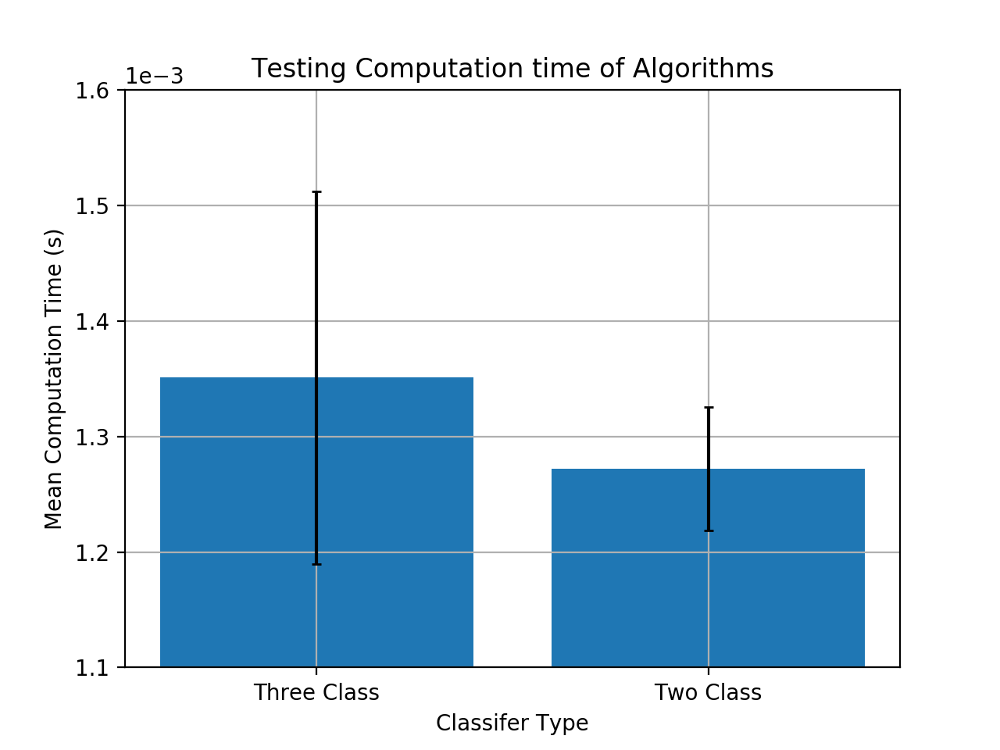

(0.0011, 0.0016)

In [188]:
Time1=np.mean(test_time)
Dev1=np.sqrt(np.mean(test_dev))
Time2=np.mean(test_time2)
Dev2=np.sqrt(np.mean(test_dev2))
plt.figure()
plt.ticklabel_format(axis="y", style="sci",scilimits=(-3,-3))
plt.bar(["Three Class","Two Class"],[Time1,Time2],yerr=[Dev1,Dev2],capsize=2)
plt.xlabel("Classifer Type")
plt.ylabel("Mean Computation Time (s)")
plt.title("Testing Computation time of Algorithms")
plt.grid()
plt.ylim([0.0011,0.0016])

## Linear Classification:

In [ ]:
len(good_predicted)

In [ ]:
len(bad_predicted)

In [ ]:
All_Data = pd.concat([Full_Data,AFE_Filtered_Data],axis=1)
num_1 = random.sample(list(good_predicted),1)
num_2 = random.sample(list(bad_predicted),1)
print(num_1[0])
print(num_2[0])
fig, (ax1, ax2) = plt.subplots(1, 2)
All_Data[num_1[0]].plot(ax=ax1)
ax1.title.set_text('Good Sample')
All_Data[num_2[0]].plot(ax=ax2)
ax2.title.set_text('Bad Sample')
plt.show()

In [ ]:
X=All_Scores
y = []
for label in All_labels["Label"]:
    if(label=="A"):
        y.append(0)
    if(label=="B"):
        y.append(1)
    if(label=="C"):
        y.append(2)

In [ ]:
def predict(Scores,sk,msq):
    predictions=[]
    for col in Scores.index:
        if Scores["Skewness"][col]>sk and Scores["MSQ"][col]>msq:
            predictions.append(0)
        else:
            predictions.append(1)
    return predictions

def predict3(Scores,sk1,sk2,msq):
    predictions=[]
    for col in Scores.index:
        if  Scores["MSQ"][col]>msq:
            if Scores["Skewness"][col]>sk1:
                predictions.append(0)
            elif Scores["Skewness"][col]>sk2:
                predictions.append(1)
            else:
                predictions.append(2)
        else:
            predictions.append(2)
    return predictions

def acc(pred,y):
    correct=0
    for i in range(len(pred)):
        if pred[i]==y[i]:
            correct+=1
    return correct/len(y)

def get_accuracy_3class(pred,y):
    As= [i for i in range(len(y)) if y[i]==0]
    Bs= [i for i in range(len(y)) if y[i]==1]
    Cs= [i for i in range(len(y)) if y[i]==2]
    a=0
    b=0
    c=0
    for p,label in zip(pred,y):
        if label==0:
            if p==label:
                a+=1
        elif label==1:
            if p==label:
                b+=1
        elif label ==2:
            if p==label:
                c+=1
    return a/len(As), b/len(Bs) , c/len(Cs)
                
def get_accuracy_2class(pred,y):
    zeros= [i for i in range(len(y)) if y[i]==0]
    ones= [i for i in range(len(y)) if y[i]==1]
    zero=0
    one=0
    for p,label in zip(pred,y):
        if label==0:
            if p==label:
                zero+=1
        elif label==1:
            if p==label:
                one+=1
    return zero/len(zeros),one/len(ones)   

In [ ]:
# pred = predict3(All_Scores,0.58,0.37,0.4)
pred = predict3(All_Scores,0.58,0.37,0.4)
print("pred length: ",len(pred))
print("y length: ",len(y))
get_accuracy_3class(pred,y)
# print("Bad Sample accuracy: {} , Good Sample accuracy: {} ".format(accs[0],accs[1]))

## SVM Classifier

In [192]:
from sklearn.model_selection import cross_val_score

### Functions required:

In [97]:
def make_meshgrid(x, y, h=.02):
    """Create a mesh of points to plot in

    Parameters
    ----------
    x: data to base x-axis meshgrid on
    y: data to base y-axis meshgrid on
    h: stepsize for meshgrid, optional

    Returns
    -------
    xx, yy : ndarray
    """
    x_min, x_max = x.min()-0.1, x.max()+0.1 
    y_min, y_max = y.min()-0.1, y.max()+0.1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))
    return xx, yy

def plot_contours(ax, clf, xx, yy, **params):
    """Plot the decision boundaries for a classifier.

    Parameters
    ----------
    ax: matplotlib axes object
    clf: a classifier
    xx: meshgrid ndarray
    yy: meshgrid ndarray
    params: dictionary of params to pass to contourf, optional
    """
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    out = ax.contourf(xx, yy, Z, **params)
    return out

## 3 Classes 

In [3607]:
train_scores

,Skewness,Kurtosis,Entropy,Zeros,MSQ,SNR,Relative_Power,mean_Skewness,mean_Kurtosis,mean_Entropy,...,median_Relative_Power,std_Skewness,std_Kurtosis,std_Entropy,std_SNR,std_Relative_Power,AC_loc1,AC_peak1,AC_loc2,AC_peak2
MIMIC_775,0.545448,-0.898156,5.780437,0.024000,1.000000,3.551156,0.761015,0.410386,-1.168065,4.291057,...,0.732170,0.123350,0.024478,0.020954,0.472194,0.010570,84,0.953156,167,0.950075
MIMIC_2390,1.204559,0.389113,5.645754,0.032000,1.000000,2.488205,0.385338,-0.062777,-1.204585,3.606587,...,0.000000,0.310758,0.409953,0.127941,1.059750,0.000000,45,0.080761,90,0.952044
Vietnam_75,0.116644,-0.880757,5.728975,0.026667,0.800000,3.203567,0.735511,-0.011650,-0.986398,4.178711,...,0.599274,0.147646,0.146306,0.036168,0.390984,0.070164,76,0.908330,153,0.881144
MIMIC_427,-0.009536,-1.002045,5.786584,0.021333,1.000000,3.632957,0.770833,0.007671,-1.255974,4.323768,...,0.786804,0.006310,0.056395,0.023373,0.138471,0.019505,88,0.893703,176,0.860756
MIMIC_2501,0.671354,-0.881972,5.572505,0.018667,0.600000,3.910750,0.839731,0.335166,-1.313604,4.327847,...,0.721032,0.139687,0.037554,0.026005,0.870442,0.019299,101,0.804259,201,0.933360
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MIMIC_2384,0.965816,0.350812,5.821468,0.040000,1.000000,2.396235,0.354742,0.046053,-0.903834,3.865477,...,0.000000,0.613373,0.545598,0.266520,1.370102,0.177225,44,0.104821,91,0.706712
Vietnam_3,0.330471,-0.556068,5.729151,0.034667,0.833333,2.749334,0.661860,0.026059,-0.840212,3.921391,...,0.463966,0.309233,0.058224,0.296948,0.688339,0.212942,34,-0.256934,71,0.797641
MIMIC_1996,0.233650,-1.250471,5.719109,0.026667,0.800000,4.283399,0.832988,0.385161,-1.249358,4.200767,...,0.622902,0.059401,0.156065,0.106300,1.008330,0.044194,85,0.920905,171,0.876589
MIMIC_1975,0.377820,-1.047009,5.675620,0.024000,1.000000,3.746100,0.797228,0.342783,-1.245525,4.244122,...,0.704512,0.049739,0.177481,0.056944,1.328572,0.078931,85,0.795931,169,0.769537


In [2040]:
scaler.fit(train_scores)
train_scaled_scores = scaler.transform(train_scores)
train_scaled_scores = pd.DataFrame(train_scaled_scores,columns=train_scores.columns,index=train_scores.index)
test_scaled_scores= scaler.transform(test_scores)
test_scaled_scores = pd.DataFrame(test_scaled_scores,columns=test_scores.columns,index=test_scores.index)

In [72]:
X = train_scores[["Skewness","MSQ"]]
y=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y.append(0)
    if(label=="B"):
        y.append(1)
    if(label=="C"):
        y.append(2)

X_test = test_scores[["Skewness","MSQ"]]
y_test=[]
for label in test_labels["Label"]:
    if(label=="A"):
        y_test.append(0)
    if(label=="B"):
        y_test.append(1)
    if(label=="C"):
        y_test.append(2)
print("X shape: {}".format(X.shape[0]))
print("y shape: {}".format(len(y)))

X shape: 1959
y shape: 1959


In [73]:
def get_f1_score(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A","B","C"],output_dict=True)["macro avg"]["f1-score"]

def get_precision_score(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A","B","C"],output_dict=True)["macro avg"]["precision"]
                                                                                                     
def get_recall_score(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A","B","C"],output_dict=True)["macro avg"]["recall"] 

In [3769]:
train_f1s_1=[]
val_f1s_1=[]
Cs=np.arange(1.0,100.0,1.0)

for C in tqdm(Cs):
    print("Regularisation: ",C)
    
    clf=svm.SVC(kernel='linear', C=C ,class_weight="balanced",random_state=2).fit(X,y)
    
    train_r=get_f1_score(clf,X,y)
    print("Train f1: ",train_r)
    val_rs= cross_val_score(svm.SVC(kernel='linear', C=C,class_weight="balanced",random_state=2), X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
    print("Val f1: ",val_r)
    train_f1s_1.append(train_r)
    val_f1s_1.append(val_r)
    print("")


Regularisation:  1.0
Train f1:  0.6517606777461045
Val f1:  0.6514301088975262

Regularisation:  2.0
Train f1:  0.6523973701498321
Val f1:  0.6522252306238225

Regularisation:  3.0
Train f1:  0.6531044117015735
Val f1:  0.6526651550977904

Regularisation:  4.0
Train f1:  0.6523891123967682
Val f1:  0.6540850124551959

Regularisation:  5.0
Train f1:  0.6534459394520001
Val f1:  0.6549522681081983

Regularisation:  6.0
Train f1:  0.6537644501689764
Val f1:  0.6549522681081983

Regularisation:  7.0
Train f1:  0.6538007870758348
Val f1:  0.6553144002868746

Regularisation:  8.0
Train f1:  0.6541536419703039
Val f1:  0.6553144002868746

Regularisation:  9.0
Train f1:  0.6541536419703039
Val f1:  0.6547155272813379

Regularisation:  10.0
Train f1:  0.6541536419703039
Val f1:  0.6543762417705492

Regularisation:  11.0
Train f1:  0.6543746567257163
Val f1:  0.6543762417705492

Regularisation:  12.0
Train f1:  0.6543746567257163
Val f1:  0.6548106306725997

Regularisation:  13.0
Train f1:  0.65

<IPython.core.display.Javascript object>


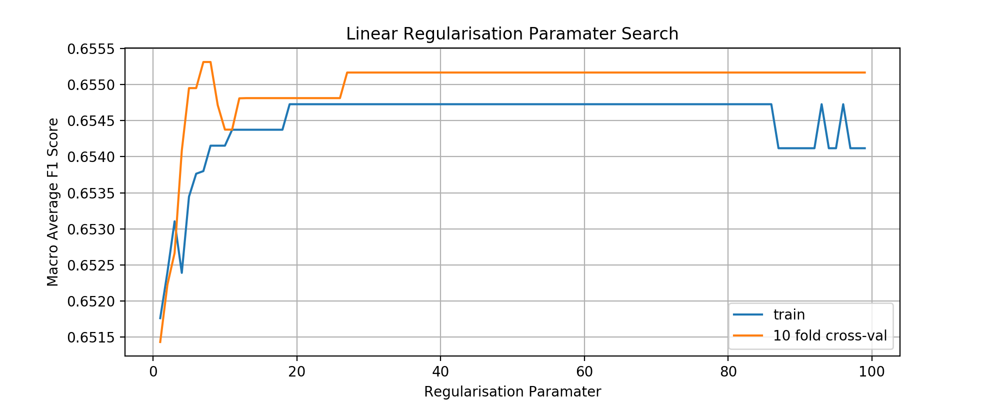

In [3770]:
plt.figure(figsize=(10,4))
plt.title("Linear Regularisation Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Macro Average F1 Score")
plt.plot(Cs,train_f1s_1,label="train")
plt.plot(Cs,val_f1s_1,label="10 fold cross-val")
plt.grid()
plt.legend()
plt.show()

In [3681]:
np.max(val_f1s_1)
index=val_f1s_1.index(np.max(val_f1s_1))
print(Cs[index])
C_linear=Cs[index]

43.0


In [3672]:
C_linear=Cs[index]

In [3682]:
clf = svm.SVC(kernel='linear',class_weight="balanced",C=C_linear).fit(X,y)

<IPython.core.display.Javascript object>


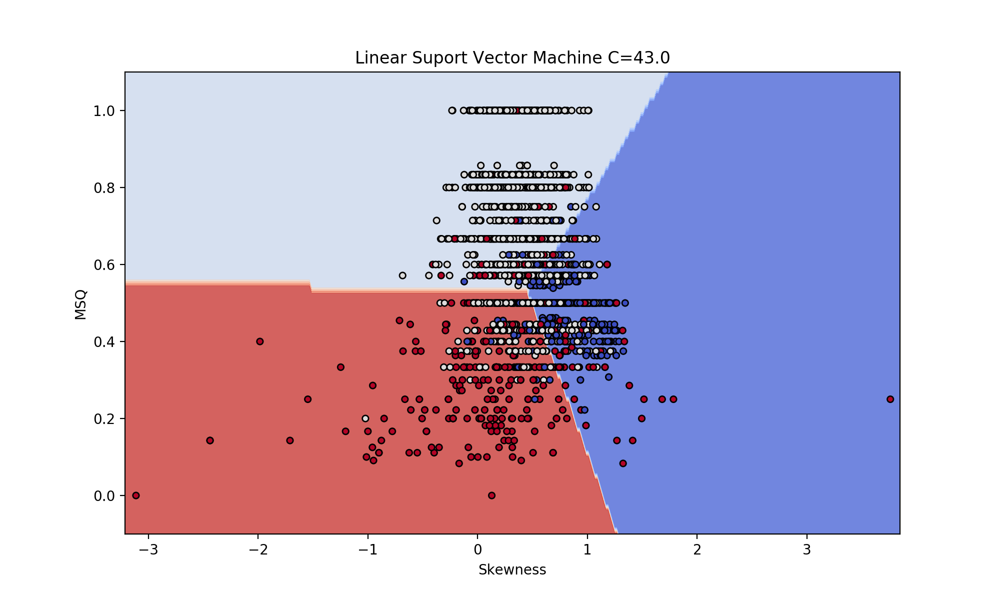

In [3683]:
X0, X1 = X["Skewness"].values, X["MSQ"].values
fig, sub = plt.subplots(1, 1,figsize=(10,6))
ax = plt.gca()
xx, yy = make_meshgrid(X0, X1)
plot_contours(ax, clf, xx, yy,
              cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
ax.set_xlim(xx.min(), xx.max())
ax.set_ylim(yy.min(), yy.max())
ax.set_xlabel("Skewness")
ax.set_ylabel('MSQ')
ax.set_title("Linear Suport Vector Machine C={}".format(C_linear))
plt.show()

In [2082]:
dict_models=[{"classifier":svm.SVC,"kernel":"linear"},
             {"classifier":svm.SVC,"kernel":"rbf"},
#              {"classifier":svm.SVC,"kernel":"poly"},
            ]

In [3675]:
train_f1s_2=[]
val_f1s_2=[]
Cs2=np.arange(0.01,3.0,0.01)

for C in tqdm(Cs2):
    print("Regularisation: ",C)
    
    clf=svm.SVC(kernel='rbf', C=C ,class_weight="balanced",random_state=2).fit(X,y)
    
    train_r=get_f1_score(clf,X,y)
    print("Train f1: ",train_r)
    val_rs= cross_val_score(svm.SVC(kernel='rbf', C=C,class_weight="balanced",random_state=2), X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
    print("Val f1: ",val_r)
    train_f1s_2.append(train_r)
    val_f1s_2.append(val_r)
    print("")


Regularisation:  0.01
Train f1:  0.632471581884753
Val f1:  0.6310585644298445

Regularisation:  0.02
Train f1:  0.6406529226402641
Val f1:  0.638896281396092

Regularisation:  0.03
Train f1:  0.6438040562899766
Val f1:  0.6388006959249245

Regularisation:  0.04
Train f1:  0.6504289554356165
Val f1:  0.6414265186215631

Regularisation:  0.05
Train f1:  0.6549996848611243
Val f1:  0.6496295405994545

Regularisation:  0.060000000000000005
Train f1:  0.6544790776335704
Val f1:  0.6509744439341896

Regularisation:  0.06999999999999999
Train f1:  0.6548281511541524
Val f1:  0.652699302539723

Regularisation:  0.08
Train f1:  0.655331866781475
Val f1:  0.6529458598561708

Regularisation:  0.09
Train f1:  0.6569893885054453
Val f1:  0.6534736313501817

Regularisation:  0.09999999999999999
Train f1:  0.6591724341624889
Val f1:  0.6546264563834608

Regularisation:  0.11
Train f1:  0.6595676573853594
Val f1:  0.6538412075792316

Regularisation:  0.12
Train f1:  0.6582177845860187
Val f1:  0.6548

Val f1:  0.6680427014311416

Regularisation:  0.99
Train f1:  0.6677560182684158
Val f1:  0.6680427014311416

Regularisation:  1.0
Train f1:  0.6677560182684158
Val f1:  0.6687834446951918

Regularisation:  1.01
Train f1:  0.6677560182684158
Val f1:  0.6687834446951918

Regularisation:  1.02
Train f1:  0.6677560182684158
Val f1:  0.6687834446951918

Regularisation:  1.03
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.04
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.05
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.06
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.07
Train f1:  0.6681985422808561
Val f1:  0.6687834446951918

Regularisation:  1.08
Train f1:  0.6681985422808561
Val f1:  0.6692239428852298

Regularisation:  1.09
Train f1:  0.6681985422808561
Val f1:  0.6692239428852298

Regularisation:  1.1
Train f1:  0.6681985422808561
Val f1:  0.6692239428852298

R

Val f1:  0.6684758437323575

Regularisation:  1.98
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  1.99
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.0
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.01
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.02
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.03
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.04
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.05
Train f1:  0.6717296842094429
Val f1:  0.6680595759594254

Regularisation:  2.0599999999999996
Train f1:  0.6717296842094429
Val f1:  0.6676793965733616

Regularisation:  2.07
Train f1:  0.6717296842094429
Val f1:  0.6676793965733616

Regularisation:  2.0799999999999996
Train f1:  0.6717296842094429
Val f1:  0.6670077197504914

Regularisation:  2.09
Train f1:  0.6717296842094429
V

Val f1:  0.6662203695073972

Regularisation:  2.94
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.9499999999999997
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.96
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.9699999999999998
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.98
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972

Regularisation:  2.9899999999999998
Train f1:  0.6726310618996431
Val f1:  0.6662203695073972




<IPython.core.display.Javascript object>


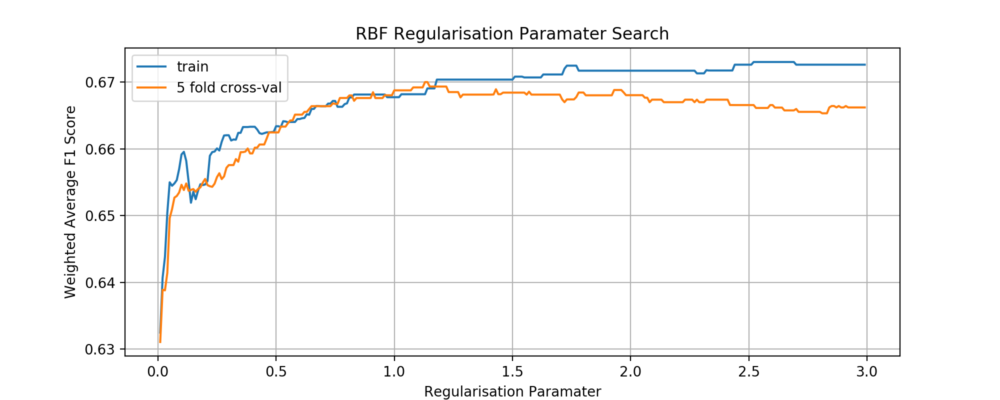

In [3676]:
plt.figure(figsize=(10,4))
plt.title("RBF Regularisation Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs2,train_f1s_2,label="train")
plt.plot(Cs2,val_f1s_2,label="5 fold cross-val")
plt.grid()
plt.legend()
plt.show()

In [3677]:
np.max(val_f1s_2)
index2=val_f1s_2.index(np.max(val_f1s_2))
print(Cs2[index2])
C_rbf=Cs2[index2]

1.1300000000000001


In [3678]:
train_f1s_3=[]
val_f1s_3=[]
Cs3=np.arange(1.0,500.0,10.0)

for C in tqdm(Cs3):
    print("Regularisation: ",C)
    
    clf=svm.SVC(kernel='poly',gamma="auto",degree=4, C=C,class_weight="balanced",random_state=2).fit(X,y)
    
    train_r=get_f1_score(clf,X,y)
    print("Train f1: ",train_r)
    val_rs= cross_val_score(svm.SVC(kernel='poly',gamma="auto",degree=4, C=C,class_weight="balanced",random_state=2), X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
    print("Val f1: ",val_r)
    train_f1s_3.append(train_r)
    val_f1s_3.append(val_r)
    print("")


Regularisation:  1.0
Train f1:  0.5790175286221876
Val f1:  0.5663900354654665

Regularisation:  11.0
Train f1:  0.6194427049016072
Val f1:  0.6141609345136114

Regularisation:  21.0
Train f1:  0.6218066354956401
Val f1:  0.6181186681005064

Regularisation:  31.0
Train f1:  0.6227065545779301
Val f1:  0.6193456407066918

Regularisation:  41.0
Train f1:  0.6236864142858245
Val f1:  0.6193733393379465

Regularisation:  51.0
Train f1:  0.6240570323878522
Val f1:  0.6190341472849725

Regularisation:  61.0
Train f1:  0.6268183508402801
Val f1:  0.6179765362859417

Regularisation:  71.0
Train f1:  0.6242591925550744
Val f1:  0.6175890330002175

Regularisation:  81.0
Train f1:  0.623428779125682
Val f1:  0.6175741585127732

Regularisation:  91.0
Train f1:  0.622529493635543
Val f1:  0.6164547480083309

Regularisation:  101.0
Train f1:  0.6214168592248045
Val f1:  0.6151840373169917

Regularisation:  111.0
Train f1:  0.6218639040646642
Val f1:  0.6155586274939864

Regularisation:  121.0
Train 

<IPython.core.display.Javascript object>


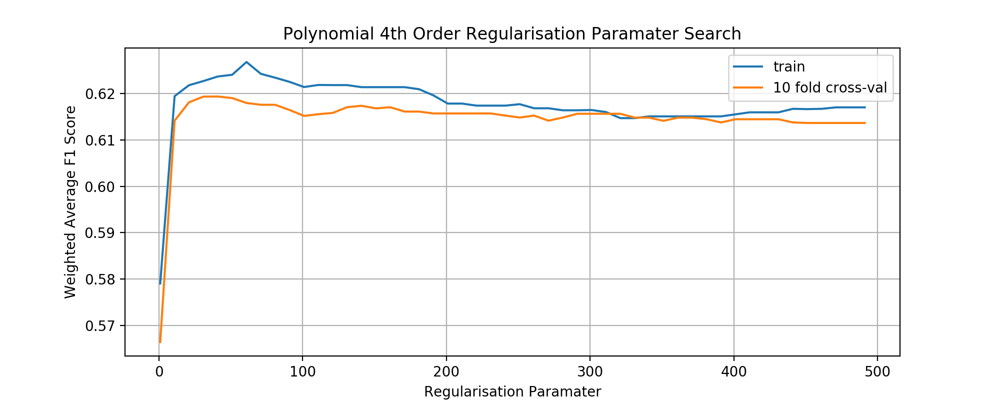

In [3679]:
plt.figure(figsize=(10,4))
plt.title("Polynomial 4th Order Regularisation Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs3,train_f1s_3,label="train")
plt.plot(Cs3,val_f1s_3,label="10 fold cross-val")
plt.grid()
plt.legend()
plt.show()

In [3680]:
np.max(val_f1s_3)
index3=val_f1s_3.index(np.max(val_f1s_3))
print(Cs3[index3])
C_poly=Cs3[index3]

41.0


In [3699]:
# # we create an instance of SVM and fit out data. We do not scale our
# # data since we want to plot the support vectors
C1 = 43.0 # SVM regularization parameter
C2 = 2.69 
# C3 = 400.0
models1 = [svm.SVC(kernel='linear',class_weight="balanced",C=C_linear,random_state=2).fit(X,y),
          svm.SVC(kernel='rbf',class_weight="balanced",C=C_rbf,random_state=2).fit(X,y),
          svm.SVC(kernel='poly', degree=4, gamma='auto',max_iter=10000,class_weight="balanced",C=C_poly,random_state=2).fit(X,y)]

<IPython.core.display.Javascript object>


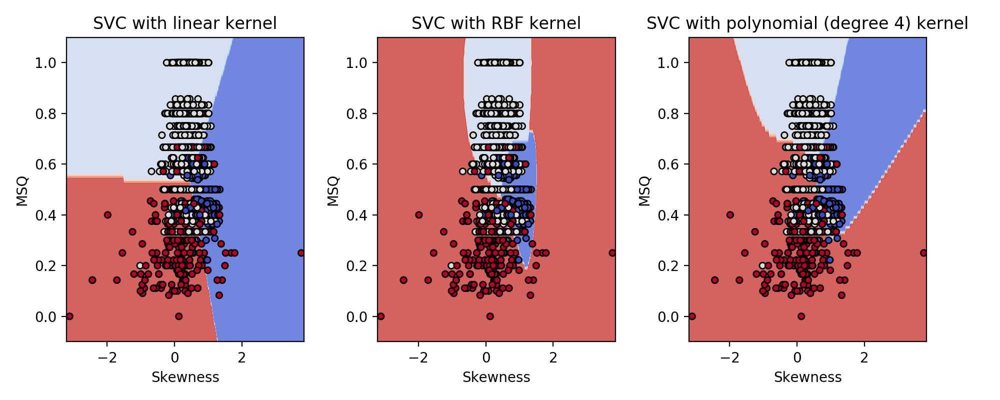

In [3700]:
# title for the plots
titles = ('SVC with linear kernel',
          'SVC with RBF kernel',
          'SVC with polynomial (degree 4) kernel')

# Set-up 2x2 grid for plotting.
fig, sub = plt.subplots(1, 3,figsize=(10,4))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)


for clf, title, ax in zip(models1, titles, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(yy.min(), yy.max())
    ax.set_xlabel("Skewness")
    ax.set_ylabel('MSQ')
    ax.set_title(title)
# plt.legend(["A","B","C"])
plt.tight_layout()
plt.show()

In [3701]:
Training_F1s=[]
Training_Precisions=[]
Training_Recals=[]

Validation_F1s=[]
Validation_Precisions=[]
Validation_Recals=[]
stds_err_prec_svm=[]
stds_err_rec_svm=[]
stds_err_f1_svm=[]
for clf,title in zip(models1,titles):
    print(title)
    train_pred=clf.predict(X)
    train_f1=get_f1_score(clf,X,y)
    Training_F1s.append(train_f1)
    print("Train f1: ",train_f1)
    train_pre=get_precision_score(clf,X,y)
    Training_Precisions.append(train_pre)
    print("Train prec: ",train_pre)
    train_rec=get_recall_score(clf,X,y)
    Training_Recals.append(train_rec)
    print("Train recall: ",train_rec)  
    
    val_f1s= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_f1=val_f1s.mean()
    val_f1_std=val_f1s.std()
    Validation_F1s.append(val_f1)
    stds_err_f1_svm.append(val_f1_std)
    
    val_pres= cross_val_score(clf, X, y,scoring=get_precision_score, cv=10)
    val_pre=val_pres.mean()
    val_pre_std=val_pres.std()
    Validation_Precisions.append(val_pre)
    stds_err_prec_svm.append(val_pre_std)
    
    val_recs= cross_val_score(clf, X, y,scoring=get_recall_score, cv=10)
    val_rec=val_recs.mean()
    val_rec_std=val_recs.std()
    Validation_Recals.append(val_rec)
    stds_err_rec_svm.append(val_rec_std)
    
    print("Val f1: {} +- {}".format(val_f1,val_f1_std))
    print("Val prec: {} +- {}".format(val_pre,val_pre_std))
    print("Val rec: {} +- {}".format(val_rec,val_rec_std))
    print("")

SVC with linear kernel
Train f1:  0.6559260570478873
Train prec:  0.7136734153620337
Train recall:  0.6391927055556034
Val f1: 0.6558363349866936 +- 0.02655434962139589
Val prec: 0.7134187868870125 +- 0.03219677761223458
Val rec: 0.6394442441529942 +- 0.023955005878428935

SVC with RBF kernel
Train f1:  0.6681985422808561
Train prec:  0.7206782002945425
Train recall:  0.6578130371204044
Val f1: 0.6700247726350936 +- 0.02901609273965288
Val prec: 0.7223729249529669 +- 0.033320564808141155
Val rec: 0.6607015932488793 +- 0.02875771201567418

SVC with polynomial (degree 4) kernel
Train f1:  0.6236864142858245
Train prec:  0.7032251630130569
Train recall:  0.6111413040824126
Val f1: 0.6193733393379465 +- 0.028067615035188058
Val prec: 0.6996808948973647 +- 0.03329213794671786
Val rec: 0.6092315285768416 +- 0.02252108311251527



In [88]:
def percentage(col):
    cols=[]
    for c in col:
        cols.append(c*100.00)
    return cols

In [2668]:
Training_F1s

[0.7053803849984258, 0.7250607981904017, 0.6440701794750476]

In [2807]:
columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
SVM_Table=pd.DataFrame([Training_Precisions,Training_Recals,Training_F1s,Validation_Precisions,Validation_Recals,Validation_F1s]).T
SVM_Table.columns=columns
SVM_Table.index=titles
SVM_Table = SVM_Table.apply(percentage)
SVM_Table


,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.367342,63.919271,65.592606,71.341879,63.944424,65.583633
SVC with RBF kernel,72.779411,66.186712,67.619978,72.477749,66.015237,67.272176
SVC with polynomial (degree 4) kernel,70.322516,61.114130,62.368641,69.968089,60.923153,61.937334


## 2 Classes 

In [2567]:
X2 = train_scores[["Skewness","MSQ"]]
y2=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y2.append(0)
    if(label=="B"):
        y2.append(0)
    if(label=="C"):
        y2.append(1)
Xtest2 = test_scores[["Skewness","MSQ"]]
ytest2=[]
for label in test_labels["Label"]:
    if(label=="A"):
        ytest2.append(0)
    if(label=="B"):
        ytest2.append(0)
    if(label=="C"):
        ytest2.append(1)

print("X shape: {}".format(X2.shape))
print("y shape: {}".format(len(y2)))

X shape: (1959, 2)
y shape: 1959


In [2568]:
# we create an instance of SVM and fit out data. We do not scale our
# data since we want to plot the support vectors
C = 1.e10  # SVM regularization parameter
models2 = [svm.SVC(kernel='linear', C=C_linear).fit(X2,y2),
          svm.LinearSVC(C=C, max_iter=1000000).fit(X2,y2),
          svm.SVC(kernel='rbf', gamma="auto", C=C).fit(X2,y2),
          svm.SVC(kernel='poly', degree=4, gamma='auto', C=C,max_iter=1000000).fit(X2,y2)]

KeyboardInterrupt: 

In [ ]:
# title for the plots
titles = ('SVC with linear kernel',
          'LinearSVC (linear kernel)',
          'SVC with RBF kernel',
          'SVC with polynomial (degree 4) kernel')

# Set-up 2x2 grid for plotting.
fig, sub = plt.subplots(2, 2,figsize=(9,9))
plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X2["Skewness"].values, X2["MSQ"].values
xx, yy = make_meshgrid(X0, X1)

for clf, title, ax in zip(models2, titles, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
    ax.set_xlim(xx.min(), xx.max())
    ax.set_ylim(yy.min(), yy.max())
    ax.set_xlabel("Skewness")
    ax.set_ylabel("MSQ")
    ax.set_title(title)
# plt.legend(["A","B","C"])
plt.show()

In [ ]:
for clf,title in zip(models2,titles):
    train_pred=clf.predict(X2)
    test_pred=clf.predict(Xtest2)
    print(title)
    AB_train, C_train = get_accuracy_2class(train_pred,y2)
    print("Train accuracy: A: {} B: {} ".format(AB_train, C_train))
    AB_test, C_test = get_accuracy_2class(test_pred,ytest2)
    print("Test accuracy: A: {} B: {} ".format(AB_test, C_test))

In [ ]:
pred = predict(Xtest2,0.0,0.5)
accs = get_accuracy_2class(pred,ytest2)
print("Good Sample accuracy: {} , Bad Sample accuracy: {} ".format(accs[0],accs[1]))

# Linear Classifiers

In [75]:
from sklearn.linear_model import Perceptron
from sklearn import linear_model
from sklearn.linear_model import SGDClassifier, Perceptron
from sklearn.linear_model import PassiveAggressiveClassifier
from sklearn.linear_model import LogisticRegression

In [1616]:
def make_meshgrid(x, y, h=.02):
    """Create a mesh of points to plot in

    Parameters
    ----------
    x: data to base x-axis meshgrid on
    y: data to base y-axis meshgrid on
    h: stepsize for meshgrid, optional

    Returns
    -------
    xx, yy : ndarray
    """
    x_min, x_max = x.min()-0.1, x.max()+0.1 
    y_min, y_max = y.min()-0.1, y.max()+0.1
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))
    return xx, yy

def plot_contours(ax, clf, xx, yy, **params):
    """Plot the decision boundaries for a classifier.

    Parameters
    ----------
    ax: matplotlib axes object
    clf: a classifier
    xx: meshgrid ndarray
    yy: meshgrid ndarray
    params: dictionary of params to pass to contourf, optional
    """
#     print(clf)
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    out = ax.contourf(xx, yy, Z, **params)
    return out

def plot_hyperplane(coef,intercept,c, color,ax):
    print("coef: ",coef)
    print("intercept: ",intercept)
    def line(x0):
        return (-(x0 * coef[c, 0]) - intercept[c]) / coef[c, 1]
    ax.plot([xmin, xmax], [line(xmin), line(xmax)],
             ls="--", color=color)

In [ ]:
X = train_scores[["Skewness","MSQ"]]
y=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y.append(0)
    if(label=="B"):
        y.append(1)
    if(label=="C"):
        y.append(2)
print("X shape: {}".format(X.shape[0]))
print("y shape: {}".format(len(y)))

In [1535]:
for model in models3:
    print(model.classes_)

[0 1 2]
[0 1 2]
[0 1 2]
[0 1 2]
[0 1 2]
[0 1 2]


In [1771]:
import warnings
warnings.filterwarnings('ignore')

In [3244]:
print(y)

MSQ


In [452]:
loss="modified_huber"
train_huber=[]
val_huber=[]
Cs_huber=np.arange(0.0006,.08,0.0006)

for C in tqdm(Cs_huber):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_huber.append(train_r)
    val_huber.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


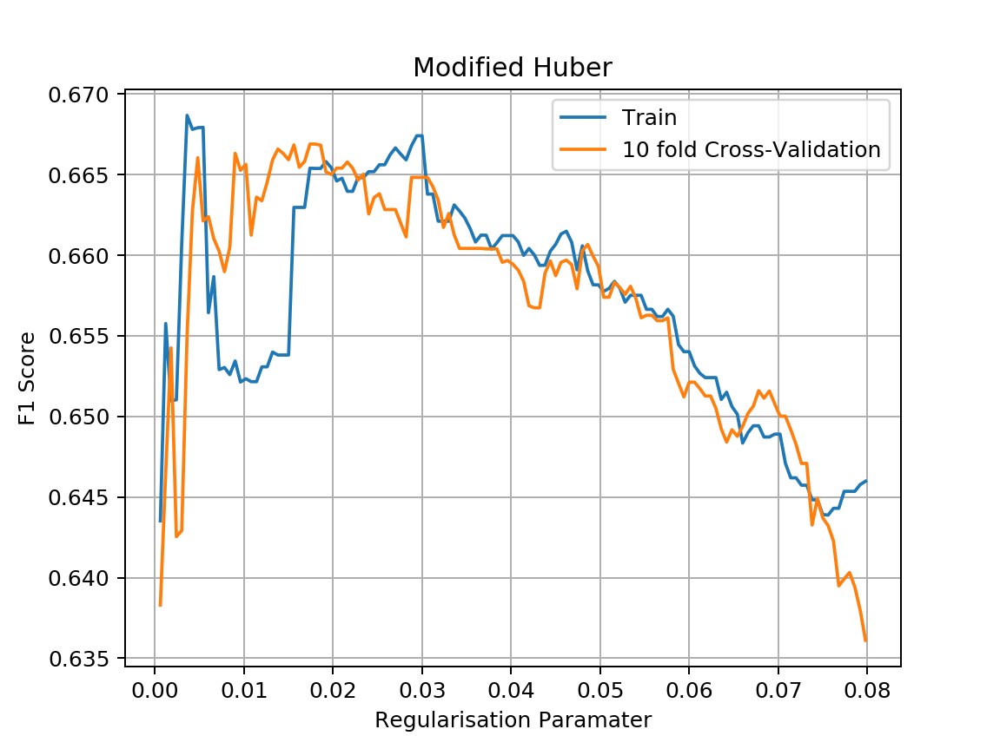

In [453]:
plt.figure()
plt.title("Modified Huber")
plt.plot(Cs_huber,train_huber,label="Train")
plt.plot(Cs_huber,val_huber,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [454]:
index_huber=val_huber.index(np.max(val_huber))
C_huber=Cs_huber[index_huber]
print("Huber alpha: ",C_huber)

Huber alpha:  0.0174


In [455]:
loss="log"
train_log=[]
val_log=[]
Cs_log=np.arange(0.0001,0.01,0.0001)

for C in tqdm(Cs_log):
#     print("Regularisation: ",C)
    
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_log.append(train_r)
    val_log.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


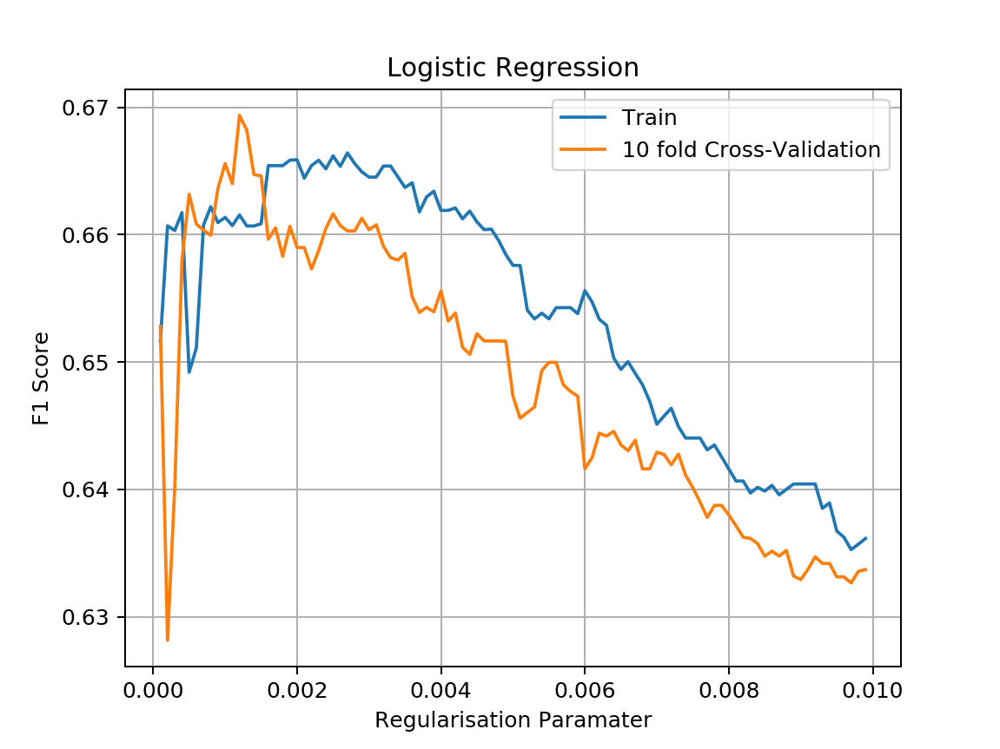

In [456]:
plt.figure()
plt.title("Logistic Regression")
plt.plot(Cs_log,train_log,label="Train")
plt.plot(Cs_log,val_log,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [457]:
index_log=val_log.index(np.max(val_log))
C_log=Cs_log[index_log]
print("Logistic alpha: ",C_log)

Logistic alpha:  0.0012000000000000001


In [458]:
penalty="elasticnet"
train_elas=[]
val_elas=[]
Cs_elas=np.arange(0.0002,0.02,0.0002)

for C in tqdm(Cs_elas):
#     print("Regularisation: ",C)
    clf=SGDClassifier(penalty=penalty,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_elas.append(train_r)
    val_elas.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


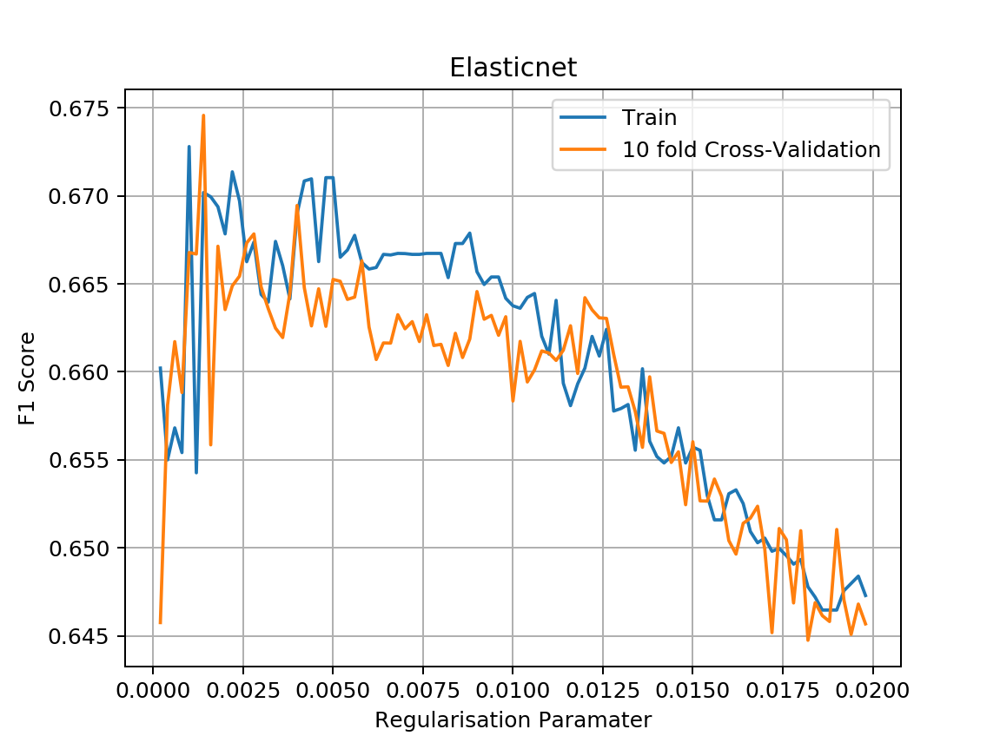

In [459]:
plt.figure()
plt.title("Elasticnet")
plt.plot(Cs_elas,train_elas,label="Train")
plt.plot(Cs_elas,val_elas,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [460]:
index_elas=val_elas.index(np.max(val_elas))
C_elas=Cs_elas[index_elas]
print("Elastic alpha: ",C_elas)

Elastic alpha:  0.0014000000000000002


In [461]:
loss="squared_loss"
train_sq=[]
val_sq=[]
Cs_sq=np.arange(0.0002,.02,0.0002)

for C in tqdm(Cs_sq):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_sq.append(train_r)
    val_sq.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


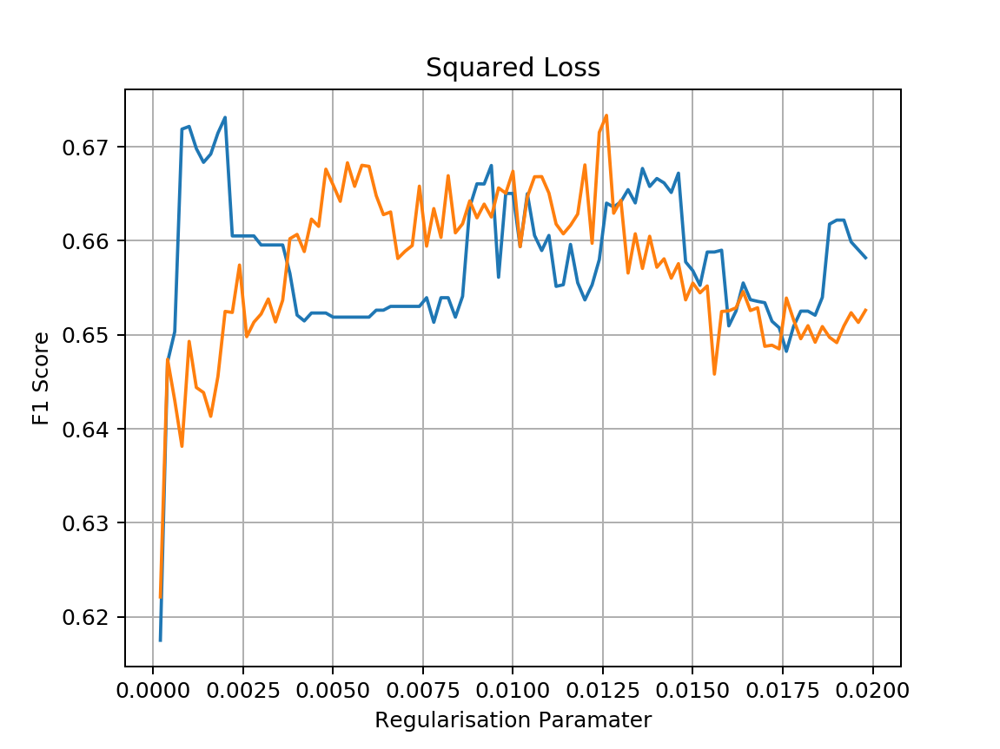

In [462]:
plt.figure()
plt.title("Squared Loss")
plt.plot(Cs_sq,train_sq,label="Train")
plt.plot(Cs_sq,val_sq,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [463]:
index_sq=val_sq.index(np.max(val_sq))
C_sq=Cs_sq[index_sq]
print("Squared Alpha: ",C_sq)

Squared Alpha:  0.012600000000000002


In [464]:
train_norm=[]
val_norm=[]
Cs_norm=np.arange(0.0002,0.02,0.0002)
for C in tqdm(Cs_norm):
#     print("Regularisation: ",C)
    clf=SGDClassifier(alpha=C,class_weight="balanced",random_state=2).fit(X,y)
    train_r=get_f1_score(clf,X,y)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_norm.append(train_r)
    val_norm.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


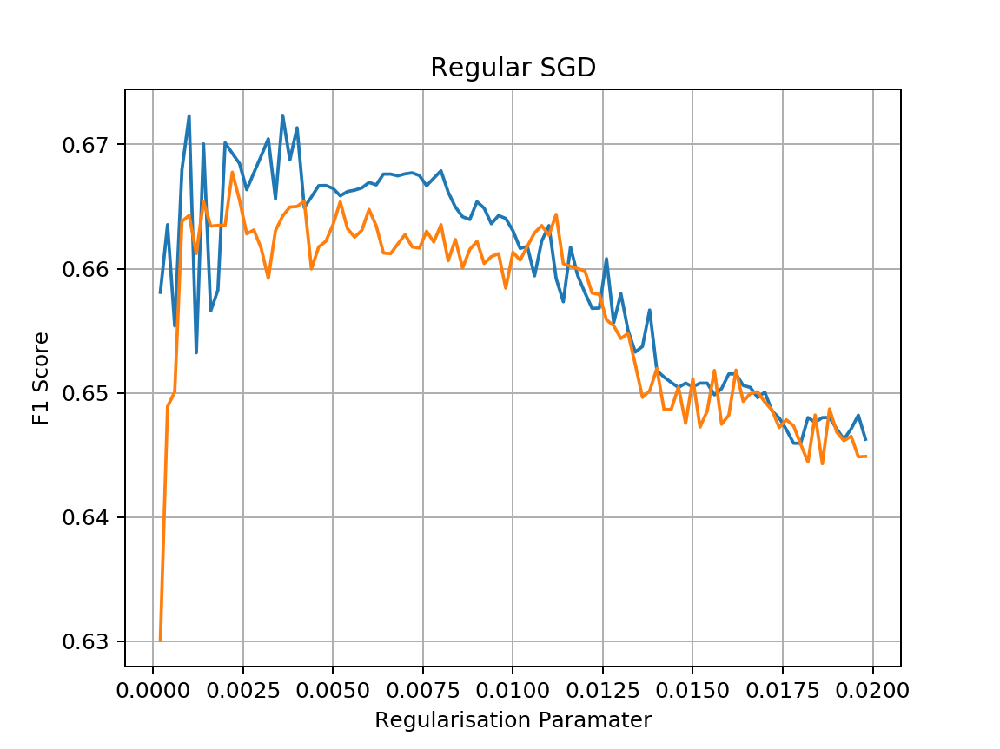

In [465]:
plt.figure()
plt.title("Regular SGD")
plt.plot(Cs_norm,train_norm,label="Train")
plt.plot(Cs_norm,val_norm,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [466]:
index_norm=val_norm.index(np.max(val_norm))
C_norm=Cs_norm[index_norm]
print("Logistic alpha: ",C_norm)

Logistic alpha:  0.0022


In [467]:
from sklearn.linear_model import RidgeClassifier

In [238]:
models4 = [
    RidgeClassifier(random_state=2,class_weight="balanced").fit(X,y),
    SGDClassifier(penalty="elasticnet",class_weight="balanced",random_state=2,alpha=C_elas).fit(X,y),
    SGDClassifier(loss="modified_huber",random_state=2,class_weight="balanced",alpha=C_huber).fit(X,y),
    SGDClassifier(loss="log",random_state=2,class_weight="balanced",alpha=C_log).fit(X,y),
    SGDClassifier(loss="squared_loss",random_state=2,class_weight="balanced",alpha=C_sq).fit(X,y),
    Perceptron(random_state=2,class_weight="balanced").fit(X,y),
]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


<IPython.core.display.Javascript object>


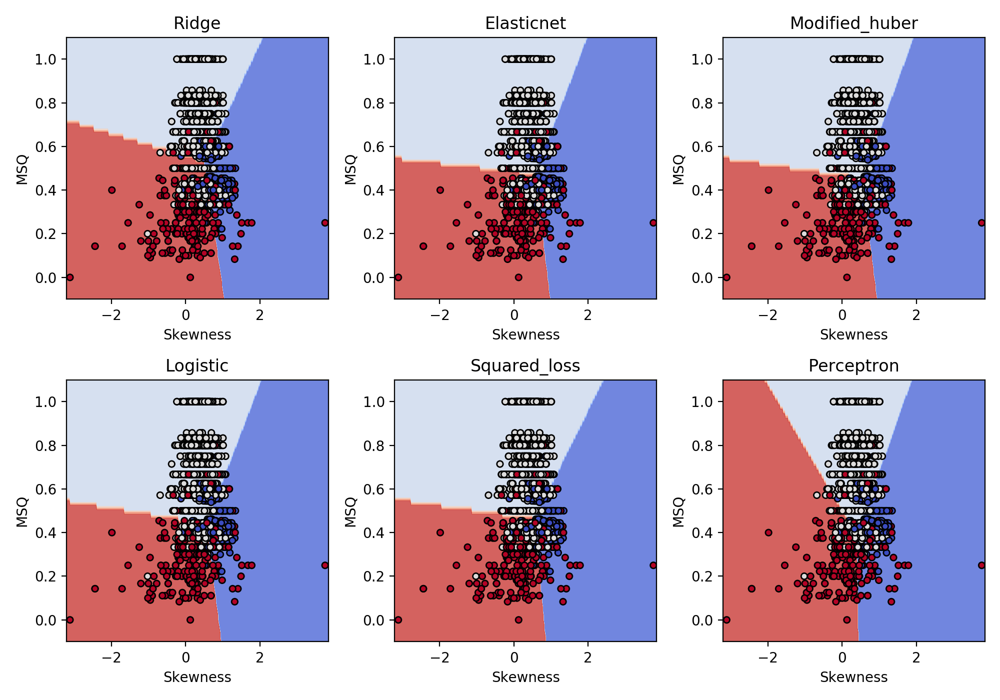

In [239]:
# title for the plots
titles4 = ('Ridge',
          'Elasticnet',
          'Modified_huber',
          'Logistic',
          'Squared_loss',
          'Perceptron',)

# Set-up 2x3 grid for plotting.
fig, sub = plt.subplots(2, 3,figsize=(10,7))
# plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)

# print("titles length: ",len(titles))
# print("models length: ",len(models))
# print("figures length: ",len(sub.flatten()))
colors = "bry"

for clf, title, ax in zip(models4, titles3, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
#     for i, color in zip(clf.classes_, colors):
#         plot_hyperplane(clf.coef_,clf.intercept_,i, color,ax)
    ax.set_xlabel('Skewness')
    ax.set_ylabel('MSQ')
    ax.set_title(title)
plt.tight_layout()
plt.show()

In [3772]:
Training_F1s=[]
Training_Precisions=[]
Training_Recals=[]

Validation_F1s=[]
Validation_Precisions=[]
Validation_Recals=[]
stds_err_prec_sgd=[]
stds_err_rec_sgd=[]
stds_err_f1_sgd=[]
for clf,title in zip(models3,titles3):
    print(title)
    train_pred=clf.predict(X)
    train_f1=get_f1_score(clf,X,y)
    Training_F1s.append(train_f1)
    print("Train f1: ",train_f1)
    train_pre=get_precision_score(clf,X,y)
    Training_Precisions.append(train_pre)
    print("Train prec: ",train_pre)
    train_rec=get_recall_score(clf,X,y)
    Training_Recals.append(train_rec)
    print("Train recall: ",train_rec)  
    
    val_f1s= cross_val_score(clf, X, y,scoring=get_f1_score, cv=10)
    val_f1=val_f1s.mean()
    val_f1_std=val_f1s.std()
    Validation_F1s.append(val_f1)
    stds_err_f1_sgd.append(val_f1_std)
    
    val_pres= cross_val_score(clf, X, y,scoring=get_precision_score, cv=10)
    val_pre=val_pres.mean()
    val_pre_std=val_pres.std()
    Validation_Precisions.append(val_pre)
    stds_err_prec_sgd.append(val_pre_std)
    
    val_recs= cross_val_score(clf, X, y,scoring=get_recall_score, cv=10)
    val_rec=val_recs.mean()
    val_rec_std=val_recs.std()
    Validation_Recals.append(val_rec)
    stds_err_rec_sgd.append(val_rec_std)
    
    print("Val f1: {} +- {}".format(val_f1,val_f1_std))
    print("Val prec: {} +- {}".format(val_pre,val_pre_std))
    print("Val rec: {} +- {}".format(val_rec,val_rec_std))
    print("")

Ridge
Train f1:  0.6599071914234846
Train prec:  0.7080559356200381
Train recall:  0.6400538958083904
Val f1: 0.6634744210431853 +- 0.045233393676194486
Val prec: 0.7139607064961662 +- 0.04690006841920165
Val rec: 0.6459044644688173 +- 0.041500899012120444

Elasticnet
Train f1:  0.6728681057379434
Train prec:  0.6855274900146696
Train recall:  0.6710844135297189
Val f1: 0.6670645499792875 +- 0.04629222552840013
Val prec: 0.6927842486351018 +- 0.049428683803991444
Val rec: 0.6595367943153965 +- 0.04229677120504061

Modified_huber
Train f1:  0.668049902593328
Train prec:  0.6801160134493468
Train recall:  0.6709377085501044
Val f1: 0.6692941602165962 +- 0.05240253457750968
Val prec: 0.6840005734499579 +- 0.05427233538360059
Val rec: 0.6749680091956249 +- 0.05280204862052864

Logistic
Train f1:  0.6652274793774112
Train prec:  0.6665553620681826
Train recall:  0.6734892787524366
Val f1: 0.6601088629232462 +- 0.05808478635196214
Val prec: 0.6678213180355164 +- 0.05818558794841338
Val rec: 

In [3773]:
columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
SGD_Table=pd.DataFrame([Training_Precisions,Training_Recals,Training_F1s,Validation_Precisions,Validation_Recals,Validation_F1s]).T
SGD_Table.columns=columns
SGD_Table.index=titles3
SGD_Table = SGD_Table.apply(percentage)
SGD_Table

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
Ridge,70.805594,64.005390,65.990719,71.396071,64.590446,66.347442
Elasticnet,68.552749,67.108441,67.286811,69.278425,65.953679,66.706455
Modified_huber,68.011601,67.093771,66.804990,68.400057,67.496801,66.929416
Logistic,66.655536,67.348928,66.522748,66.782132,66.749254,66.010886
Squared_loss,67.349833,67.191677,66.726498,68.437570,68.241379,67.726455
Perceptron,66.470514,67.861037,64.781388,57.041552,63.114612,52.901158


In [3726]:
Results_Table=pd.concat([SVM_Table,SGD_Table])

In [3727]:
Results_Table

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.367342,63.919271,65.592606,71.341879,63.944424,65.583633
SVC with RBF kernel,72.779411,66.186712,67.619978,72.477749,66.015237,67.272176
SVC with polynomial (degree 4) kernel,70.322516,61.114130,62.368641,69.968089,60.923153,61.937334
Ridge,70.796480,63.894462,65.778596,70.783577,63.987421,65.706538
Elasticnet,68.577048,66.935939,67.018753,69.726977,67.078426,67.456846
Modified_huber,68.035569,66.986988,66.539591,68.143564,66.982138,66.689407
Logistic,66.472578,67.112350,66.155489,68.720917,67.024963,66.937873
Squared_loss,67.294336,67.011843,66.401383,68.188158,67.612145,67.335161
Perceptron,66.858146,68.270685,64.866071,56.681520,65.228258,53.811095


In [2356]:
Results_Table.to_csv("Results_Table.csv",float_format="%.2f")

# Decision Tree Classification

In [1554]:
from sklearn import tree

In [1560]:
feature_names=["Skewness","MSQ"]
target_names=["A","B","C"]

In [3880]:
t = tree.DecisionTreeClassifier(class_weight="balanced",max_depth=4,random_state=2)
t = t.fit(X, y)

<IPython.core.display.Javascript object>


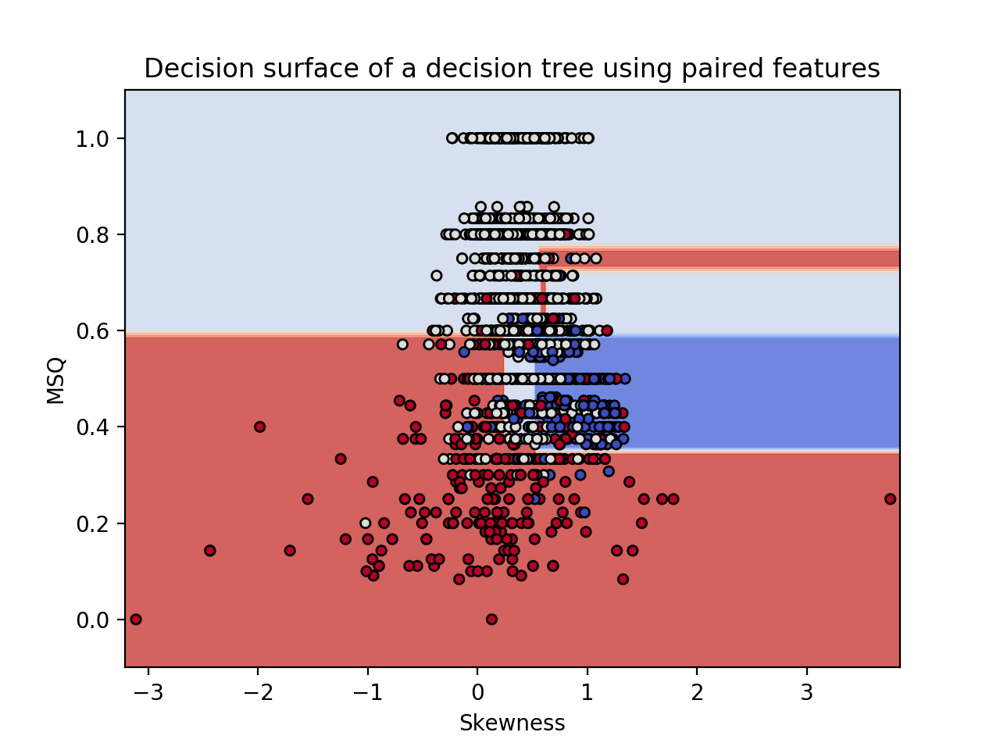

(-3.2124930601009427, 3.847506939899063, -0.1, 1.1)

In [3881]:
plt.figure()
plot_step = 0.02
x_min, x_max = X["Skewness"].min() - 0.1, X["Skewness"].max() + 0.1
y_min, y_max = X["MSQ"].min() - 0.1, X["MSQ"].max() + 0.1

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)
plot_contours(plt,t, xx, yy, cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y, cmap=plt.cm.coolwarm, s=20, edgecolors='k')

plt.xlabel("Skewness")
plt.ylabel("MSQ")

plt.title("Decision surface of a decision tree using paired features")
# plt.legend(loc='lower right', borderpad=0, handletextpad=0)
plt.axis("tight")

<IPython.core.display.Javascript object>


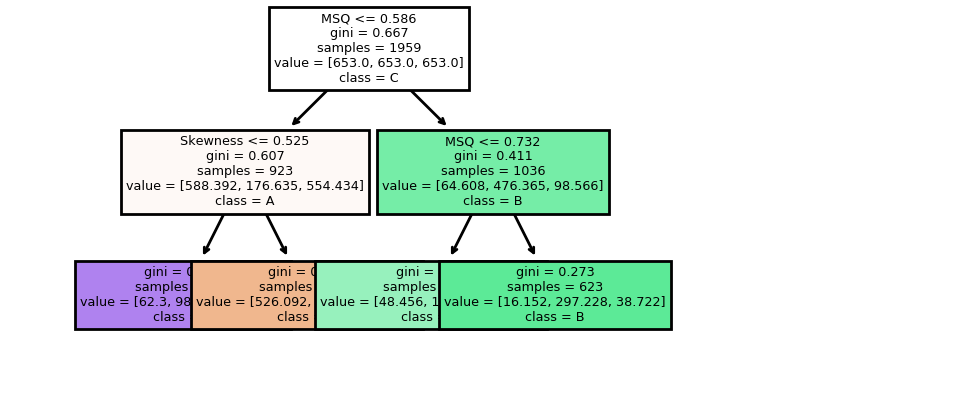

In [3730]:
plt.figure()
tree.plot_tree(t,filled=True,feature_names=feature_names,class_names=target_names) 
plt.axis("tight")
plt.show()

In [3731]:
train_pred=t.predict(X)
train_f1=get_f1_score(t,X,y)

print("Train f1: ",train_f1)
train_pre=get_precision_score(t,X,y)

print("Train prec: ",train_pre)
train_rec=get_recall_score(t,X,y)

print("Train recall: ",train_rec)  

val_f1s= cross_val_score(t, X, y,scoring=get_f1_score, cv=10)
val_f1=val_f1s.mean()
stds_err_f1_dt=val_f1s.std()


val_pres= cross_val_score(t, X, y,scoring=get_precision_score, cv=10)
val_pre=val_pres.mean()
stds_err_prec_dt=val_pres.std()


val_recs= cross_val_score(t, X, y,scoring=get_recall_score, cv=10)
val_rec=val_recs.mean()
stds_err_rec_dt=val_recs.std()


print("Val f1: {} +- {}".format(val_f1,val_f1_std))
print("Val prec: {} +- {}".format(val_pre,val_pre_std))
print("Val rec: {} +- {}".format(val_rec,val_rec_std))
print("")

Train f1:  0.6444721569538753
Train prec:  0.7030932050581636
Train recall:  0.6252078378700837
Val f1: 0.639559877637119 +- 0.1183729141219032
Val prec: 0.6962216726741325 +- 0.08685642281041318
Val rec: 0.6213521594537926 +- 0.10582667137760082



In [3732]:
Results_Table.loc["Decision Tree"]=[train_pre*100,train_rec*100,train_f1*100,val_pre*100,val_rec*100,val_f1*100]

In [2847]:
stds_err_prec_svm

[0.03219677761223458, 0.03518939453767777, 0.03329213794671786]

In [3733]:
errors_prec=[]
errors_prec.extend(stds_err_prec_svm)
errors_prec.extend(stds_err_prec_sgd)
errors_prec.append(stds_err_prec_dt)

In [3734]:
errors_rec=[]
errors_rec.extend(stds_err_rec_svm)
errors_rec.extend(stds_err_rec_sgd)
errors_rec.append(stds_err_rec_dt)

In [3735]:
errors_f1=[]
errors_f1.extend(stds_err_f1_svm)
errors_f1.extend(stds_err_f1_sgd)
errors_f1.append(stds_err_f1_dt)

In [2858]:
print(len(errors_prec))
print(len(errors_rec))
print(len(errors_f1))

10
10
10


In [3736]:
Errors_prec=[]
Errors_rec=[]
Errors_f1=[]
for e_prec,e_rec,e_f1 in zip(errors_prec,errors_rec,errors_f1):
    Errors_prec.append(e_prec*100)
    Errors_rec.append(e_rec*100)
    Errors_f1.append(e_f1*100)

In [2864]:
for index,error in zip(Results_Table["Validation F1-Score"].index,Errors_f1):
    print("F1: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation F1-Score"][index],error))
for index,error in zip(Results_Table["Validation Recall"].index,Errors_rec):
    print("Recall: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Recall"][index],error))
for index,error in zip(Results_Table["Validation Precision"].index,Errors_prec):
    print("Precision: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Precision"][index],error))

F1: 65.58 $\pm$ 2.66
F1: 67.27 $\pm$ 3.17
F1: 61.94 $\pm$ 2.81
F1: 65.71 $\pm$ 2.47
F1: 67.46 $\pm$ 4.02
F1: 66.69 $\pm$ 3.13
F1: 66.94 $\pm$ 3.16
F1: 67.34 $\pm$ 3.30
F1: 53.81 $\pm$ 11.84
F1: 53.81 $\pm$ 2.47
Recall: 63.94 $\pm$ 2.40
Recall: 66.02 $\pm$ 3.18
Recall: 60.92 $\pm$ 2.25
Recall: 63.99 $\pm$ 2.28
Recall: 67.08 $\pm$ 4.14
Recall: 66.98 $\pm$ 3.58
Recall: 67.02 $\pm$ 3.77
Recall: 67.61 $\pm$ 3.73
Recall: 65.23 $\pm$ 10.58
Recall: 65.23 $\pm$ 2.14
Precision: 71.34 $\pm$ 3.22
Precision: 72.48 $\pm$ 3.52
Precision: 69.97 $\pm$ 3.33
Precision: 70.78 $\pm$ 2.97
Precision: 69.73 $\pm$ 4.54
Precision: 68.14 $\pm$ 3.30
Precision: 68.72 $\pm$ 3.51
Precision: 68.19 $\pm$ 3.27
Precision: 56.68 $\pm$ 8.69
Precision: 56.68 $\pm$ 3.18


In [3737]:
for index,error in zip(Results_Table["Validation F1-Score"].index,Errors_f1):
    print("F1: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation F1-Score"][index],error))
for index,error in zip(Results_Table["Validation Recall"].index,Errors_rec):
    print("Recall: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Recall"][index],error))
for index,error in zip(Results_Table["Validation Precision"].index,Errors_prec):
    print("Precision: {0:2.2f} $\pm$ {1:2.2f}".format(Results_Table["Validation Precision"][index],error))

F1: 65.58 $\pm$ 2.66
F1: 67.27 $\pm$ 2.90
F1: 61.94 $\pm$ 2.81
F1: 65.71 $\pm$ 2.47
F1: 67.46 $\pm$ 4.02
F1: 66.69 $\pm$ 3.13
F1: 66.94 $\pm$ 3.16
F1: 67.34 $\pm$ 3.30
F1: 53.81 $\pm$ 11.84
F1: 63.96 $\pm$ 2.47
Recall: 63.94 $\pm$ 2.40
Recall: 66.02 $\pm$ 2.88
Recall: 60.92 $\pm$ 2.25
Recall: 63.99 $\pm$ 2.28
Recall: 67.08 $\pm$ 4.14
Recall: 66.98 $\pm$ 3.58
Recall: 67.02 $\pm$ 3.77
Recall: 67.61 $\pm$ 3.73
Recall: 65.23 $\pm$ 10.58
Recall: 62.14 $\pm$ 2.14
Precision: 71.34 $\pm$ 3.22
Precision: 72.48 $\pm$ 3.33
Precision: 69.97 $\pm$ 3.33
Precision: 70.78 $\pm$ 2.97
Precision: 69.73 $\pm$ 4.54
Precision: 68.14 $\pm$ 3.30
Precision: 68.72 $\pm$ 3.51
Precision: 68.19 $\pm$ 3.27
Precision: 56.68 $\pm$ 8.69
Precision: 69.62 $\pm$ 3.18


In [2906]:
Results_Table

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.367342,63.919271,65.592606,71.341879,63.944424,65.583633
SVC with RBF kernel,72.779411,66.186712,67.619978,72.477749,66.015237,67.272176
SVC with polynomial (degree 4) kernel,70.322516,61.114130,62.368641,69.968089,60.923153,61.937334
Ridge,70.796480,63.894462,65.778596,70.783577,63.987421,65.706538
Elasticnet,68.577048,66.935939,67.018753,69.726977,67.078426,67.456846
Modified_huber,68.035569,66.986988,66.539591,68.143564,66.982138,66.689407
Logistic,66.472578,67.112350,66.155489,68.720917,67.024963,66.937873
Squared_loss,67.294336,67.011843,66.401383,68.188158,67.612145,67.335161
Perceptron,66.858146,68.270685,64.866071,56.681520,65.228258,53.811095
Decision Tree,66.858146,68.270685,64.866071,56.681520,65.228258,53.811095


In [3738]:
indices=["SVC Linear","SVC RBF","SVC Polynomial","SGD Ridge","SGD Elastic","SGD Mod Huber","SGD Logistic","SGD Squared","SGD Percep","Decision Tree"]
columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
All_Errors=[Errors_prec,Errors_rec,Errors_f1]
Results_Table_std=pd.DataFrame(columns=Results_Table.columns,index=Results_Table.index)
for c in Results_Table.columns[:3]:
    for i in Results_Table.index:
        Results_Table_std[c][i]="{0:2.2f}".format(Results_Table[c][i])
for c,Errors in zip(Results_Table.columns[3:],All_Errors):
    for i,Error in zip(Results_Table.index,Errors):
        Results_Table_std[c][i]="{0:2.2f} $\pm$ {1:2.2f}".format(Results_Table[c][i],Error)
        
        

In [3739]:
Results_Table_std

,Training Precision,Training Recall,Training F1-Score,Validation Precision,Validation Recall,Validation F1-Score
SVC with linear kernel,71.37,63.92,65.59,71.34 $\pm$ 3.22,63.94 $\pm$ 2.40,65.58 $\pm$ 2.66
SVC with RBF kernel,72.78,66.19,67.62,72.48 $\pm$ 3.33,66.02 $\pm$ 2.88,67.27 $\pm$ 2.90
SVC with polynomial (degree 4) kernel,70.32,61.11,62.37,69.97 $\pm$ 3.33,60.92 $\pm$ 2.25,61.94 $\pm$ 2.81
Ridge,70.80,63.89,65.78,70.78 $\pm$ 2.97,63.99 $\pm$ 2.28,65.71 $\pm$ 2.47
Elasticnet,68.58,66.94,67.02,69.73 $\pm$ 4.54,67.08 $\pm$ 4.14,67.46 $\pm$ 4.02
Modified_huber,68.04,66.99,66.54,68.14 $\pm$ 3.30,66.98 $\pm$ 3.58,66.69 $\pm$ 3.13
Logistic,66.47,67.11,66.16,68.72 $\pm$ 3.51,67.02 $\pm$ 3.77,66.94 $\pm$ 3.16
Squared_loss,67.29,67.01,66.40,68.19 $\pm$ 3.27,67.61 $\pm$ 3.73,67.34 $\pm$ 3.30
Perceptron,66.86,68.27,64.87,56.68 $\pm$ 8.69,65.23 $\pm$ 10.58,53.81 $\pm$ 11.84
Decision Tree,70.31,62.52,64.45,69.62 $\pm$ 3.18,62.14 $\pm$ 2.14,63.96 $\pm$ 2.47


In [3740]:
Results_Table_std.to_csv("Results_Table_std")

<IPython.core.display.Javascript object>


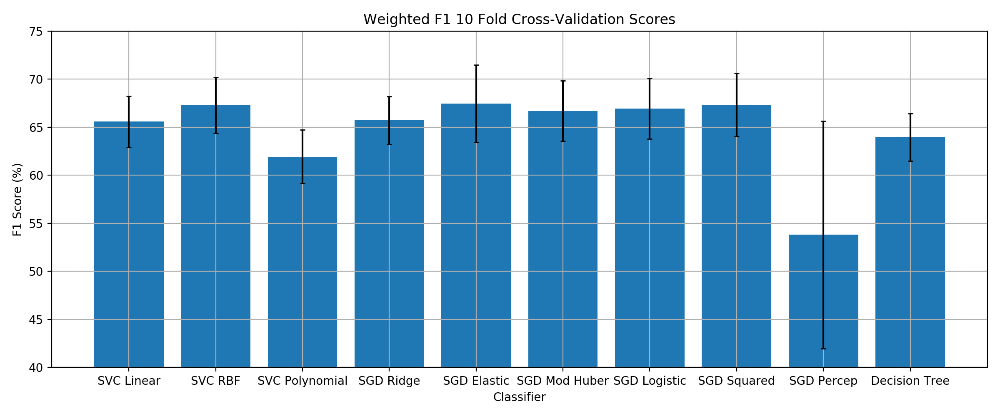

In [3741]:
indices=["SVC Linear","SVC RBF","SVC Polynomial","SGD Ridge","SGD Elastic","SGD Mod Huber","SGD Logistic","SGD Squared","SGD Percep","Decision Tree"]
plt.figure(figsize=(12,5))
plt.title("Weighted F1 10 Fold Cross-Validation Scores")
plt.bar(indices,Results_Table["Validation F1-Score"].values,yerr=Errors_f1,capsize=2)
plt.grid()
plt.xlabel("Classifier")
plt.ylabel("F1 Score (%)")
plt.ylim([40,75])
plt.tight_layout()
plt.show()

<IPython.core.display.Javascript object>


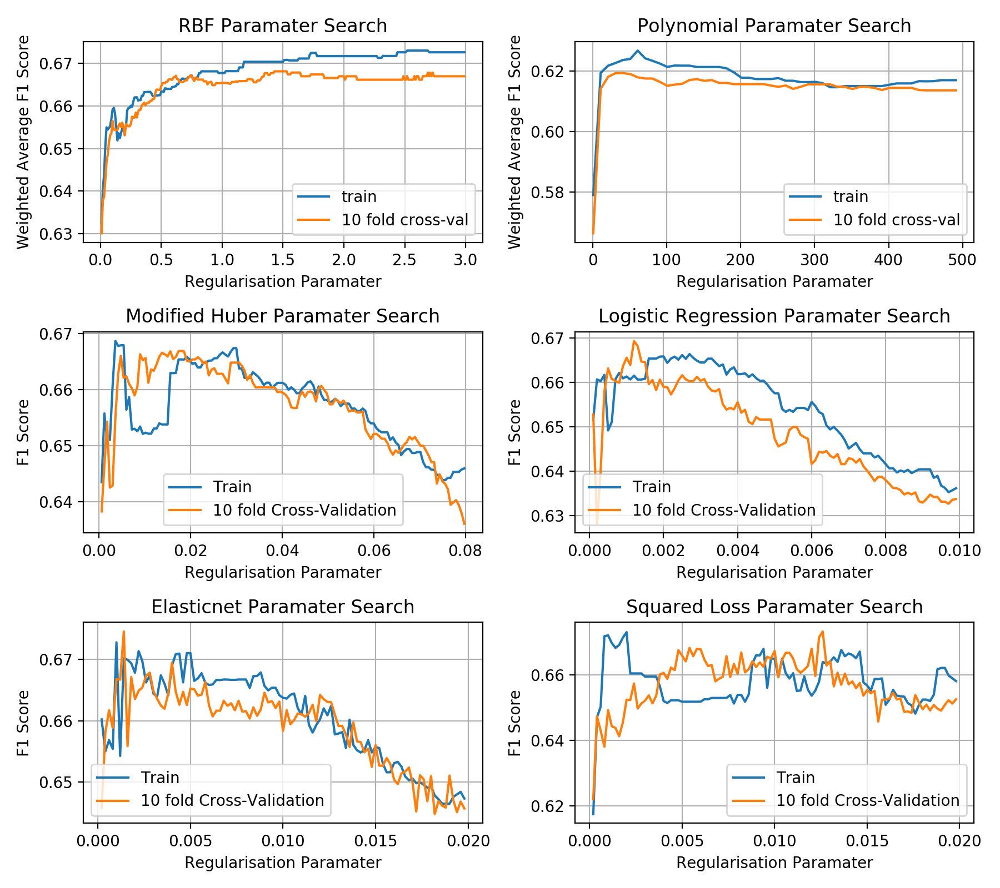

In [2972]:
plt.figure(figsize=(9,8))

plt.subplot(3,2,1)
plt.title("RBF Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs2,train_f1s_2,label="train")
plt.plot(Cs2,val_f1s_2,label="10 fold cross-val")
plt.grid()
plt.legend()

plt.subplot(3,2,2)
plt.title("Polynomial Paramater Search")
plt.xlabel("Regularisation Paramater")
plt.ylabel("Weighted Average F1 Score")
plt.plot(Cs3,train_f1s_3,label="train")
plt.plot(Cs3,val_f1s_3,label="10 fold cross-val")
plt.grid()
plt.legend()

plt.subplot(3,2,3)
plt.title("Modified Huber Paramater Search")
plt.plot(Cs_huber,train_huber,label="Train")
plt.plot(Cs_huber,val_huber,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(3,2,4)
plt.title("Logistic Regression Paramater Search")
plt.plot(Cs_log,train_log,label="Train")
plt.plot(Cs_log,val_log,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(3,2,5)
plt.title("Elasticnet Paramater Search")
plt.plot(Cs_elas,train_elas,label="Train")
plt.plot(Cs_elas,val_elas,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(3,2,6)
plt.title("Squared Loss Paramater Search")
plt.plot(Cs_sq,train_sq,label="Train")
plt.plot(Cs_sq,val_sq,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.tight_layout()
plt.show()

# Extracting Linear Threshold for chosen Classifier

In [2515]:
print(train_scores.columns[4])

MSQ


In [76]:
C_sq=0.012600000000000002
chosen_clf=SGDClassifier(loss="squared_loss",random_state=2,class_weight="balanced",alpha=C_sq).fit(X,y)

In [77]:
coefficients=chosen_clf.coef_
intercepts=chosen_clf.intercept_
print("Coefficients: ",coefficients)
print("Intercepts: ",intercepts)

Coefficients:  [[ 0.86748371 -1.27669843]
 [-0.26330752  2.02026498]
 [-0.36095814 -1.97291746]]
Intercepts:  [-0.12581411 -1.02240841  0.86276226]


In [78]:
line_1_x1=coefficients[0][0]
line_1_x2=coefficients[0][1]
intercept_1=intercepts[0]

line_2_x1=coefficients[1][0]
line_2_x2=coefficients[1][1]
intercept_2=intercepts[1]

line_3_x1=coefficients[2][0]
line_3_x2=coefficients[2][1]
intercept_3=intercepts[2]

In [79]:
skew_range=np.arange(-3.,3.0,0.01)
y_1s=(intercepts[0]+skew_range*line_1_x1)/(-line_1_x2)
y_2s=(intercepts[1]+skew_range*line_2_x1)/(-line_2_x2)
y_3s=(intercepts[2]+skew_range*line_3_x1)/(-line_3_x2)

<IPython.core.display.Javascript object>


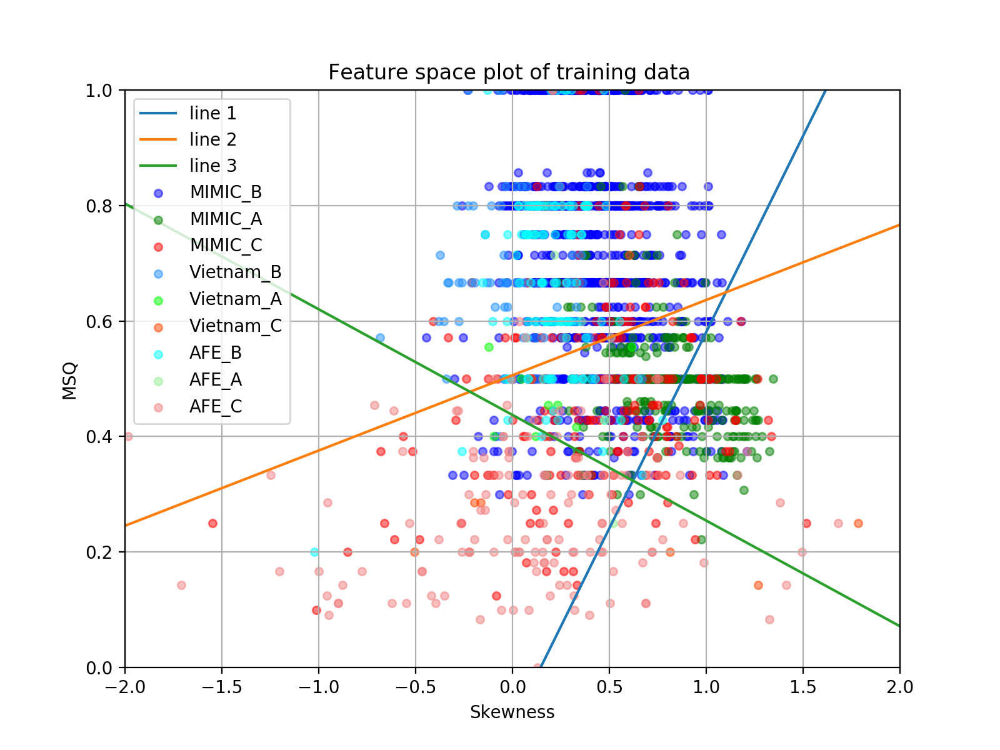

[]

In [83]:

x1="Skewness"
x2="MSQ"
alpha=0.5

ax=MIMIC_B_Scores_train.plot.scatter(x=x1,y=x2,color="blue",alpha=alpha,label="MIMIC_B",figsize=(8,6))
MIMIC_A_Scores_train.plot.scatter(x=x1,y=x2,color="green",alpha=alpha,label="MIMIC_A",ax=ax)
ax=MIMIC_C_Scores_train.plot.scatter(x=x1,y=x2,color="red",alpha=alpha,label="MIMIC_C",ax=ax)

Vietnam_B_Scores_train.plot.scatter(x=x1,y=x2,color="dodgerblue",alpha=alpha,label="Vietnam_B",ax=ax)
Vietnam_A_Scores_train.plot.scatter(x=x1,y=x2,color="lime",alpha=alpha,label="Vietnam_A",ax=ax)
Vietnam_C_Scores_train.plot.scatter(x=x1,y=x2,color="orangered",alpha=alpha,label="Vietnam_C",ax=ax)

AFE_B_Scores_train.plot.scatter(x=x1,y=x2,color="aqua",alpha=alpha,label="AFE_B",ax=ax)
AFE_A_Scores_train.plot.scatter(x=x1,y=x2,color="lightgreen",alpha=alpha,label="AFE_A",ax=ax)
AFE_C_Scores_train.plot.scatter(x=x1,y=x2,color="lightcoral",alpha=alpha,label="AFE_C",ax=ax)

plt.title("Feature space plot of training data ")
plt.xlabel(x1)
plt.ylabel(x2)

plt.grid()

ax.plot(skew_range,y_1s,label="line 1")
ax.plot(skew_range,y_2s,label="line 2")
ax.plot(skew_range,y_3s,label="line 3")
ax.set_ylim([0,1])
ax.set_xlim([-2,2])
plt.legend()
plt.plot()

In [84]:
def predict_sample(sample,coefficients,intercepts):
    Class_0_Score=coefficients[0][0]*sample[0]+coefficients[0][1]*sample[1]+intercepts[0]
    Class_1_Score=coefficients[1][0]*sample[0]+coefficients[1][1]*sample[1]+intercepts[1]
    Class_2_Score=coefficients[2][0]*sample[0]+coefficients[2][1]*sample[1]+intercepts[2]
    Scores=[Class_0_Score,Class_1_Score,Class_2_Score]
    predicted_class=Scores.index(np.max(Scores))
    return predicted_class

def predict_set(X,coefficients,intercepts):
    predictions=[]
    for index in X.index:
        predictions.append(predict_sample(X.loc[index].values,coefficients,intercepts))
    return predictions

In [89]:
train_est=predict_set(X,coefficients,intercepts)
predicted_labels=chosen_clf.predict(X)
test_est=predict_set(X_test,coefficients,intercepts)

print(len(predicted_labels))
print(len(train_est))
print(len(test_est))
print("Train_Report")
print(classification_report(train_est,y,target_names=["A","B","C"]))
print("Test_Report")
print(classification_report(test_est,y_test,target_names=["A","B","C"]))
report=classification_report(test_est,y_test,target_names=["A","B","C"],output_dict=True)
Report=pd.DataFrame.from_dict(report)
Report=Report.apply(percentage)
Report=Report.T
Report.to_csv("Test_Report_3.csv",float_format="%.2f")

1959
1959
1307
Train_Report
              precision    recall  f1-score   support

           A       0.66      0.49      0.56       380
           B       0.86      0.86      0.86      1295
           C       0.50      0.65      0.57       284

    accuracy                           0.76      1959
   macro avg       0.67      0.67      0.66      1959
weighted avg       0.77      0.76      0.76      1959

Test_Report
              precision    recall  f1-score   support

           A       0.57      0.49      0.53       243
           B       0.85      0.83      0.84       853
           C       0.49      0.62      0.55       211

    accuracy                           0.73      1307
   macro avg       0.64      0.65      0.64      1307
weighted avg       0.74      0.73      0.73      1307



In [90]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix
import seaborn as sns

<IPython.core.display.Javascript object>


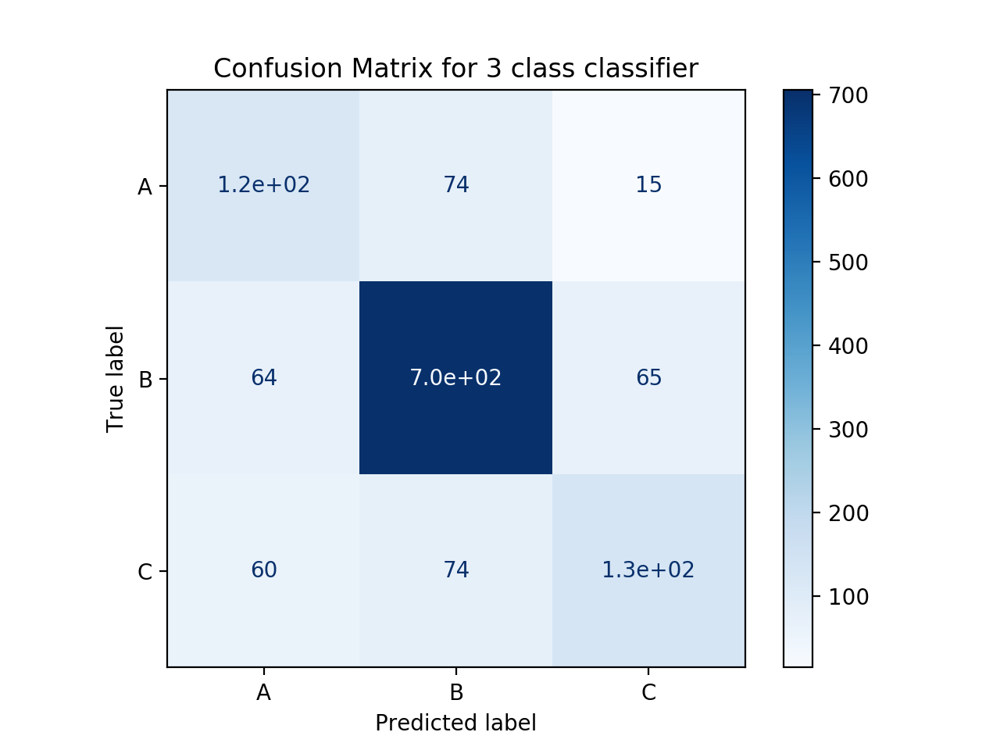

In [91]:
plt.figure()
ax=plt.subplot()
class_names=["A","B","C"]
# cm=confusion_matrix(y_test,test_est)


disp=plot_confusion_matrix(chosen_clf, X_test, y_test,
                                 display_labels=class_names,
                                 cmap=plt.cm.Blues,ax=ax)

plt.title("Confusion Matrix for 3 class classifier")

plt.show()


# Two Class Classifier 

In [189]:
X2 = train_scores[["Skewness","MSQ"]]
y2=[]
for label in train_labels["Label"]:
    if(label=="A"):
        y2.append(0)
    if(label=="B"):
        y2.append(0)
    if(label=="C"):
        y2.append(1)
Xtest2 = test_scores[["Skewness","MSQ"]]
ytest2=[]
for label in test_labels["Label"]:
    if(label=="A"):
        ytest2.append(0)
    if(label=="B"):
        ytest2.append(0)
    if(label=="C"):
        ytest2.append(1)

print("X shape: {}".format(X2.shape))
print("y shape: {}".format(len(y2)))

X shape: (1959, 2)
y shape: 1959


In [190]:
def get_f1_score2(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A&B","C"],output_dict=True)["macro avg"]["f1-score"]

def get_precision_score2(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A&B","C"],output_dict=True)["macro avg"]["precision"]
                                                                                                     
def get_recall_score2(classifier,X,y):
    pred = classifier.predict(X)
    return classification_report(pred,y,target_names=["A&B","C"],output_dict=True)["macro avg"]["recall"] 

# Optimizing Hyper Paramaters

In [468]:
loss="modified_huber"
train_huber_2=[]
val_huber_2=[]
Cs_huber_2=np.arange(0.01,1.0,0.01)

for C in tqdm(Cs_huber_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_huber_2.append(train_r)
    val_huber_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


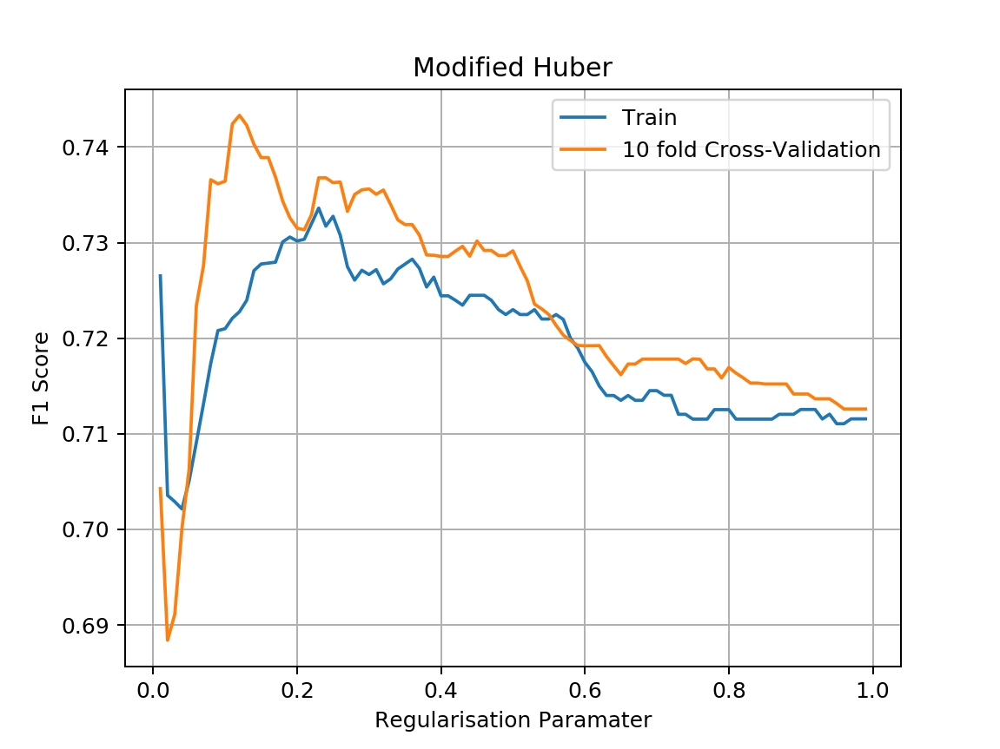

In [469]:
plt.figure()
plt.title("Modified Huber")
plt.plot(Cs_huber_2,train_huber_2,label="Train")
plt.plot(Cs_huber_2,val_huber_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [470]:
index_huber_2=val_huber_2.index(np.max(val_huber_2))
C_huber_2=Cs_huber_2[index_huber_2]
C_huber_2=0.24
print("Huber alpha: ",C_huber_2)

Huber alpha:  0.24


In [471]:
loss="log"
train_log_2=[]
val_log_2=[]
Cs_log_2=np.arange(0.002,.4,0.002)

for C in tqdm(Cs_log_2):
#     print("Regularisation: ",C)
    
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_log_2.append(train_r)
    val_log_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


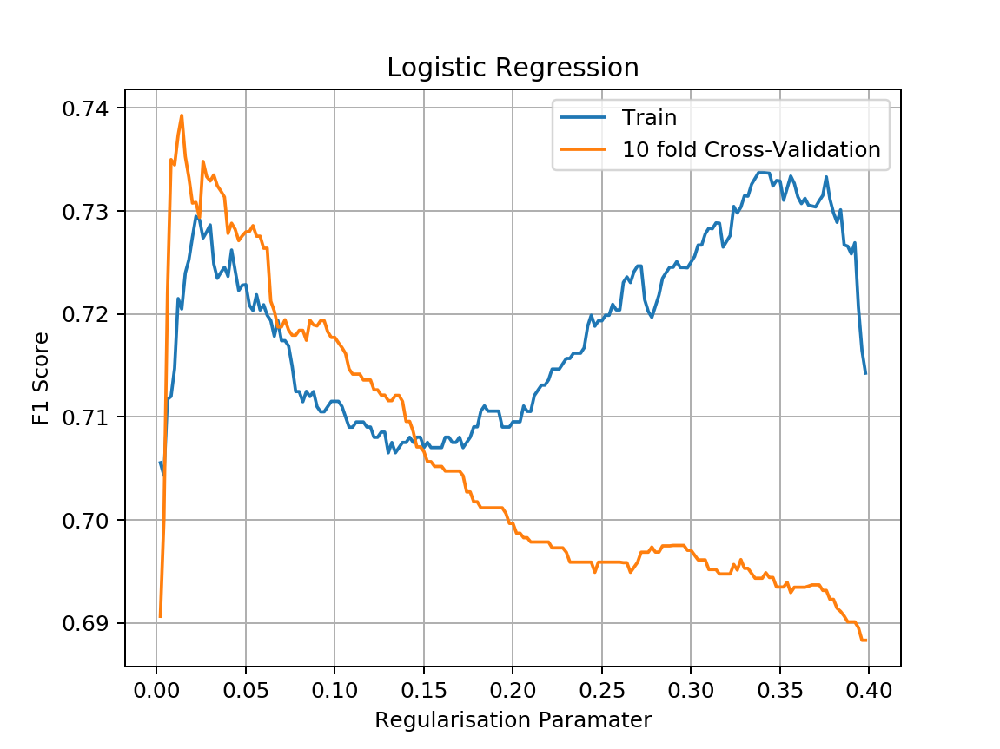

In [483]:
plt.figure()
plt.title("Logistic Regression")
plt.plot(Cs_log_2,train_log_2,label="Train")
plt.plot(Cs_log_2,val_log_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [473]:
index_log_2=val_log_2.index(np.max(val_log_2))
C_log_2=Cs_log_2[index_log_2]
C_log_2=0.026
print("Logistic alpha: ",C_log_2)

Logistic alpha:  0.026


In [474]:
penalty="elasticnet"
train_elas_2=[]
val_elas_2=[]
Cs_elas_2=np.arange(0.003,0.3,0.003)

for C in tqdm(Cs_elas_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(penalty=penalty,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_elas_2.append(train_r)
    val_elas_2.append(val_r)

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMe

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


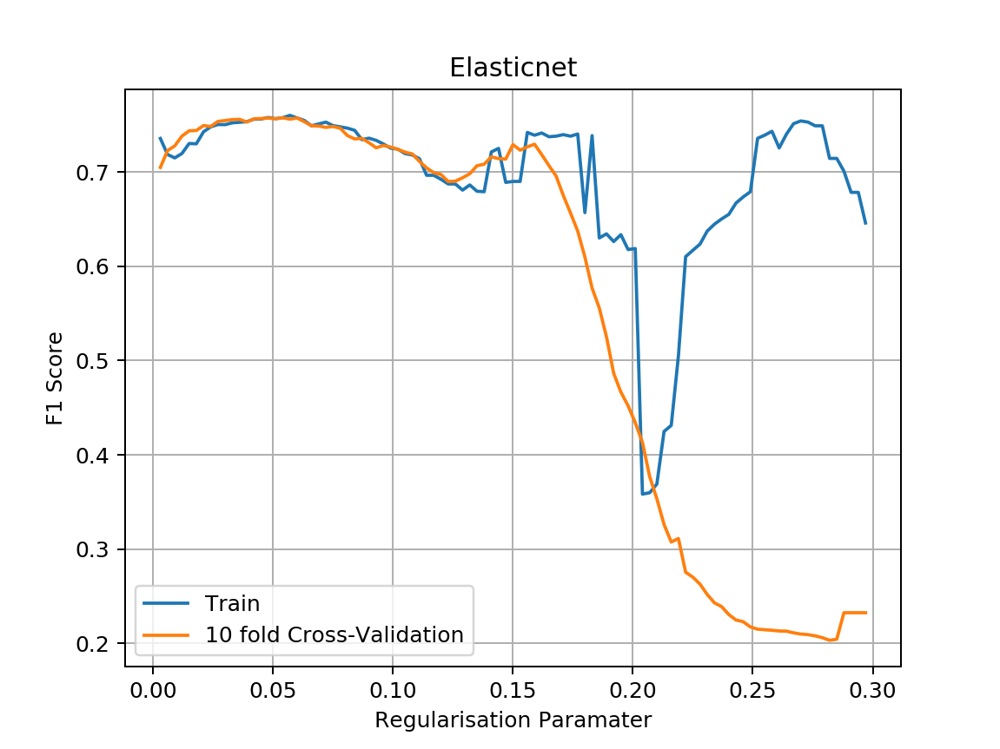

In [475]:
plt.figure()
plt.title("Elasticnet")
plt.plot(Cs_elas_2,train_elas_2,label="Train")
plt.plot(Cs_elas_2,val_elas_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()
plt.show()

In [476]:
index_elas_2=val_elas_2.index(np.max(val_elas_2))
C_elas_2=Cs_elas_2[index_elas_2]
print("Elastic alpha: ",C_elas_2)

Elastic alpha:  0.054000000000000006


In [477]:
loss="squared_loss"
train_sq_2=[]
val_sq_2=[]
Cs_sq_2=np.arange(0.001,.4,0.001)

for C in tqdm(Cs_sq_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(loss=loss,alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_sq_2.append(train_r)
    val_sq_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


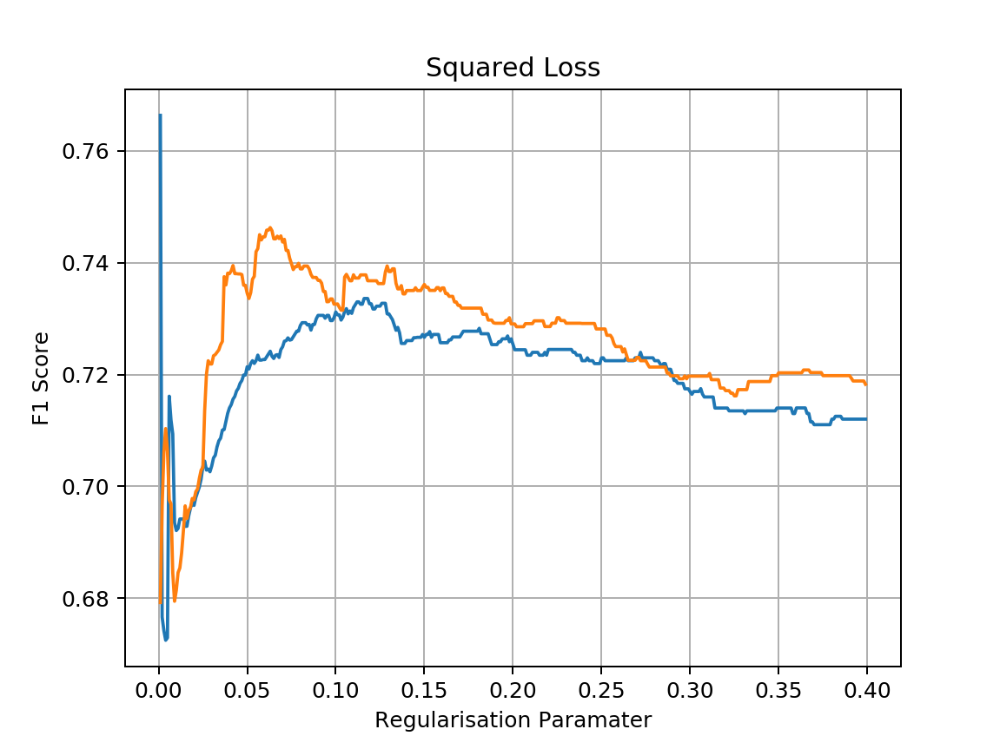

In [478]:
plt.figure()
plt.title("Squared Loss")
plt.plot(Cs_sq_2,train_sq_2,label="Train")
plt.plot(Cs_sq_2,val_sq_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [479]:
index_sq_2=val_sq_2.index(np.max(val_sq_2))
C_sq_2=Cs_sq_2[index_sq_2]
print("squared alpha : ",C_sq_2)

squared alpha :  0.063


In [480]:
train_norm_2=[]
val_norm_2=[]
Cs_norm_2=np.arange(0.001,0.1,0.001)
for C in tqdm(Cs_norm_2):
#     print("Regularisation: ",C)
    clf=SGDClassifier(alpha=C,class_weight="balanced",random_state=2).fit(X2,y2)
    train_r=get_f1_score2(clf,X2,y2)
#     print("Train f1: ",train_r)
    val_rs= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_r=val_rs.mean()
#     print("Val f1: ",val_r)
    train_norm_2.append(train_r)
    val_norm_2.append(val_r)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


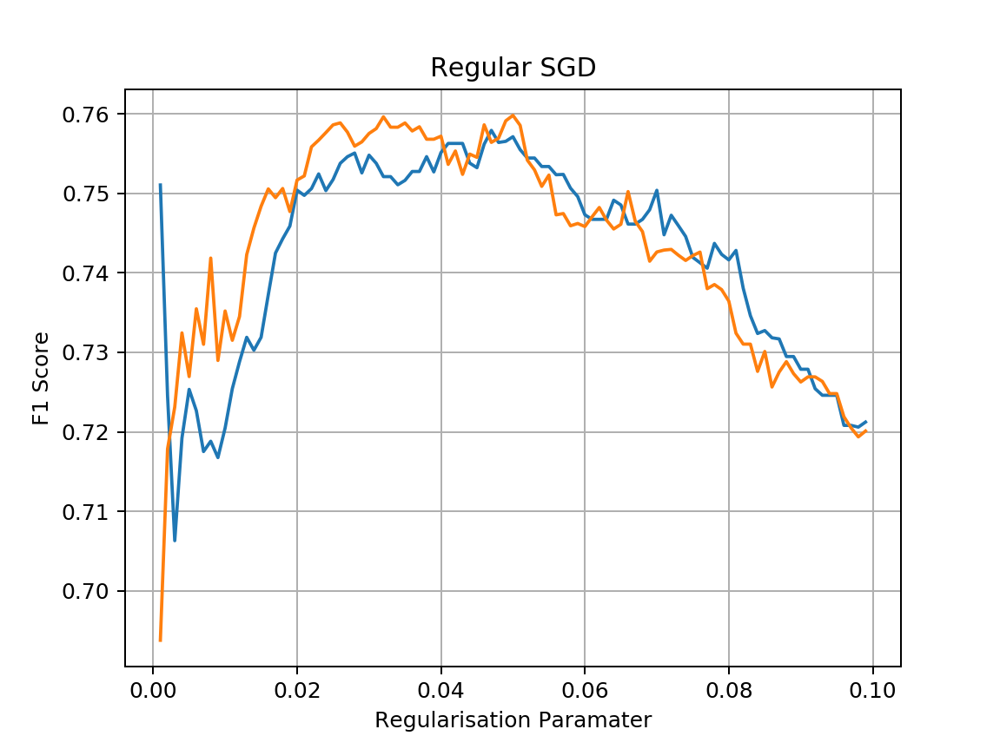

In [481]:
plt.figure()
plt.title("Regular SGD")
plt.plot(Cs_norm_2,train_norm_2,label="Train")
plt.plot(Cs_norm_2,val_norm_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.show()

In [482]:
index_norm_2=val_norm_2.index(np.max(val_norm_2))
C_norm_2=Cs_norm_2[index_norm_2]
print("Normal alpha: ",C_norm_2)

Normal alpha:  0.05


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


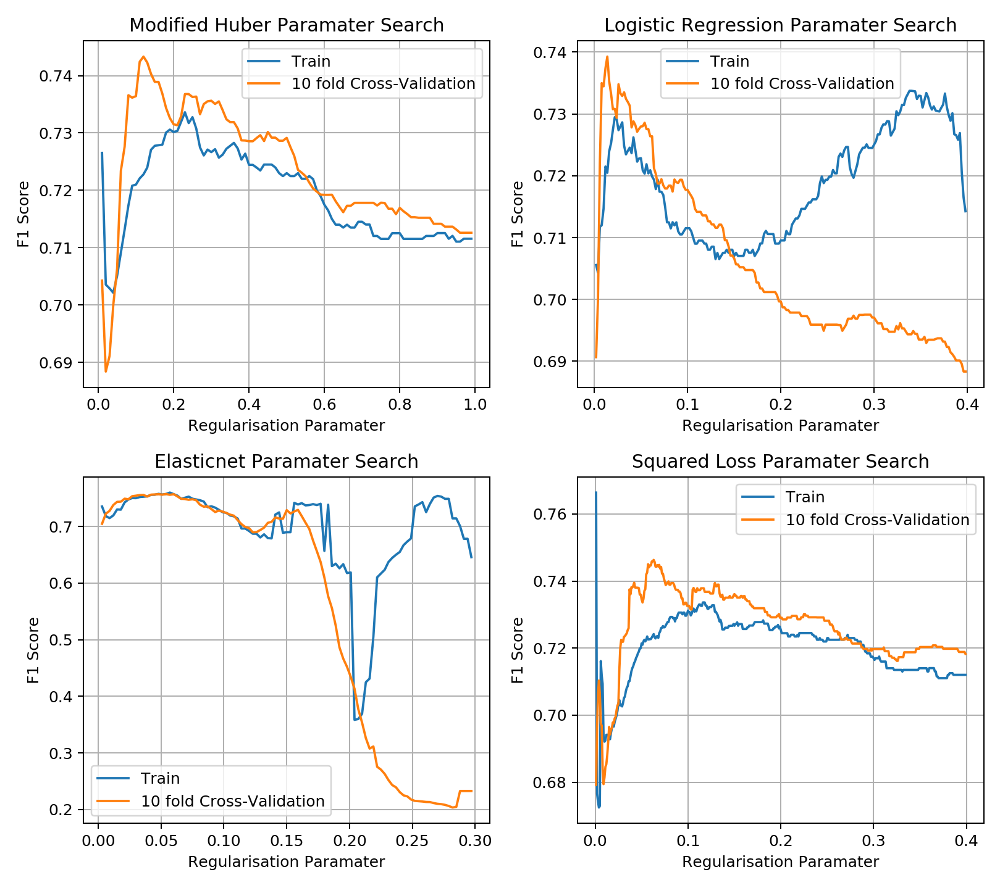

In [484]:
plt.figure(figsize=(9,8))



plt.subplot(2,2,1)
plt.title("Modified Huber Paramater Search")
plt.plot(Cs_huber_2,train_huber_2,label="Train")
plt.plot(Cs_huber_2,val_huber_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(2,2,2)
plt.title("Logistic Regression Paramater Search")
plt.plot(Cs_log_2,train_log_2,label="Train")
plt.plot(Cs_log_2,val_log_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(2,2,3)
plt.title("Elasticnet Paramater Search")
plt.plot(Cs_elas_2,train_elas_2,label="Train")
plt.plot(Cs_elas_2,val_elas_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.subplot(2,2,4)
plt.title("Squared Loss Paramater Search")
plt.plot(Cs_sq_2,train_sq_2,label="Train")
plt.plot(Cs_sq_2,val_sq_2,label="10 fold Cross-Validation")
plt.xlabel("Regularisation Paramater")
plt.ylabel("F1 Score")
plt.grid()
plt.legend()

plt.tight_layout()
plt.show()

In [298]:
clf=SGDClassifier(alpha=C_norm_2,class_weight="balanced",random_state=2).fit(X2,y2)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


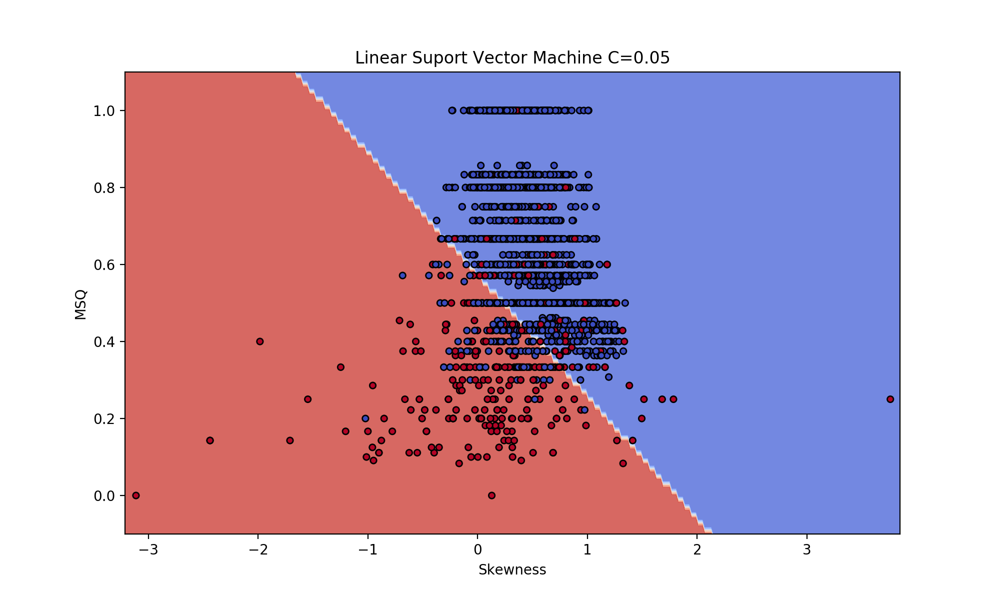

In [299]:
X0, X1 = X2["Skewness"].values, X2["MSQ"].values
fig, sub = plt.subplots(1, 1,figsize=(10,6))
ax = plt.gca()
xx, yy = make_meshgrid(X0, X1)
plot_contours(ax, clf, xx, yy,
              cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
ax.set_xlim(xx.min(), xx.max())
ax.set_ylim(yy.min(), yy.max())
ax.set_xlabel("Skewness")
ax.set_ylabel('MSQ')
ax.set_title("Linear Suport Vector Machine C={}".format(C_norm_2))
plt.show()

In [300]:
train_pred=clf.predict(X2)
train_f1=get_f1_score2(clf,X2,y2)

print("Train f1: ",train_f1)
train_pre=get_precision_score2(clf,X2,y2)

print("Train prec: ",train_pre)
train_rec=get_recall_score2(clf,X2,y2)

print("Train recall: ",train_rec)  

val_f1s= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
val_f1=val_f1s.mean()
stds_err_f1_svm_2=val_f1s.std()


val_pres= cross_val_score(clf, X2, y2,scoring=get_precision_score2, cv=10)
val_pre=val_pres.mean()
stds_err_prec_svm_2=val_pres.std()


val_recs= cross_val_score(clf, X2, y2,scoring=get_recall_score2, cv=10)
val_rec=val_recs.mean()
stds_err_rec_svm_2=val_recs.std()


print("Val f1: {} +- {}".format(val_f1,stds_err_f1_svm_2))
print("Val prec: {} +- {}".format(val_pre,stds_err_prec_svm_2))
print("Val rec: {} +- {}".format(val_rec,stds_err_rec_svm_2))
print("")

Train f1:  0.7571269047593334
Train prec:  0.7526419507492175
Train recall:  0.7619700089761867
Val f1: 0.7598094683759976 +- 0.04870154078990857
Val prec: 0.7552246969355689 +- 0.05147246342913591
Val rec: 0.7665762480922288 +- 0.0481128201239108



In [301]:
columns=["Train Precision","Train Recall","Train F1","Val Precision","Val Recall","Val F1"]
indices=["SVM linear","SGD Ridge","SGD Elasticnet","SGD Modified Huber","SGD Log","SGD Squared Loss","SGD Perceptron"]

Results_Table2=pd.DataFrame(columns=columns,index=indices)
Results_Table2.loc["SVM linear"]=[train_pre*100,train_rec*100,train_f1*100,val_pre*100,val_rec*100,val_f1*100]
Results_Table2
errors_prec2=[]
errors_rec2=[]
errors_f2=[]
errors_prec2.append(stds_err_prec_svm_2)
errors_rec2.append(stds_err_rec_svm_2)
errors_f2.append(stds_err_f1_svm_2)


In [302]:
models4 = [
    RidgeClassifier(random_state=2,class_weight="balanced").fit(X2,y2),
    SGDClassifier(penalty="elasticnet",class_weight="balanced",random_state=2,alpha=C_elas_2).fit(X2,y2),
    SGDClassifier(loss="modified_huber",random_state=2,class_weight="balanced",alpha=C_huber_2).fit(X2,y2),
    SGDClassifier(loss="log",random_state=2,class_weight="balanced",alpha=C_log_2).fit(X2,y2),
    SGDClassifier(loss="squared_loss",random_state=2,class_weight="balanced",alpha=C_sq_2).fit(X2,y2),
    Perceptron(random_state=2,class_weight="balanced").fit(X2,y2),
]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


<IPython.core.display.Javascript object>


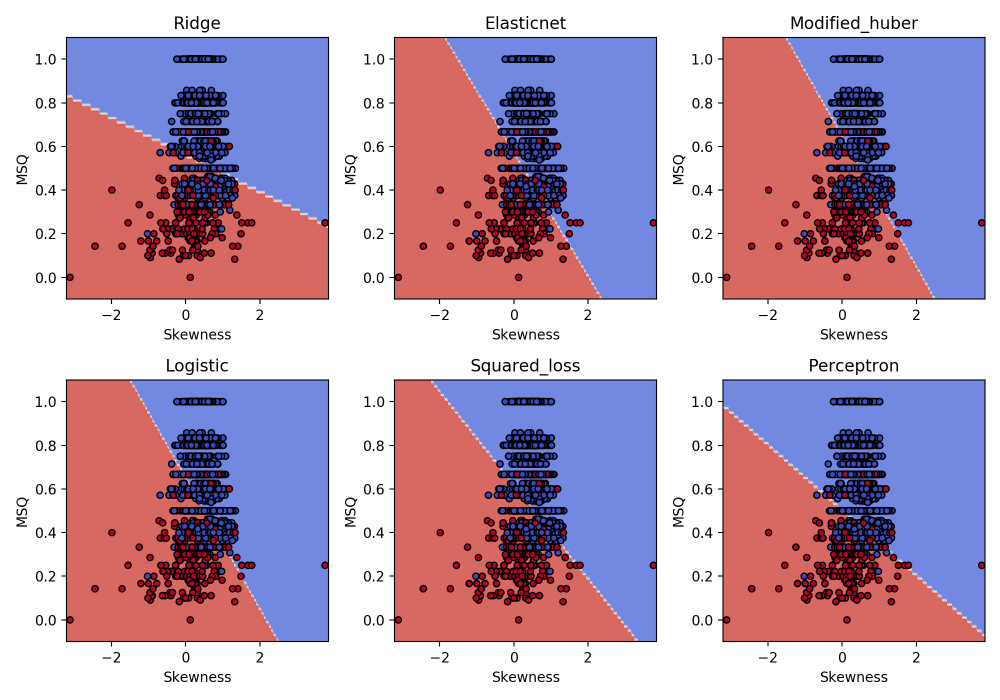

In [303]:
# title for the plots
titles3 = ('Ridge',
          'Elasticnet',
          'Modified_huber',
          'Logistic',
          'Squared_loss',
          'Perceptron',)

# Set-up 2x3 grid for plotting.
fig, sub = plt.subplots(2, 3,figsize=(10,7))
# plt.subplots_adjust(wspace=0.4, hspace=0.4)

X0, X1 = X["Skewness"].values, X["MSQ"].values
xx, yy = make_meshgrid(X0, X1)

# print("titles length: ",len(titles))
# print("models length: ",len(models))
# print("figures length: ",len(sub.flatten()))
colors = "bry"

for clf, title, ax in zip(models4, titles3, sub.flatten()):
    plot_contours(ax, clf, xx, yy,
                  cmap=plt.cm.coolwarm, alpha=0.8)
    ax.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
#     for i, color in zip(clf.classes_, colors):
#         plot_hyperplane(clf.coef_,clf.intercept_,i, color,ax)
    ax.set_xlabel('Skewness')
    ax.set_ylabel('MSQ')
    ax.set_title(title)
plt.tight_layout()
plt.show()

In [304]:
Training_F1s=[]
Training_Precisions=[]
Training_Recals=[]

Validation_F1s=[]
Validation_Precisions=[]
Validation_Recals=[]
stds_err_prec_sgd=[]
stds_err_rec_sgd=[]
stds_err_f1_sgd=[]
for clf,title in zip(models4,titles3):
    print(title)
    train_pred=clf.predict(X2)
    train_f1=get_f1_score2(clf,X2,y2)
    Training_F1s.append(train_f1)
    print("Train f1: ",train_f1)
    train_pre=get_precision_score2(clf,X2,y2)
    Training_Precisions.append(train_pre)
    print("Train prec: ",train_pre)
    train_rec=get_recall_score2(clf,X2,y2)
    Training_Recals.append(train_rec)
    print("Train recall: ",train_rec)  
    
    val_f1s= cross_val_score(clf, X2, y2,scoring=get_f1_score2, cv=10)
    val_f1=val_f1s.mean()
    val_f1_std=val_f1s.std()
    Validation_F1s.append(val_f1)
    stds_err_f1_sgd.append(val_f1_std)
    
    val_pres= cross_val_score(clf, X2, y2,scoring=get_precision_score2, cv=10)
    val_pre=val_pres.mean()
    val_pre_std=val_pres.std()
    Validation_Precisions.append(val_pre)
    stds_err_prec_sgd.append(val_pre_std)
    
    val_recs= cross_val_score(clf, X2, y2,scoring=get_recall_score2, cv=10)
    val_rec=val_recs.mean()
    val_rec_std=val_recs.std()
    Validation_Recals.append(val_rec)
    stds_err_rec_sgd.append(val_rec_std)
    
    print("Val f1: {} +- {}".format(val_f1,val_f1_std))
    print("Val prec: {} +- {}".format(val_pre,val_pre_std))
    print("Val rec: {} +- {}".format(val_rec,val_rec_std))
    print("")

Ridge
Train f1:  0.6884575292671193
Train prec:  0.7582025229653669
Train recall:  0.6762662078075572
Val f1: 0.6881680019466951 +- 0.0298420223617914
Val prec: 0.7593934770439741 +- 0.045003040852886145
Val rec: 0.6771222871943524 +- 0.02678761023524177

Elasticnet
Train f1:  0.7574960218109702
Train prec:  0.7551107701290678
Train recall:  0.7599798655628475
Val f1: 0.7574313932872252 +- 0.046610905936749415
Val prec: 0.7546892558340901 +- 0.04987442501195119
Val rec: 0.7615938669671272 +- 0.04528436544265623

Modified_huber
Train f1:  0.731724445456089
Train prec:  0.7677340837955828
Train recall:  0.7129068223047685
Val f1: 0.7367813519180569 +- 0.039769539847853204
Val prec: 0.7613141043825619 +- 0.03932655347246357
Val rec: 0.7219334719482106 +- 0.03836255975494284

Logistic
Train f1:  0.727375745526839
Train prec:  0.7673691500268185
Train recall:  0.7082303329940381
Val f1: 0.734806584182764 +- 0.04148775975896037
Val prec: 0.7600522621725467 +- 0.04034930469821833
Val rec: 0.7

/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Val f1: 0.6790121533990103 +- 0.18172074273519753
Val prec: 0.7009596157946942 +- 0.0818107205558588
Val rec: 0.7326998742994291 +- 0.23020391532202666



/usr/local/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [305]:
for t_prec,t_recal,t_f1,v_prec,v_recal,v_f1,title in zip(Training_Precisions,Training_Recals,Training_F1s,Validation_Precisions,Validation_Recals,Validation_F1s,indices[1:]):
    Results_Table2.loc[title]=[t_prec*100,t_recal*100,t_f1*100,v_prec*100,v_recal*100,v_f1*100]

In [306]:
Results_Table2

,Train Precision,Train Recall,Train F1,Val Precision,Val Recall,Val F1
SVM linear,75.2642,76.197,75.7127,75.5225,76.6576,75.9809
SGD Ridge,75.8203,67.6266,68.8458,75.9393,67.7122,68.8168
SGD Elasticnet,75.5111,75.998,75.7496,75.4689,76.1594,75.7431
SGD Modified Huber,76.7734,71.2907,73.1724,76.1314,72.1933,73.6781
SGD Log,76.7369,70.823,72.7376,76.0052,71.9889,73.4807
SGD Squared Loss,77.5444,70.4543,72.4175,77.6959,72.9078,74.6298
SGD Perceptron,76.7025,78.5793,77.5763,70.096,73.27,67.9012


In [307]:
for prec,rec,f1 in zip(stds_err_prec_sgd,stds_err_rec_sgd,stds_err_f1_sgd):
    errors_prec2.append(prec)
    errors_rec2.append(rec)
    errors_f2.append(f1)

In [308]:
Errors_prec=[]
Errors_rec=[]
Errors_f1=[]
for e_prec,e_rec,e_f1 in zip(errors_prec2,errors_rec2,errors_f2):
    Errors_prec.append(e_prec*100)
    Errors_rec.append(e_rec*100)
    Errors_f1.append(e_f1*100)

In [313]:
Results_Table2

,Train Precision,Train Recall,Train F1,Val Precision,Val Recall,Val F1
SVM linear,75.2642,76.197,75.7127,75.5225,76.6576,75.9809
SGD Ridge,75.8203,67.6266,68.8458,75.9393,67.7122,68.8168
SGD Elasticnet,75.5111,75.998,75.7496,75.4689,76.1594,75.7431
SGD Modified Huber,76.7734,71.2907,73.1724,76.1314,72.1933,73.6781
SGD Log,76.7369,70.823,72.7376,76.0052,71.9889,73.4807
SGD Squared Loss,77.5444,70.4543,72.4175,77.6959,72.9078,74.6298
SGD Perceptron,76.7025,78.5793,77.5763,70.096,73.27,67.9012


In [315]:
# indices=["SVC Linear","SVC RBF","SGD Elastic","SGD Mod Huber","SGD Logistic","SGD Squared","SGD Percep","Decision Tree"]
# columns=["Training Precision","Training Recall","Training F1-Score","Validation Precision","Validation Recall","Validation F1-Score"]
All_Errors=[Errors_prec,Errors_rec,Errors_f1]
Results_Table_std_2=pd.DataFrame(columns=Results_Table2.columns,index=Results_Table2.index)
for c in Results_Table2.columns[:3]:
    for i in Results_Table2.index:
        Results_Table_std_2[c][i]="{0:2.2f}".format(Results_Table2[c][i])
for c,Errors in zip(Results_Table2.columns[3:],All_Errors):
    for i,Error in zip(Results_Table2.index,Errors):
        Results_Table_std_2[c][i]="{0:2.2f} $\pm$ {1:2.2f}".format(Results_Table2[c][i],Error)
        

In [317]:
Results_Table_std_2.to_csv("Results_Table_2.csv")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


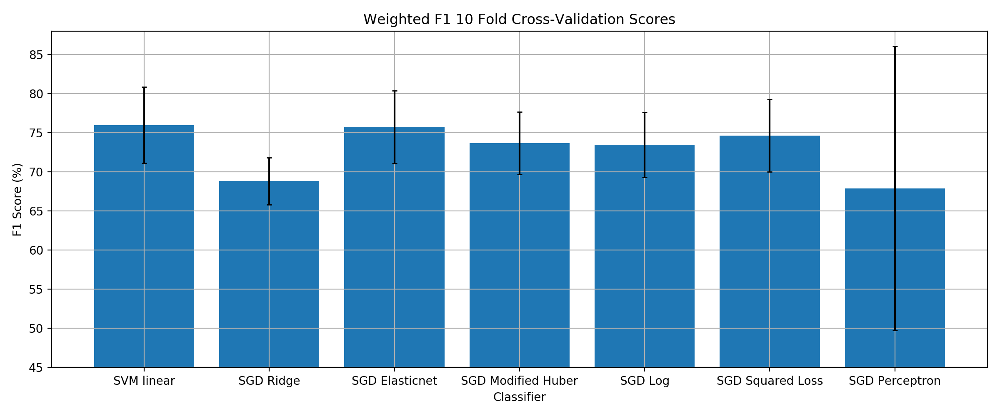

In [328]:
plt.figure(figsize=(12,5))
plt.title("Weighted F1 10 Fold Cross-Validation Scores")
plt.bar(indices,Results_Table2["Val F1"].values,yerr=Errors_f1,capsize=2)
plt.grid()
plt.xlabel("Classifier")
plt.ylabel("F1 Score (%)")
plt.ylim([45,88])
plt.tight_layout()
plt.show()

In [330]:
C_norm_2=0.05
C_sq_2=0.063
chosen_clf_2=SGDClassifier(loss="squared_loss",alpha=C_sq_2,class_weight="balanced",random_state=2).fit(X2,y2)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


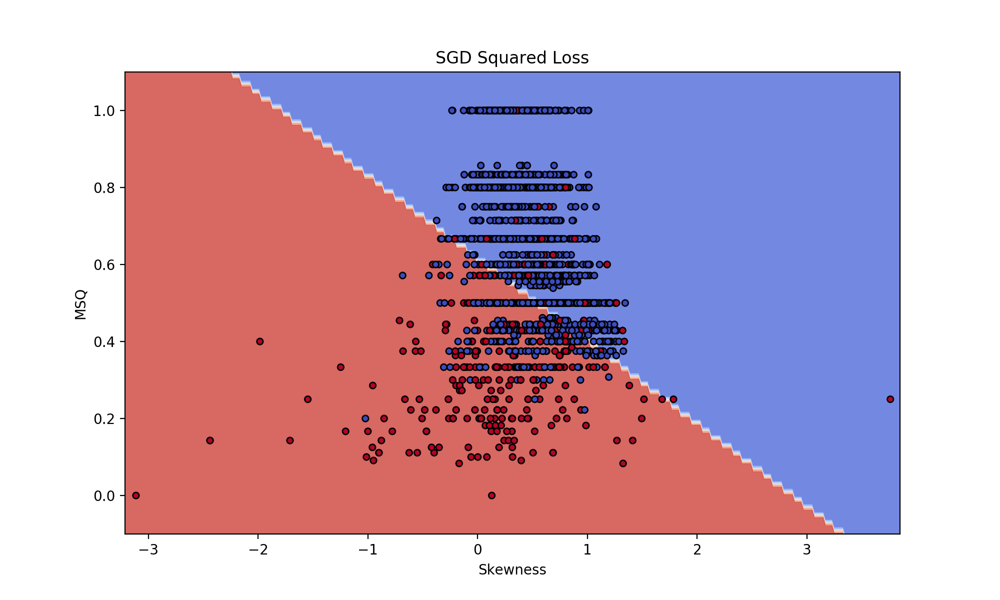

In [336]:
X0, X1 = X2["Skewness"].values, X2["MSQ"].values
fig, sub = plt.subplots(1, 1,figsize=(10,6))
ax = plt.gca()
xx, yy = make_meshgrid(X0, X1)
plot_contours(ax, chosen_clf_2, xx, yy,
              cmap=plt.cm.coolwarm, alpha=0.8)
plt.scatter(X0, X1, c=y2, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
ax.set_xlim(xx.min(), xx.max())
ax.set_ylim(yy.min(), yy.max())
ax.set_xlabel("Skewness")
ax.set_ylabel('MSQ')
ax.set_title("SGD Squared Loss")
plt.show()

In [333]:
train_pred=chosen_clf_2.predict(X2)
train_f1=get_f1_score2(chosen_clf_2,X2,y2)

print("Train f1: ",train_f1)
train_pre=get_precision_score2(chosen_clf_2,X2,y2)

print("Train prec: ",train_pre)
train_rec=get_recall_score2(chosen_clf_2,X2,y2)

print("Train recall: ",train_rec)  

val_f1s= cross_val_score(chosen_clf_2, X2, y2,scoring=get_f1_score2, cv=10)
val_f1=val_f1s.mean()
stds_err_f1_2=val_f1s.std()


val_pres= cross_val_score(chosen_clf_2, X2, y2,scoring=get_precision_score2, cv=10)
val_pre=val_pres.mean()
stds_err_prec_2=val_pres.std()


val_recs= cross_val_score(chosen_clf_2, X2, y2,scoring=get_recall_score2, cv=10)
val_rec=val_recs.mean()
stds_err_rec_2=val_recs.std()


print("Val f1: {} +- {}".format(val_f1,stds_err_f1_2))
print("Val prec: {} +- {}".format(val_pre,stds_err_prec_2))
print("Val rec: {} +- {}".format(val_rec,stds_err_rec_2))
print("")

Train f1:  0.7241754814332945
Train prec:  0.7754435218315262
Train recall:  0.7045429336344982
Val f1: 0.7462982447246475 +- 0.046219502329059796
Val prec: 0.7769593176196321 +- 0.04762572607617466
Val rec: 0.729077912137674 +- 0.04366245112581116



In [166]:

def predict_sample_2(sample,coefficients,intercepts):
    Score1=coefficients[0][0]*sample[0]+coefficients[0][1]*sample[1]+intercepts[0]
    Scores=[0,Score1]
    return Scores.index(np.max(Scores))

def predict_set_2(X2,coefficients,intercepts):
    predictions=[]
    for index in X2.index:
        predictions.append(predict_sample_2(X2.loc[index].values,coefficients,intercepts))
    return predictions

In [334]:
coefficients_2=chosen_clf_2.coef_
intercepts_2=chosen_clf_2.intercept_
train_pred=chosen_clf_2.predict(X2)
train_est=predict_set_2(X2,coefficients_2,intercepts_2)

In [335]:
print(coefficients_2)
print(intercepts_2)

[[-0.23720892 -1.10489991]]
[0.68119408]


In [172]:
test_pred=chosen_clf_2.predict(Xtest2)
train_pred=chosen_clf_2.predict(X2)
print(classification_report(train_pred,y2,target_names=["AB","C"]))
print(classification_report(test_pred,ytest2,target_names=["AB","C"]))

report2=classification_report(test_pred,ytest2,target_names=["AB","C"],output_dict=True)
Report2=pd.DataFrame.from_dict(report2)
Report2=Report2.apply(percentage)
Report2=Report2.T
Report2.to_csv("Test_Report_2.csv",float_format="%.2f")

              precision    recall  f1-score   support

          AB       0.91      0.91      0.91      1605
           C       0.59      0.62      0.60       354

    accuracy                           0.85      1959
   macro avg       0.75      0.76      0.76      1959
weighted avg       0.86      0.85      0.85      1959

              precision    recall  f1-score   support

          AB       0.91      0.89      0.90      1061
           C       0.58      0.62      0.60       246

    accuracy                           0.84      1307
   macro avg       0.74      0.76      0.75      1307
weighted avg       0.85      0.84      0.85      1307



In [ ]:
plt.figure()
ax=plt.subplot()
class_names=["AB","C"]
# cm=confusion_matrix(y_test,test_est)


disp=plot_confusion_matrix(chosen_clf_2, Xtest2, ytest2,
                                 display_labels=class_names,
                                 cmap=plt.cm.Blues,ax=ax)

plt.title("Confusion matrix for two class classifier")

plt.show()

# Timing Tests:

In [176]:
lowcut=0.5
highcut=30
fs=125
b , a = butter_bandpass(lowcut, highcut, fs, order=4)

def classify_from_raw3(raw_sig,b,a,coefficients,intercepts):
    detrend_sig=detrend(filt_pipeline(raw_sig,b,a,period=375))
    tmp_sk = analysis.skew1(detrend_sig)
    tmp_msq = get_msq(detrend_sig)
    tmp_class=predict_sample([tmp_sk,tmp_msq],coefficients,intercepts)
    return tmp_class

def classify_from_raw2(raw_sig,b,a,coefficients,intercepts):
    detrend_sig=detrend(filt_pipeline(raw_sig,b,a,period=375))
    tmp_sk = analysis.skew1(detrend_sig)
    tmp_msq = get_msq(detrend_sig)
    tmp_class=predict_sample_2([tmp_sk,tmp_msq],coefficients,intercepts)
    return tmp_class




In [110]:
Vietnam_Raw_Data.columns=["Vietnam_{}".format(i) for i in range(len(Vietnam_Raw_Data.columns))]
MIMIC_Raw_Data.columns=["MIMIC_{}".format(i) for i in range(len(MIMIC_Raw_Data.columns))]

In [155]:
rand_MIMIC_List=random.sample(list(MIMIC_Raw_Data.columns),10)
rand_Vietnam_List=random.sample(list(Vietnam_Raw_Data.columns),10)
rand_Omar_List=random.sample(list(Omar_Raw_Data.columns),10)
rand_Stefan_List=random.sample(list(Stefan_Raw_Data.columns),10)
print("MIMIC: ",rand_MIMIC_List)
print("Vietnam: ",rand_Vietnam_List)
print("Omar: ",rand_Omar_List)
print("Stefan: ",rand_Stefan_List)
All_Lists=[rand_MIMIC_List,rand_Vietnam_List,rand_Omar_List,rand_Stefan_List]
All_Data=[MIMIC_Raw_Data,Vietnam_Raw_Data,Omar_Raw_Data,Stefan_Raw_Data]

MIMIC:  ['MIMIC_2388', 'MIMIC_2104', 'MIMIC_430', 'MIMIC_2237', 'MIMIC_1672', 'MIMIC_1376', 'MIMIC_1429', 'MIMIC_1495', 'MIMIC_2346', 'MIMIC_2355']
Vietnam:  ['Vietnam_126', 'Vietnam_33', 'Vietnam_57', 'Vietnam_70', 'Vietnam_58', 'Vietnam_43', 'Vietnam_91', 'Vietnam_36', 'Vietnam_120', 'Vietnam_81']
Omar:  ['Omar_15', 'Omar_207', 'Omar_103', 'Omar_29', 'Omar_291', 'Omar_163', 'Omar_124', 'Omar_129', 'Omar_290', 'Omar_222']
Stefan:  ['Stefan_Wrist LED 2_2', 'Stefan_57', 'Stefan_43', 'Stefan_37', 'Stefan_Wrist LED 3_14', 'Stefan_Wrist LED 2_0', 'Stefan_26', 'Stefan_30', 'Stefan_Finger LED 2_0', 'Stefan_45']


In [181]:
lowcut=0.5
highcut=30
coefficients=chosen_clf.coef_
intercepts=chosen_clf.intercept_
test_time=[]
test_dev=[]
with tqdm(total=40) as pbar:
    for List,Raw_Data in zip(All_Lists,All_Data):
        fs=Raw_Data[List[0]].shape[0]/3
        b , a = butter_bandpass(lowcut, highcut, fs, order=4)
        for sample in List:
            t=%timeit -o -q -p 5 -r 20 classify_from_raw3(Raw_Data[sample].values,b,a,coefficients,intercepts)
            test_time.append(t.average)
            test_dev.append(t.stdev**2)
            pbar.update(1)

In [182]:
lowcut=0.5
highcut=30
coefficients=chosen_clf_2.coef_
intercepts=chosen_clf_2.intercept_
test_time2=[]
test_dev2=[]
with tqdm(total=40) as pbar:
    for List,Raw_Data in zip(All_Lists,All_Data):
        fs=Raw_Data[List[0]].shape[0]/3
        b , a = butter_bandpass(lowcut, highcut, fs, order=4)
        for sample in List:
            t=%timeit -o -q -p 5 -r 20 classify_from_raw2(Raw_Data[sample].values,b,a,coefficients,intercepts)
            test_time2.append(t.average)
            test_dev2.append(t.stdev**2)
            pbar.update(1)

<IPython.core.display.Javascript object>


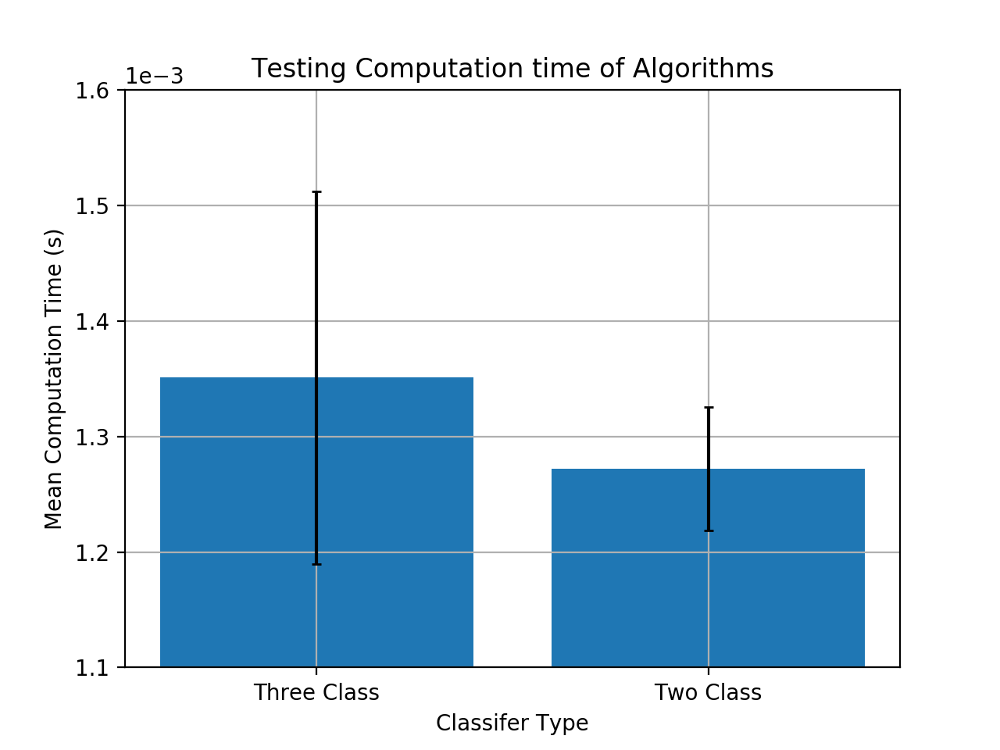

(0.0011, 0.0016)

In [188]:
Time1=np.mean(test_time)
Dev1=np.sqrt(np.mean(test_dev))
Time2=np.mean(test_time2)
Dev2=np.sqrt(np.mean(test_dev2))
plt.figure()
plt.ticklabel_format(axis="y", style="sci",scilimits=(-3,-3))
plt.bar(["Three Class","Two Class"],[Time1,Time2],yerr=[Dev1,Dev2],capsize=2)
plt.xlabel("Classifer Type")
plt.ylabel("Mean Computation Time (s)")
plt.title("Testing Computation time of Algorithms")
plt.grid()
plt.ylim([0.0011,0.0016])